<a href="https://colab.research.google.com/github/AhmedGaber98/AhmedGaber43-4881/blob/main/Clustering_Project_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GUC Clustering Project 

In [ ]:
pip install fsspec

     |████████████████████████████████| 134 kB 20.0 MB/s 


**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [ ]:
# if plotnine is not installed in Jupter then use the following command to install it 
!conda install -c conda-forge --yes plotnine
#!conda update -n base -c defaults conda

/bin/bash: conda: command not found


Running this project require the following imports 

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
import scipy.cluster.hierarchy as sch

from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram,linkage
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

%matplotlib inline

In [ ]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



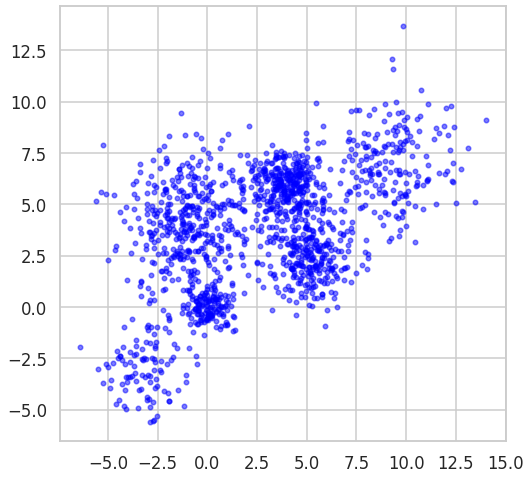

In [ ]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)


### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

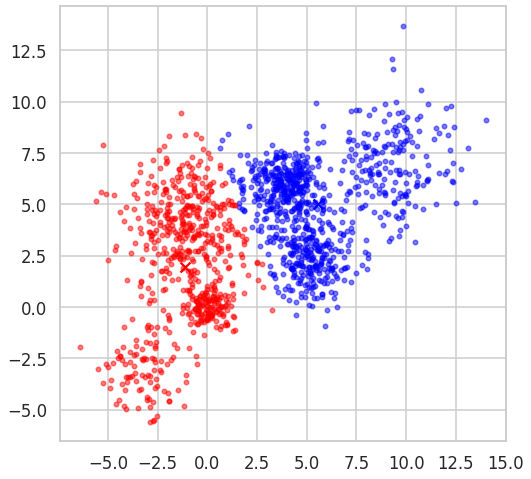

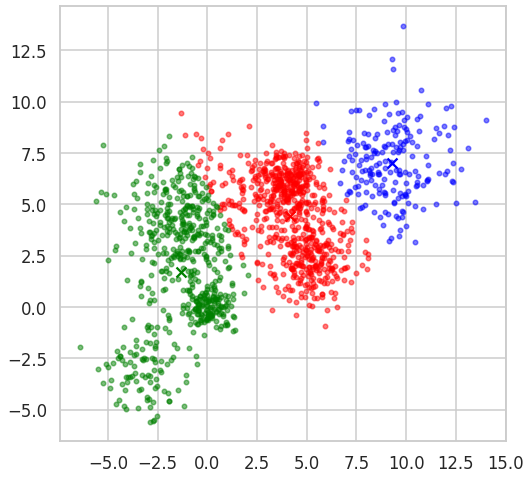

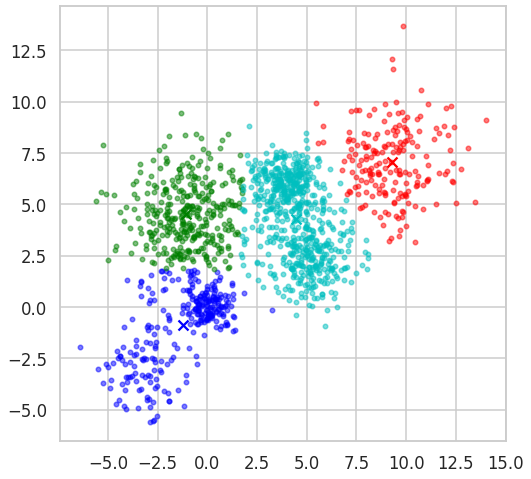

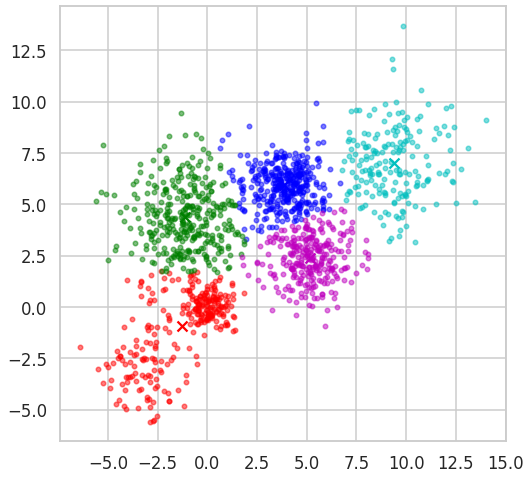

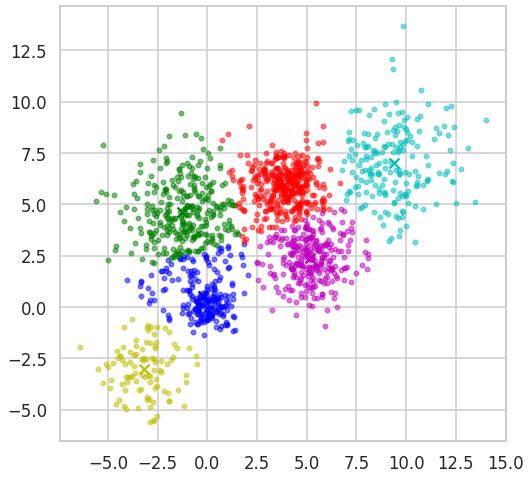

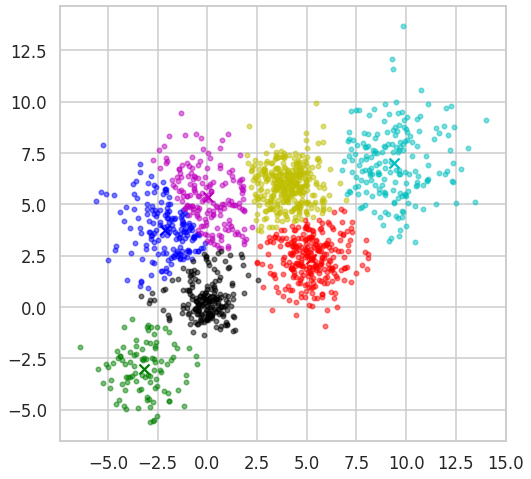

In [ ]:
#displaying the outcome
for i in range (2,8):
 kmeans = KMeans(i)
 kmeans.fit(Multi_blob_Data.copy())
 display_cluster(Multi_blob_Data,kmeans,num_clusters=i)  
 plt.show()

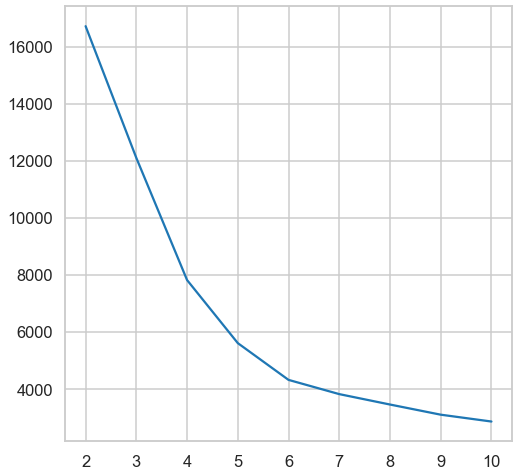

In [ ]:

#plotting distortion function
distortions = []
for i in range (2,11):
 kmeans = KMeans(i)
 kmeans.fit(Multi_blob_Data.copy())
 distortion_i = kmeans.inertia_
 distortions.append(distortion_i)
values_k = range (2,11)
plt.plot(values_k,distortions)
plt.show()  

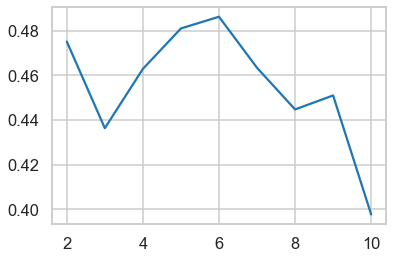

In [ ]:
#Ploting the silhouette_score
scores=[]
for i in range (2,11):
 kmeans = KMeans(i)
 kmeans.fit(Multi_blob_Data.copy())
 clusters =   kmeans.fit_predict(Multi_blob_Data) 
 scores.append(silhouette_score(Multi_blob_Data, clusters , metric='euclidean'))
values_k = range (2,11)
plt.plot(values_k,scores)
plt.show()  

In [ ]:
#The best k is equal to 6 from elbow method and silhouette_score
kmeans = KMeans(6)
kmeans.fit(Multi_blob_Data.copy())
scores_best_k_kmeans = (silhouette_score(Multi_blob_Data, kmeans.labels_, metric='euclidean'))
scores_best_k_kmeans

0.4859737366910219

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

In [ ]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

In [ ]:
all_scores=[]

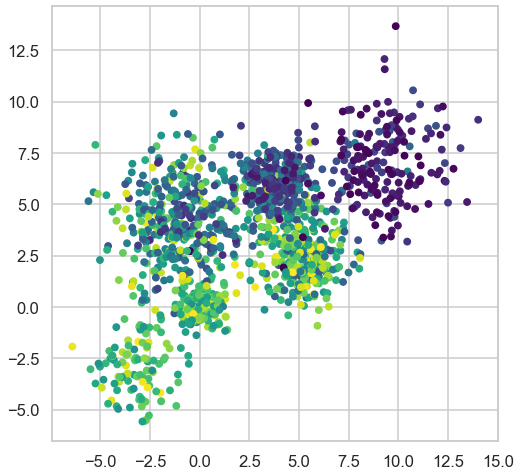

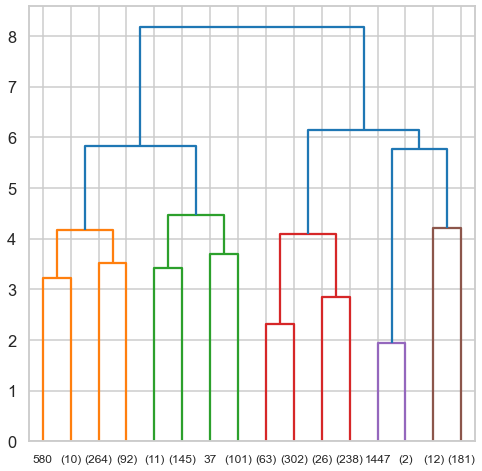

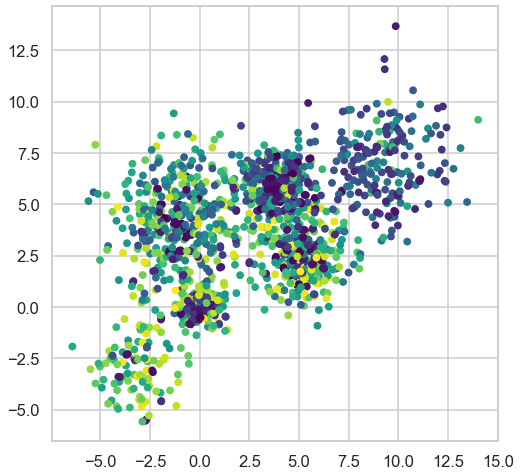

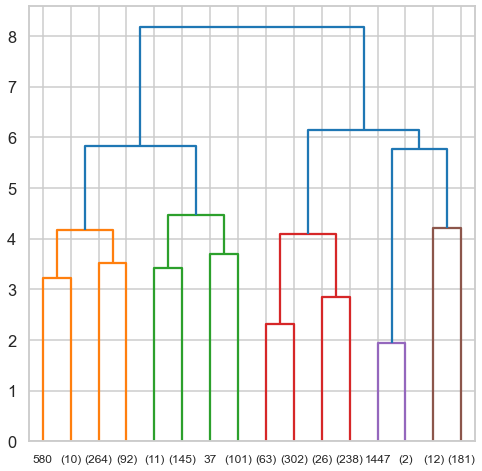

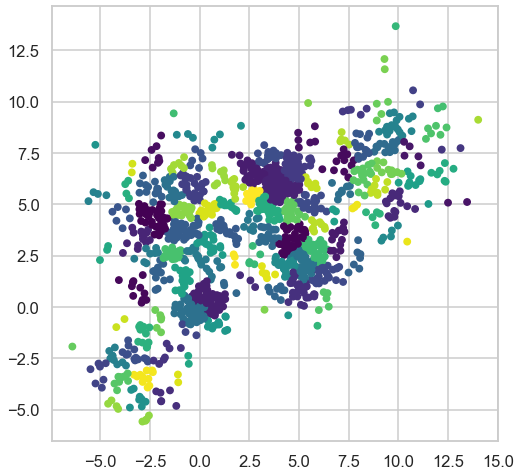

...

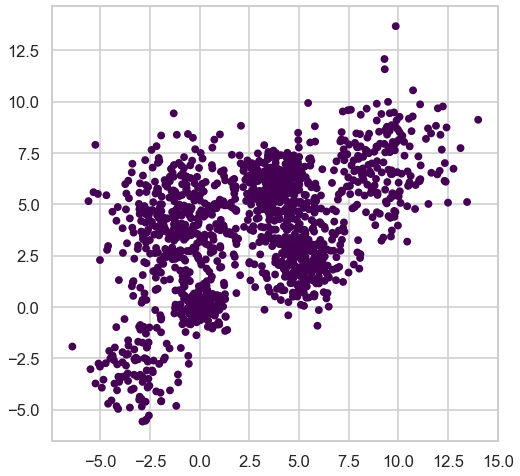

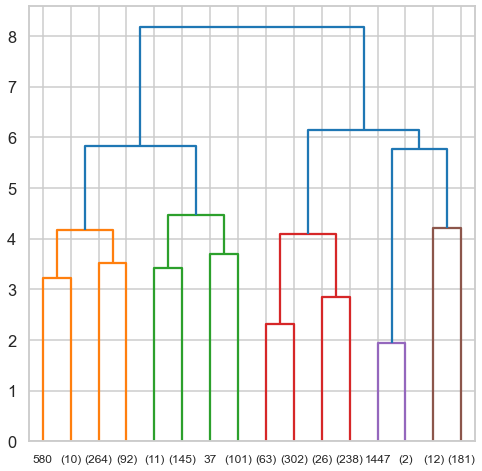

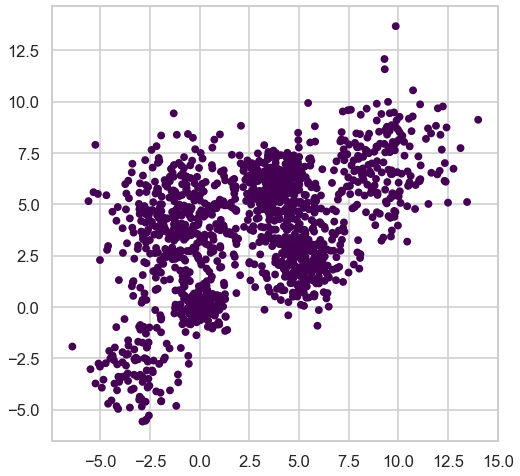

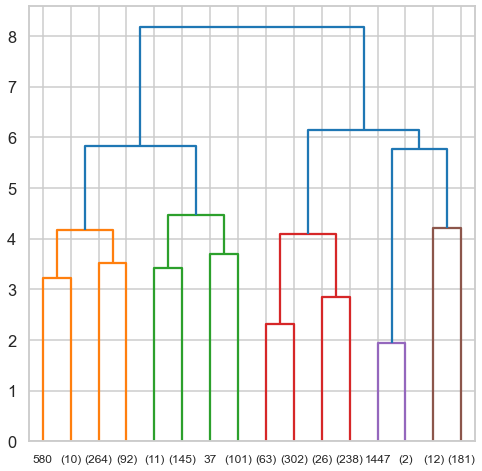

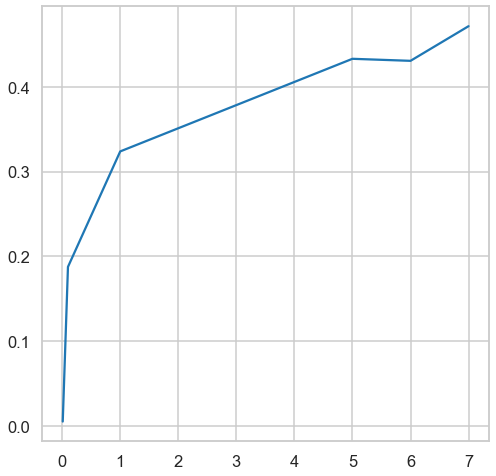

[0.4716908069861964]

In [ ]:
distances=[0.01,0.1,1,5,6,7,9,10]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(Multi_blob_Data.copy())
  plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(Multi_blob_Data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

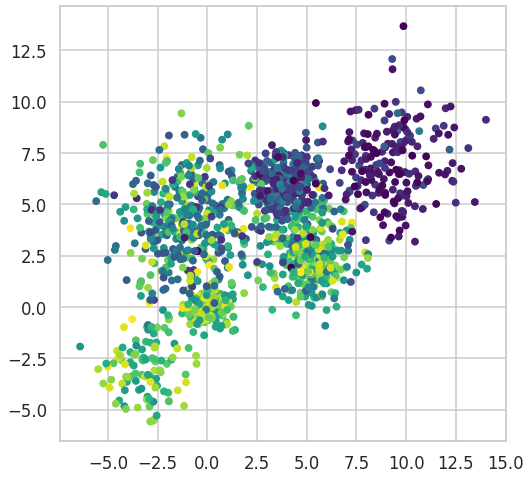

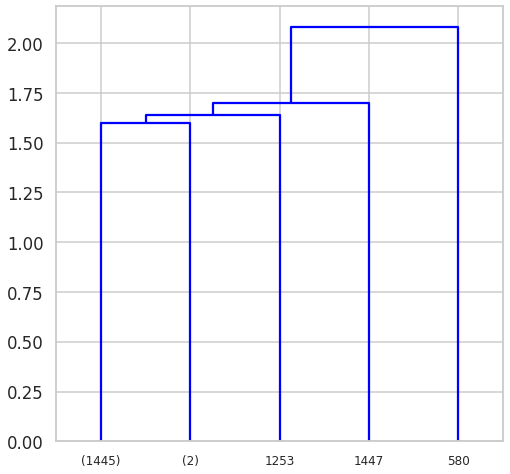

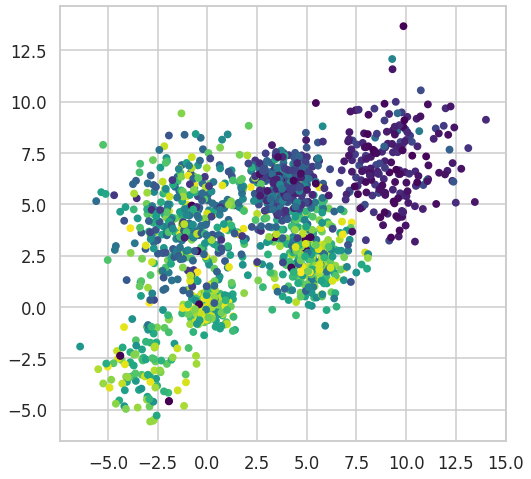

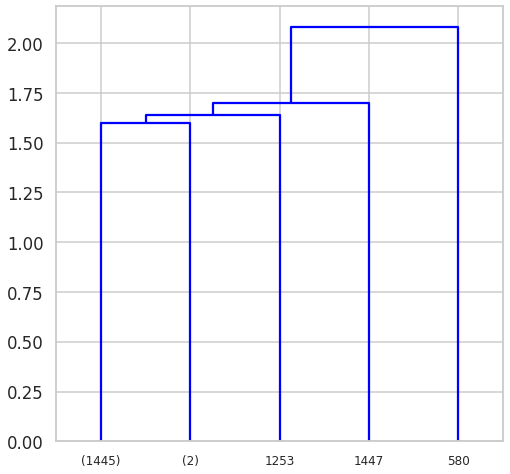

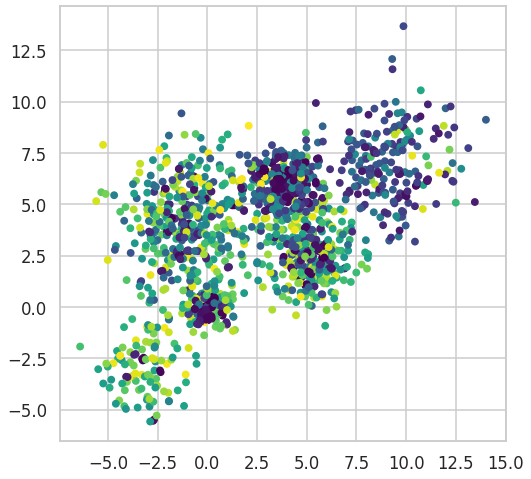

...

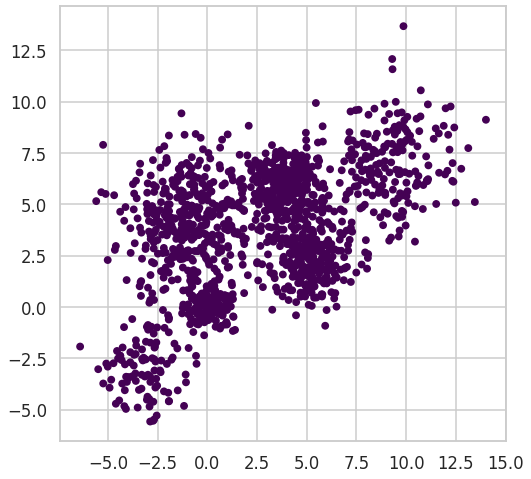

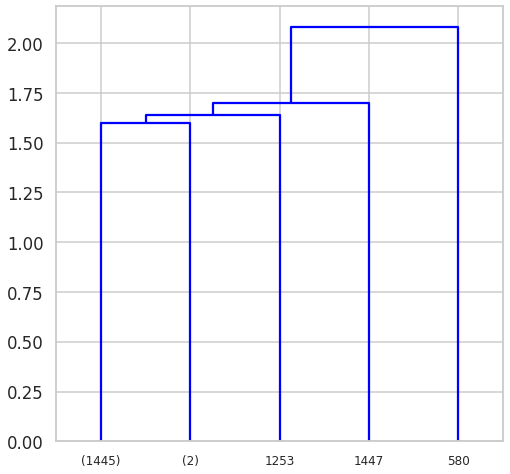

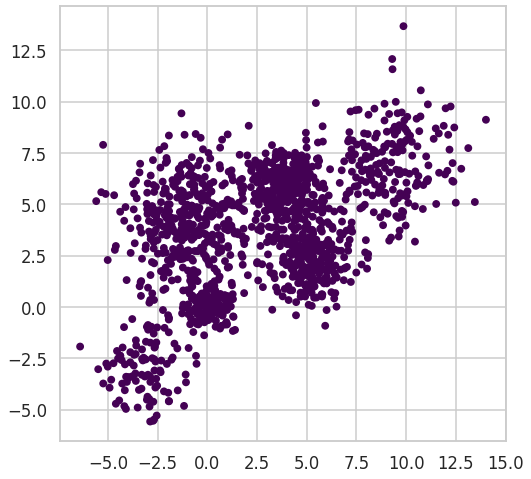

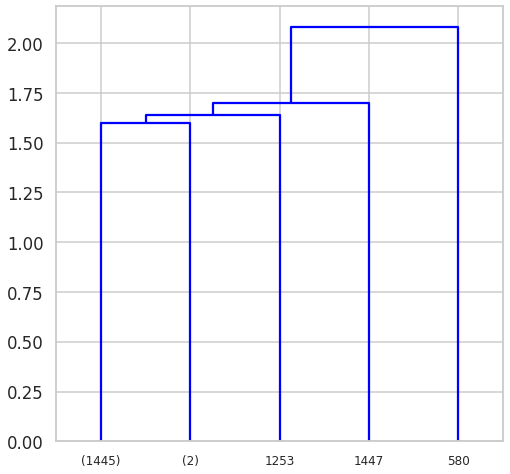

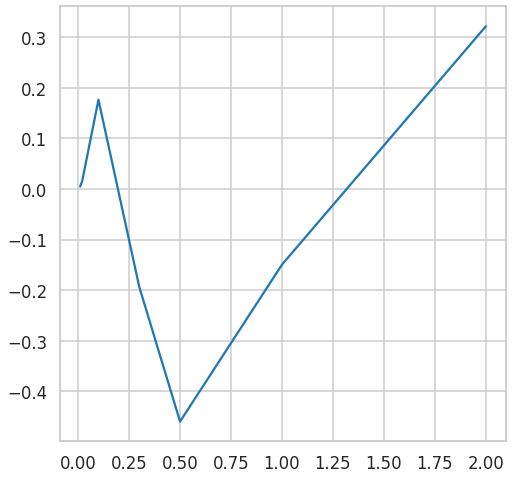

[0.4716908069861964, 0.3218066204847175]

In [ ]:
distances=[0.01,0.02,0.1,0.3,0.5,1,2,3,5,6]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(Multi_blob_Data.copy())
  plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(Multi_blob_Data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

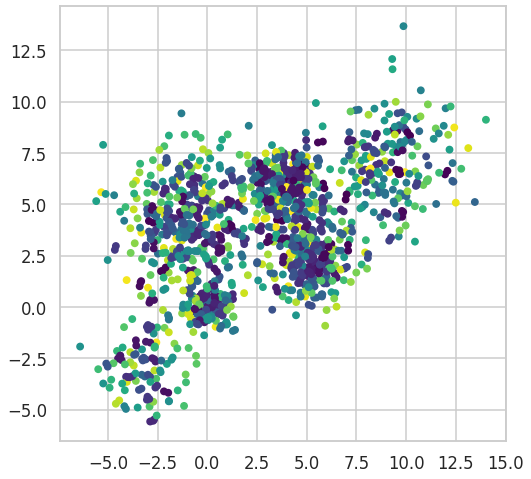

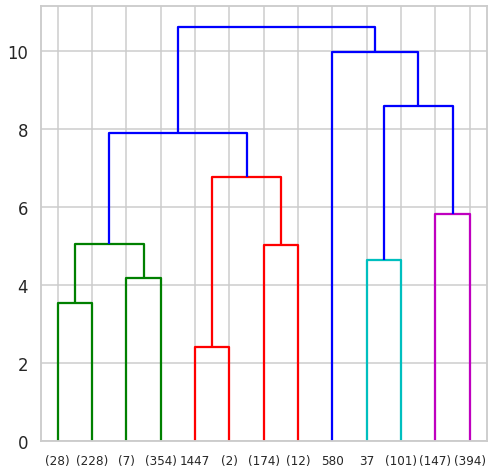

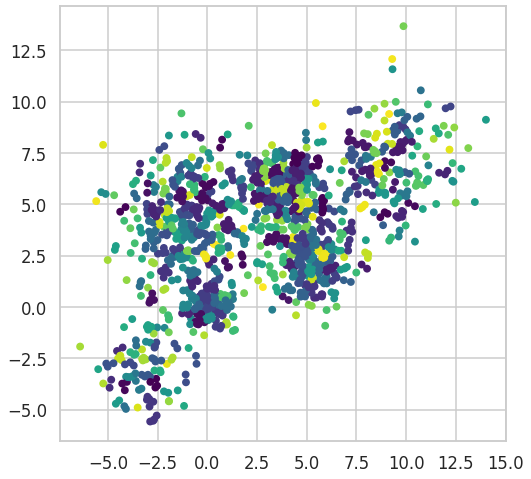

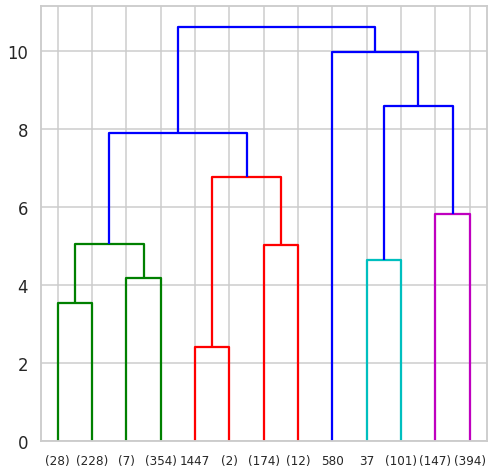

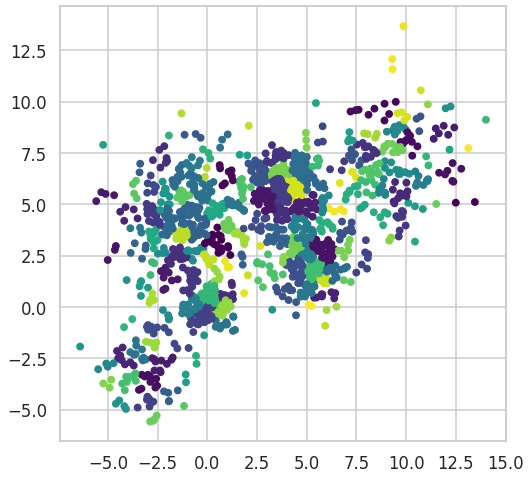

...

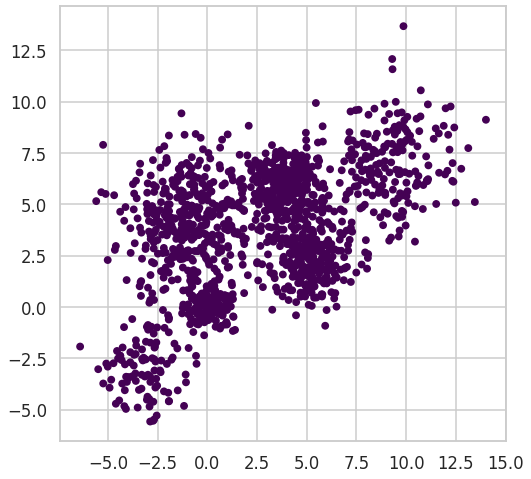

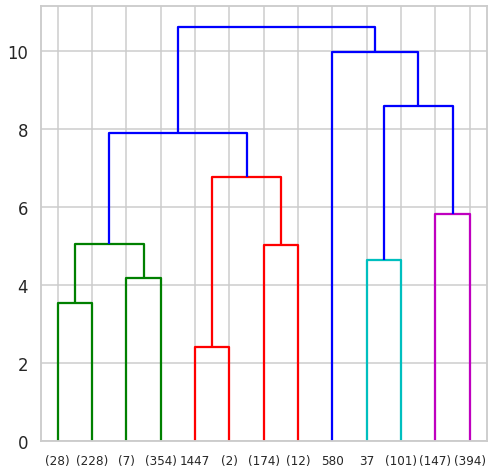

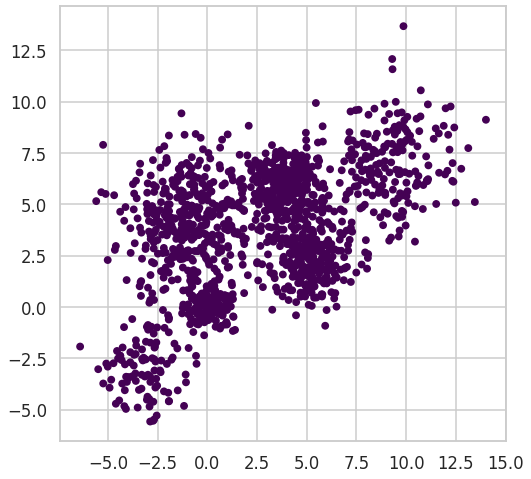

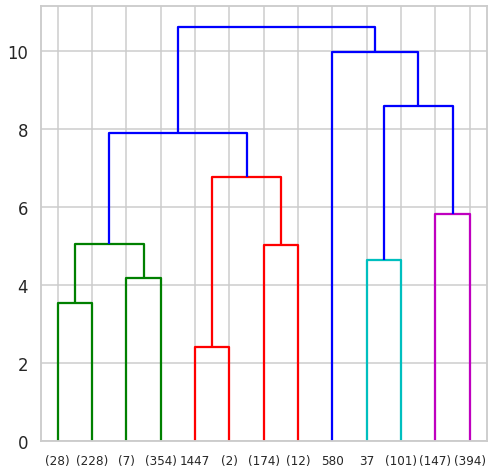

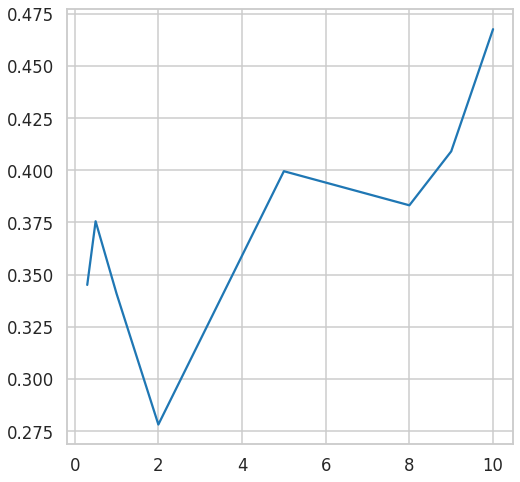

[0.4716908069861964, 0.3218066204847175, 0.46762361386512785]

In [ ]:
distances=[0.3,0.5,1,2,5,8,9,10,11,12,13]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='manhattan', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(Multi_blob_Data.copy())
  plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(Multi_blob_Data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

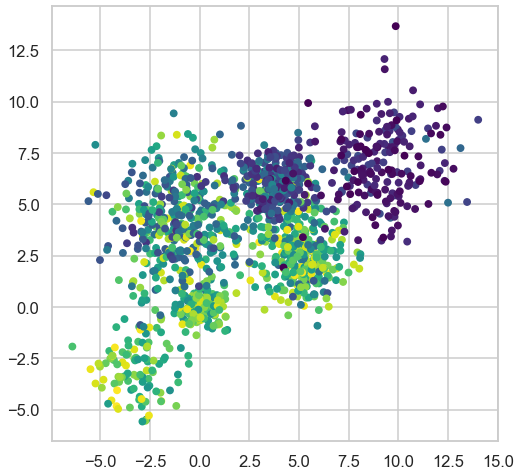

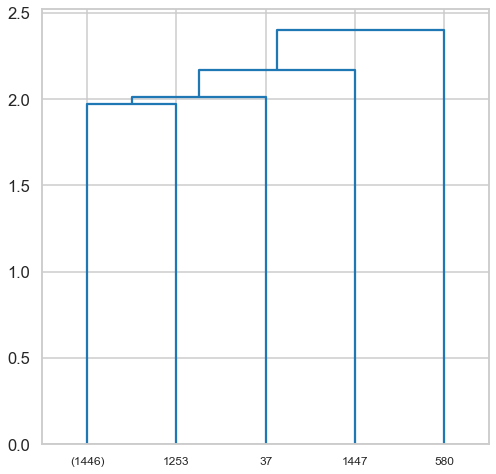

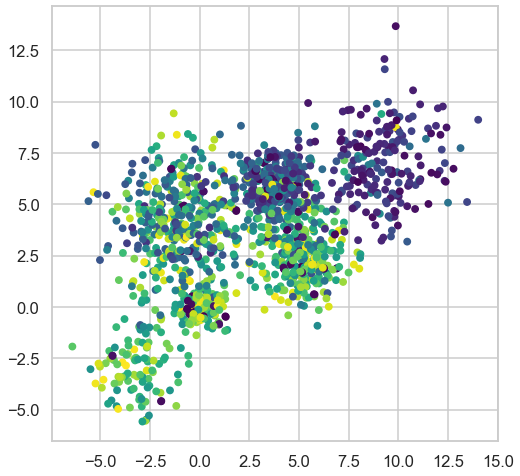

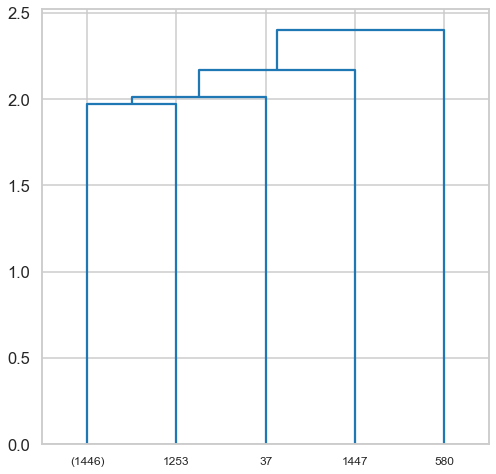

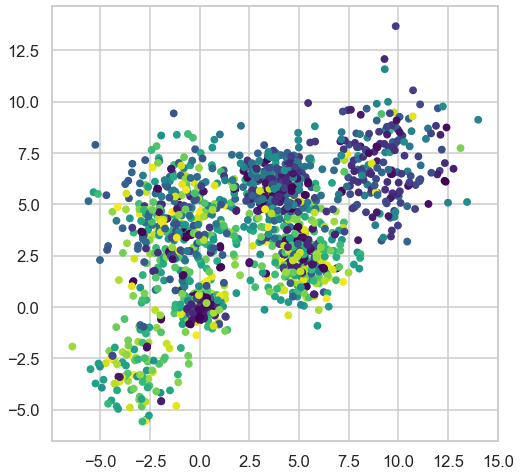

...

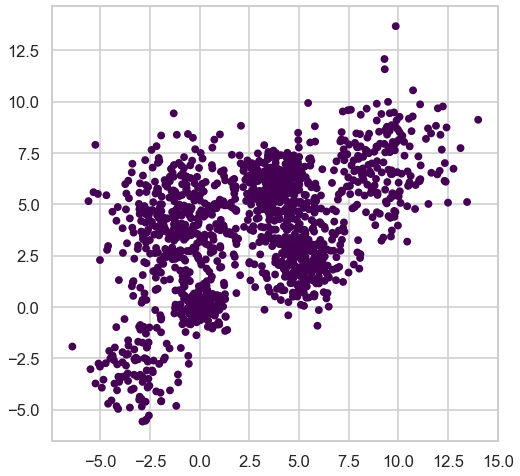

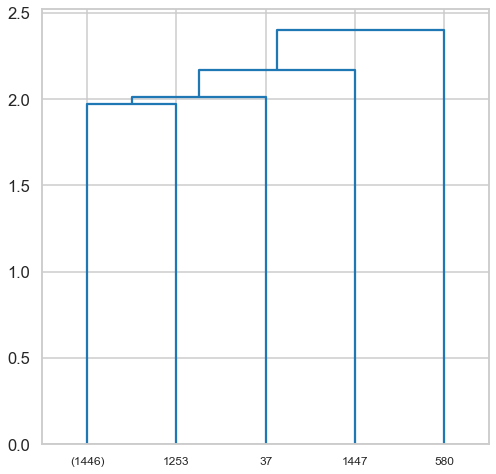

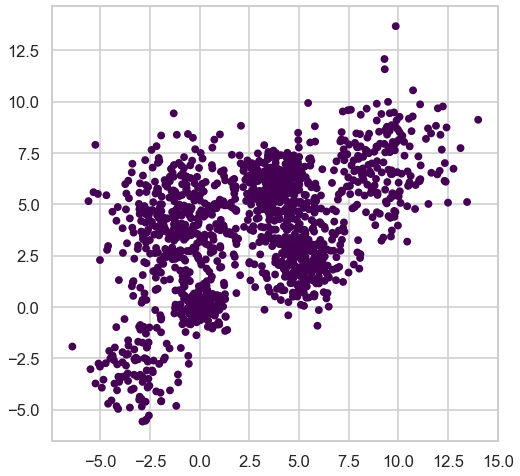

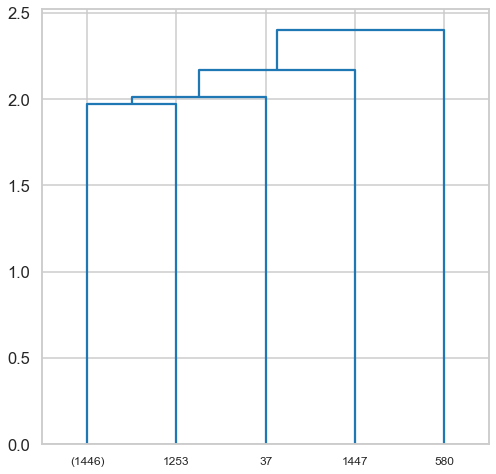

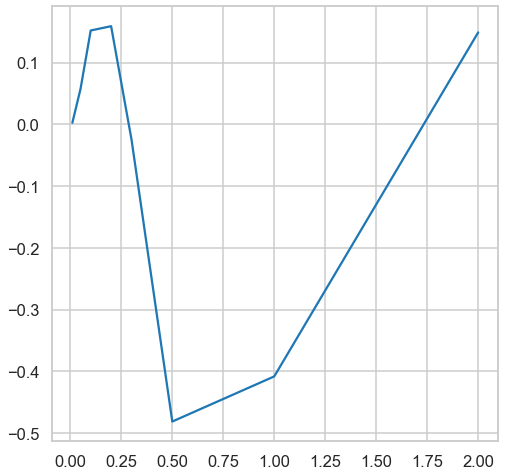

[0.4716908069861964,
 0.3218066204847175,
 0.46762361386512785,
 0.15880107790291045]

In [ ]:
distances=[0.01,0.05,0.1,0.2,0.3,0.5,1,2,5,8,9]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='manhattan', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(Multi_blob_Data.copy())
  plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(Multi_blob_Data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

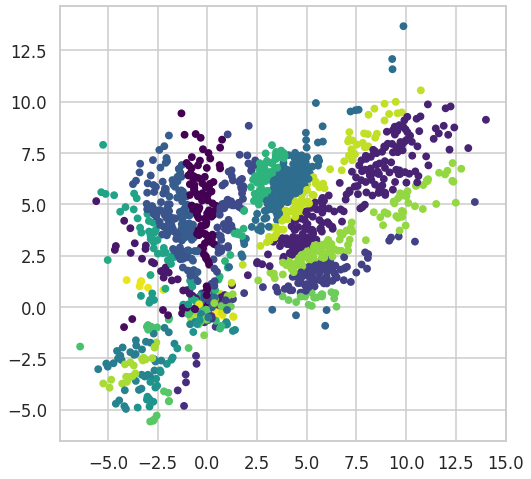

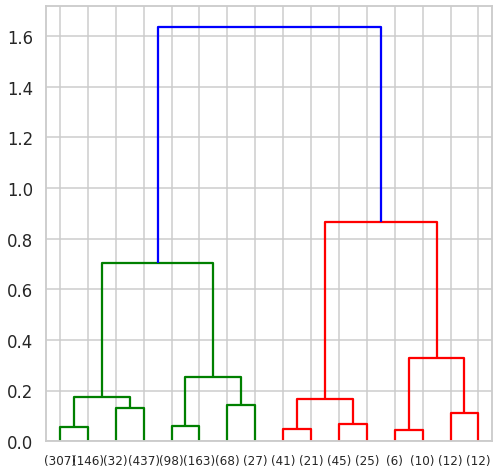

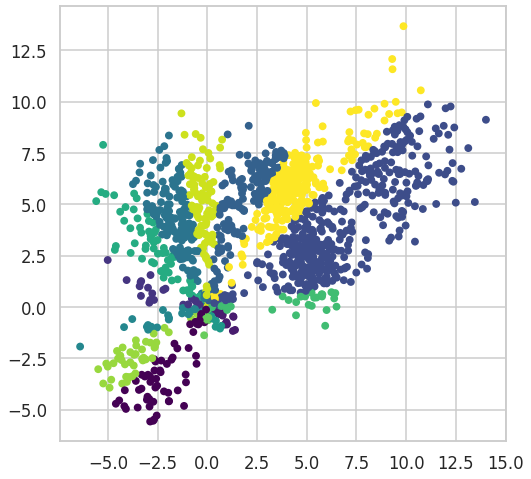

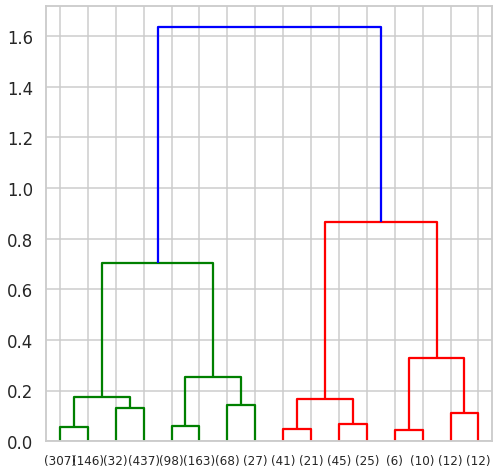

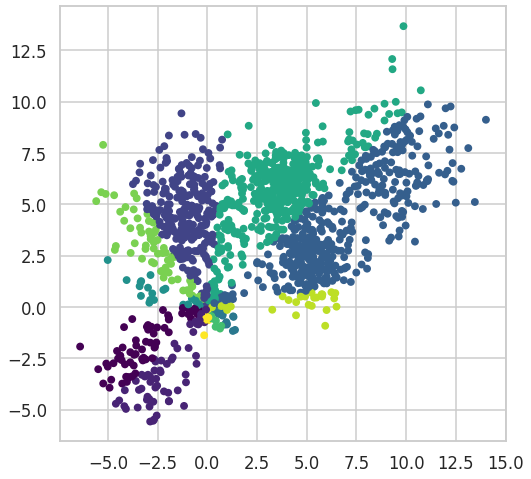

...

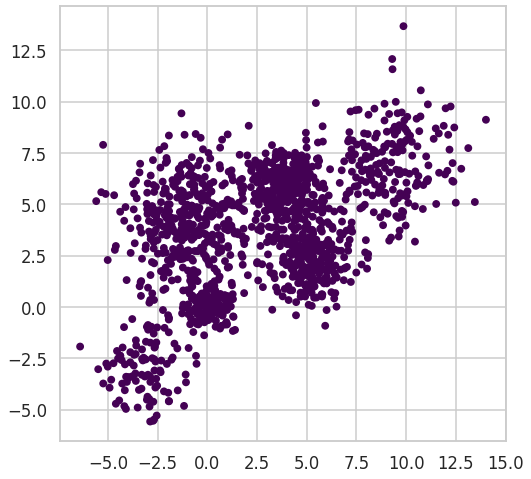

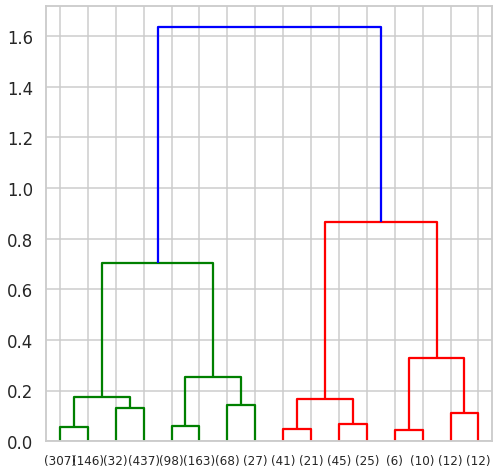

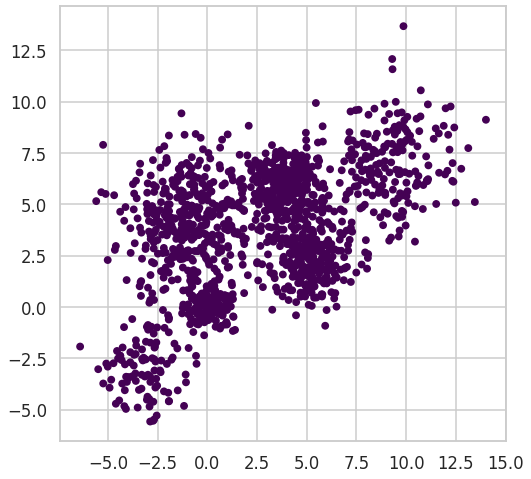

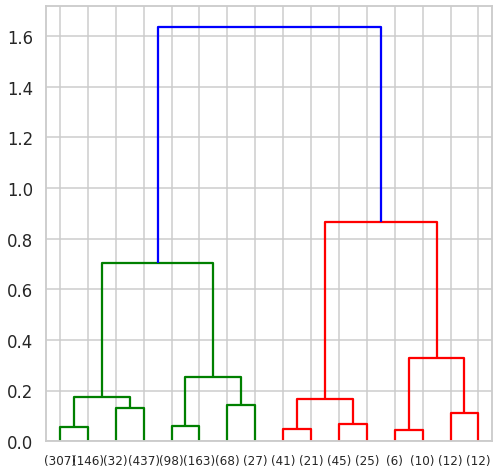

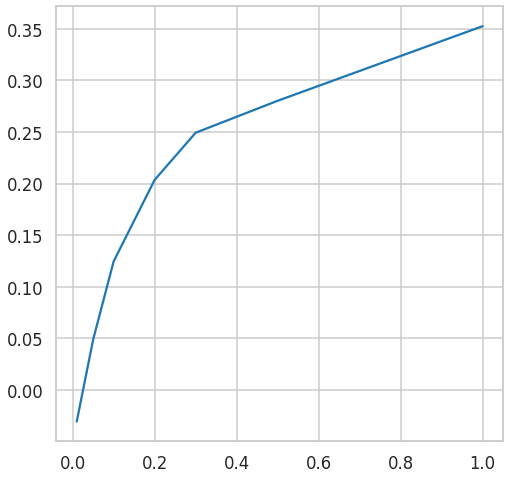

[0.4716908069861964,
 0.3218066204847175,
 0.46762361386512785,
 0.15880107790291045,
 0.35251834131557364]

In [ ]:
distances=[0.01,0.05,0.1,0.2,0.3,0.5,1,2,5,8,9]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='cosine', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(Multi_blob_Data.copy())
  plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(Multi_blob_Data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

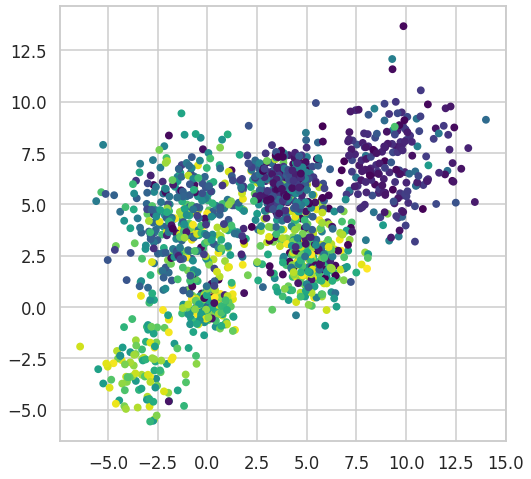

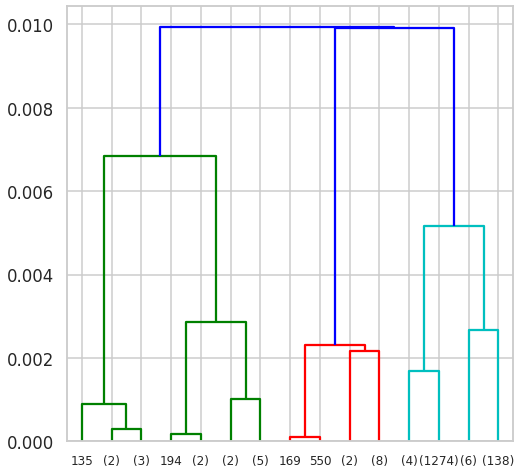

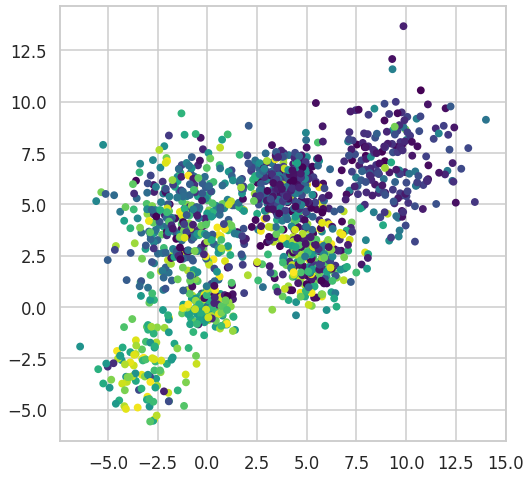

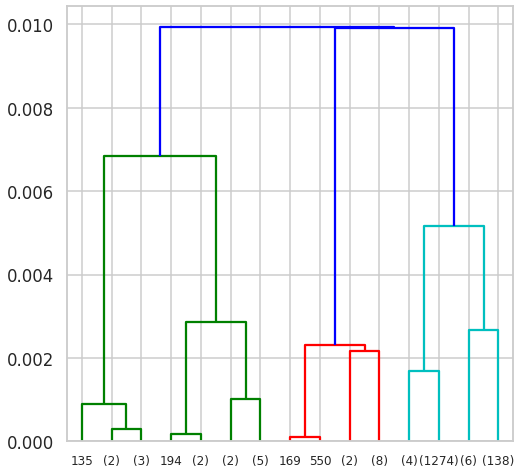

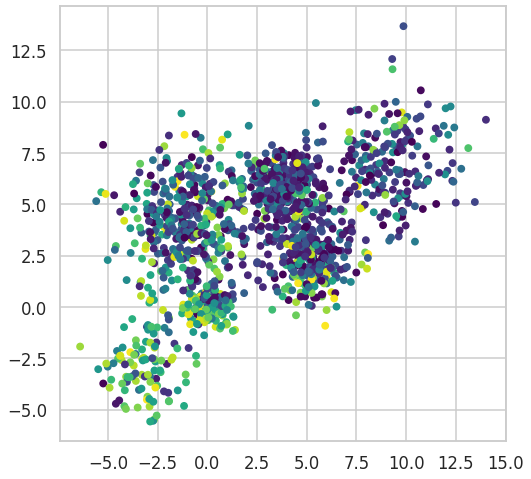

...

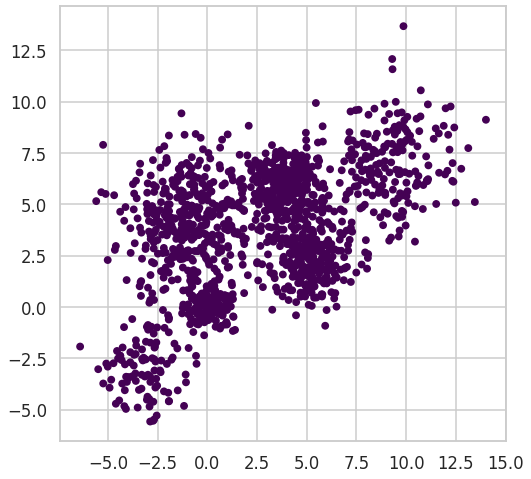

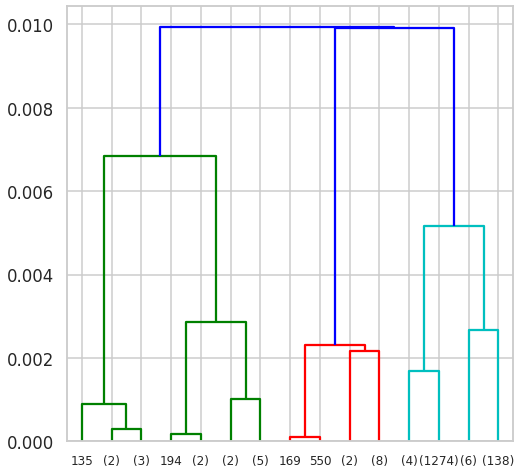

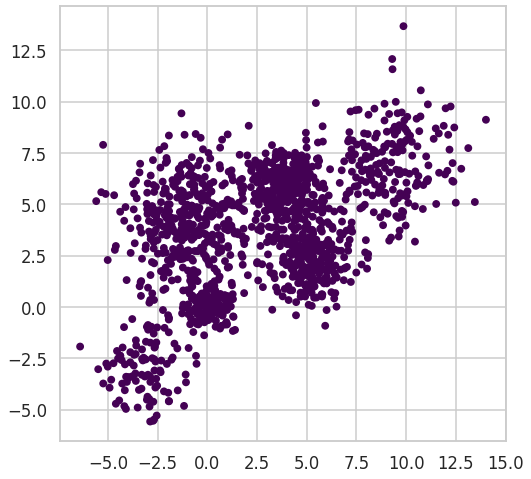

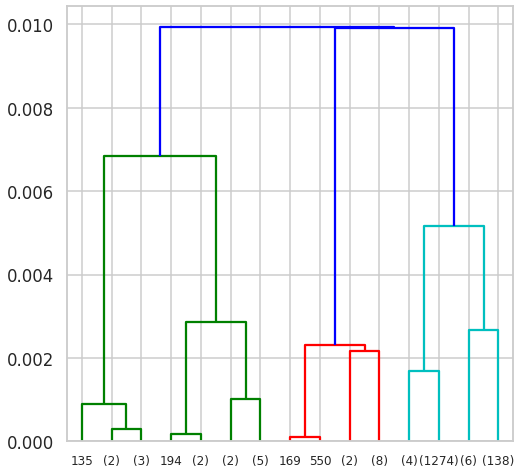

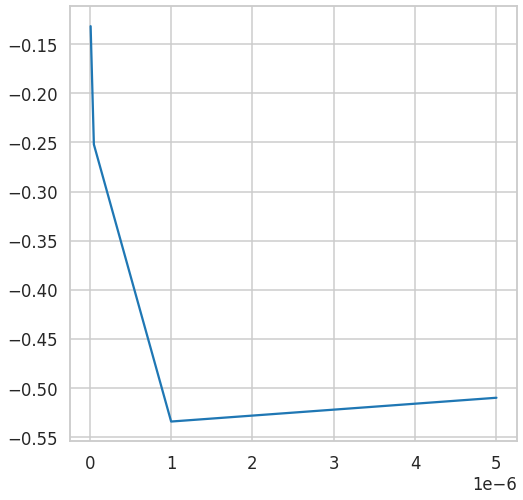

[0.30828513418773884,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 -0.13152982001637645,
 0.013333333333333334,
 0.013333333333333334,
 -0.13152982001637645]

In [ ]:
distances=[0.00000001,0.00000005,0.000001,0.000005,0.2,0.3,0.5,1,2,5,8,9]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='cosine', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(Multi_blob_Data.copy())
  plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(Multi_blob_Data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

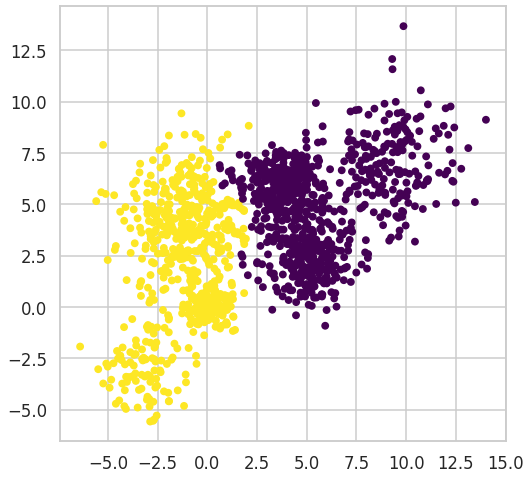

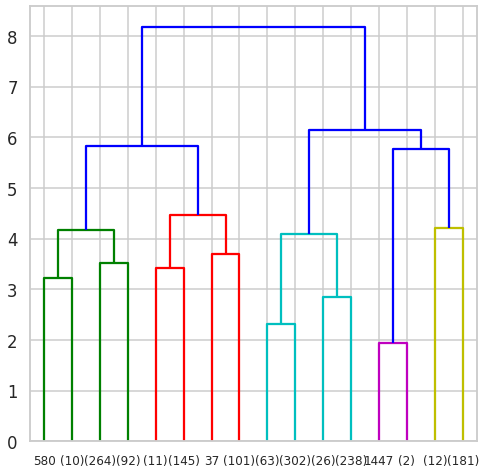

0.4716908069861964

In [ ]:
#best parameters are ecuilidian,average,distance_threshold=7
Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='average', distance_threshold= 7)
hc = Hierarchal_Clustering.fit(Multi_blob_Data.copy())
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=hc.labels_, s=40, cmap='viridis');
plt.show()
plot_dendrogram(hc,truncate_mode="level", p=3)
plt.show()
max_score= silhouette_score(Multi_blob_Data, hc.labels_ , metric='euclidean')  
  
max_score

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

In [ ]:
# changing values of EBS
Max_silhouette= []
EPS = [0.1,0.3,0.5,0.7,0.9,1.1,1.3,1.5,1.7,1.9,2.1,2.3,2.5,2.7,3]
Min_samples = [5,10,15,20,25]
scores=[]
ebs_val=[]
for i in Min_samples:
    print("Min_sample",i)
    for j in EPS:
       DBS = DBSCAN(eps = j , min_samples = i).fit(Multi_blob_Data.copy())
       clusters = DBS.fit_predict(Multi_blob_Data.copy())
       plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=clusters, cmap="viridis")
       plt.show() 
       if(np.unique(DBS.labels_).shape[0] > 1):
         scores.append(silhouette_score(Multi_blob_Data, DBS.labels_ , metric='euclidean'))
         ebs_val.append(j)   
    plt.plot(ebs_val, scores)  
    plt.show() 
    Max_silhouette.append(max(scores))
    print(max(scores))


In [ ]:
print(max( Max_silhouette))
#The best sample from 15 to 25 
# The Best EPSs (2.1 , 2.1,

0.4685207355522043


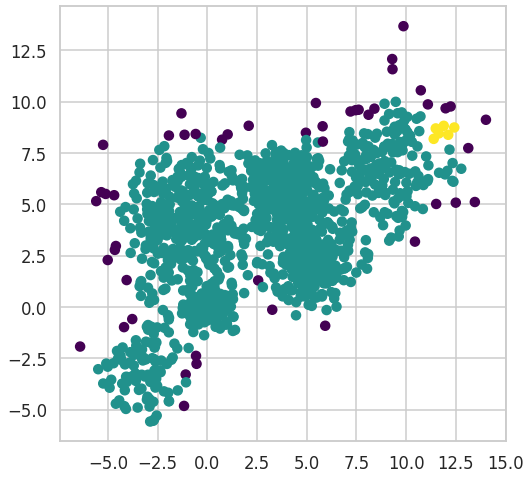

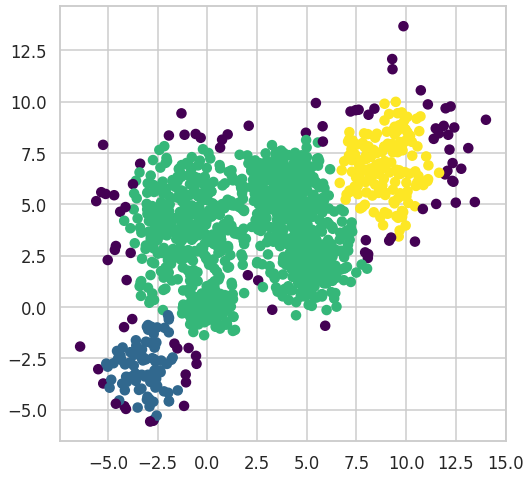

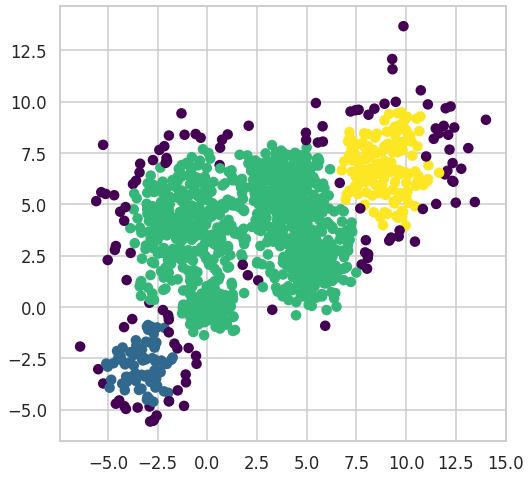

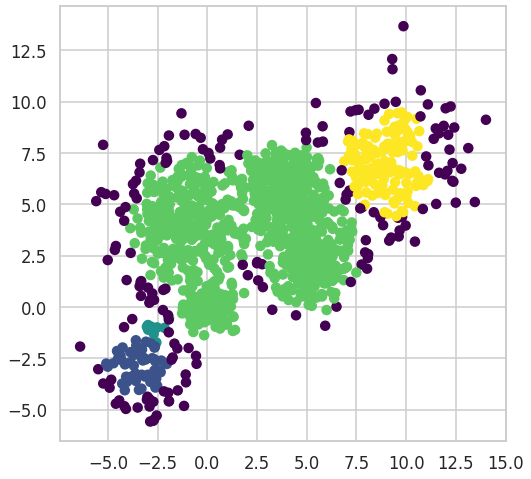

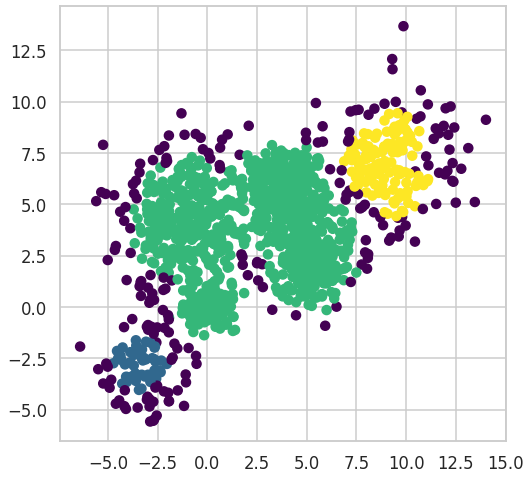

...

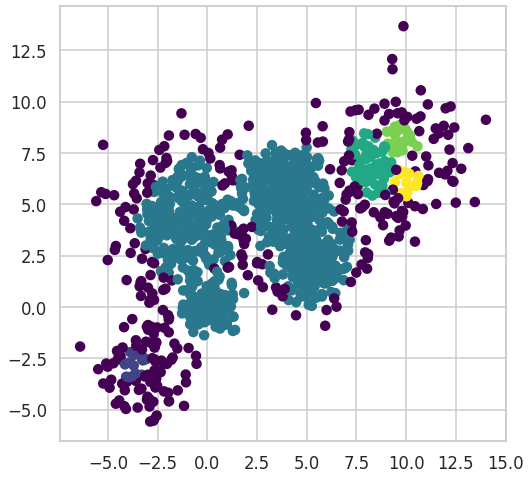

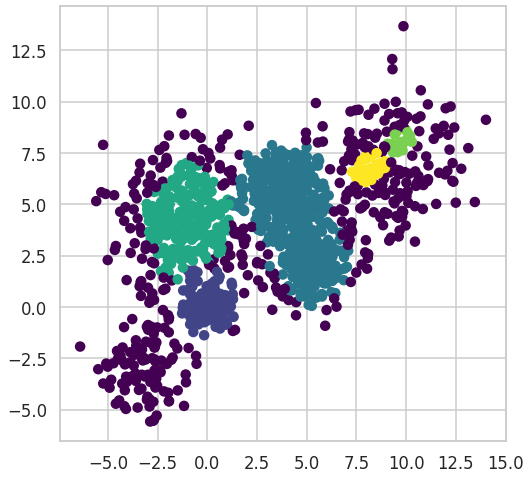

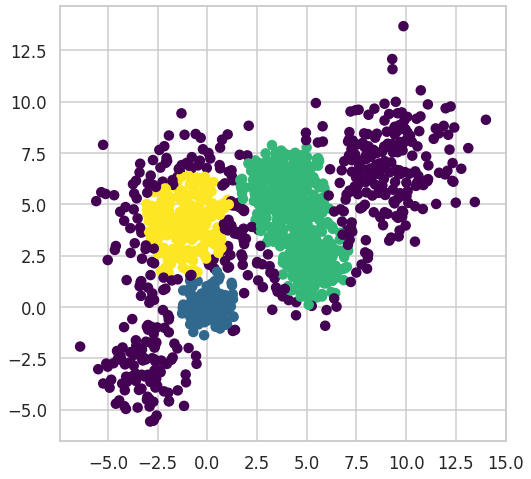

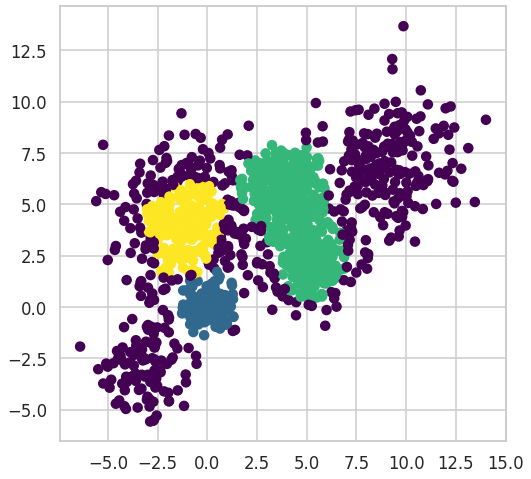

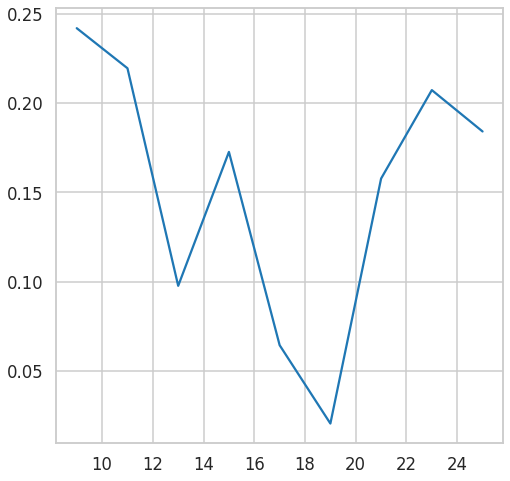

In [ ]:
# changing values of min_samples
j = 5
samples = []
scores=[]
while j<25:
  DBS = DBSCAN(eps = 0.7 , min_samples = j).fit(Multi_blob_Data.copy())
  clusters = DBS.fit_predict(Multi_blob_Data.copy())
  plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=clusters, cmap="viridis")
  plt.show()
  j=j+2  
  if(np.sum(np.unique((DBS.labels_)))>1):
    scores.append(silhouette_score(Multi_blob_Data, DBS.labels_ , metric='euclidean'))
    samples.append(j)  
 
plt.plot(samples, scores)  
plt.show()


In [ ]:

print(max(scores))



0.4685207355522043


### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

In [ ]:
from matplotlib.patches import Ellipse

def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, **kwargs))
        
def plot_gmm(gmm, X, label=True, ax=None):
    ax = ax or plt.gca()
    labels = gmm.fit(X).predict(X)
    if label:
        ax.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis', zorder=2)
    else:
        ax.scatter(X[:, 0], X[:, 1], s=40, zorder=2)
    ax.axis('equal')
    
    w_factor = 0.2 / gmm.weights_.max()
    for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
        draw_ellipse(pos, covar, alpha=w * w_factor)

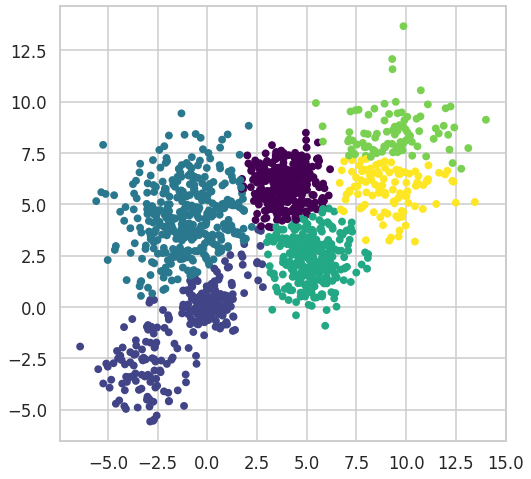

In [ ]:
from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='full').fit(Multi_blob_Data.copy())
labels = gmm.predict(Multi_blob_Data)
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=labels, s=40, cmap='viridis');


[[0.    1.    0.    0.   ]
 [0.    0.992 0.008 0.   ]
 [0.    1.    0.    0.   ]
 [0.    0.998 0.002 0.   ]
 [0.    1.    0.    0.   ]]


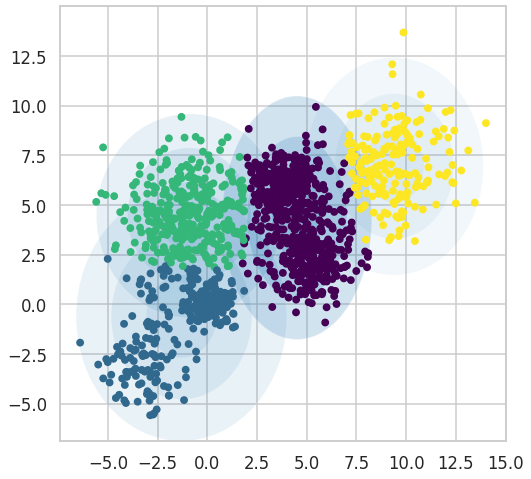

In [ ]:
gmm = mixture.GaussianMixture(n_components=4, random_state=42, covariance_type='diag').fit(Multi_blob_Data.copy())
plot_gmm(gmm, Multi_blob_Data)
probs = gmm.predict_proba(Multi_blob_Data)
print(probs[:5].round(3))

[[0.    1.    0.    0.    0.    0.   ]
 [0.    0.982 0.018 0.    0.    0.   ]
 [0.    1.    0.    0.    0.    0.   ]
 [0.    0.996 0.004 0.    0.    0.   ]
 [0.    0.999 0.001 0.    0.    0.   ]]


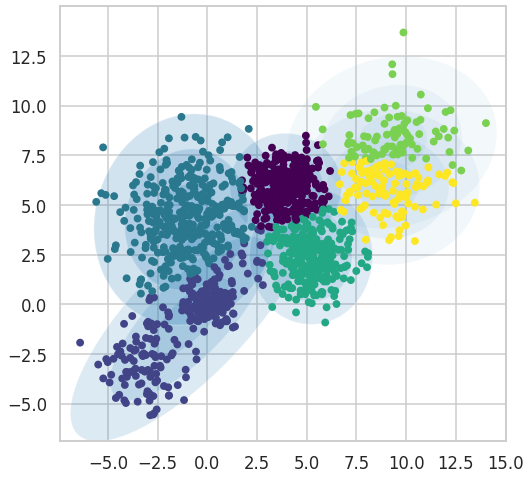

In [ ]:

gmm = mixture.GaussianMixture(n_components=6, random_state=42, covariance_type="full").fit(Multi_blob_Data.copy())
plot_gmm(gmm, Multi_blob_Data)
probs = gmm.predict_proba(Multi_blob_Data)
print(probs[:5].round(3))


[[0.    1.    0.    0.    0.    0.   ]
 [0.    0.994 0.006 0.    0.    0.   ]
 [0.    1.    0.    0.    0.    0.   ]
 [0.    0.999 0.001 0.    0.    0.   ]
 [0.    1.    0.    0.    0.    0.   ]]


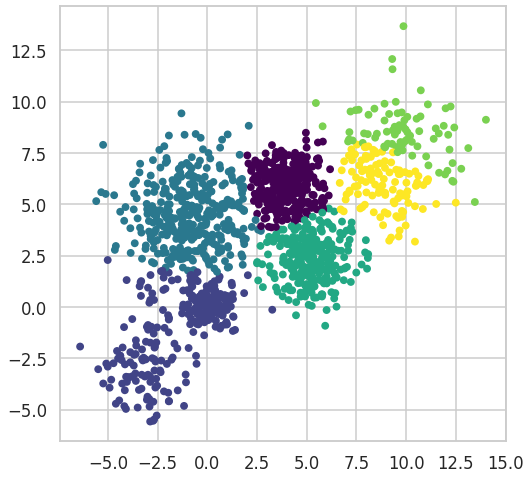

In [ ]:
from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='spherical').fit(Multi_blob_Data.copy())
labels = gmm.predict(Multi_blob_Data)
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=labels, s=40, cmap='viridis');
probs = gmm.predict_proba(Multi_blob_Data)
print(probs[:5].round(3))


[[0.018 0.    0.    0.    0.982 0.   ]
 [0.681 0.    0.    0.    0.318 0.   ]
 [0.003 0.    0.    0.    0.997 0.   ]
 [0.719 0.    0.    0.    0.281 0.   ]
 [0.012 0.    0.    0.    0.988 0.   ]]


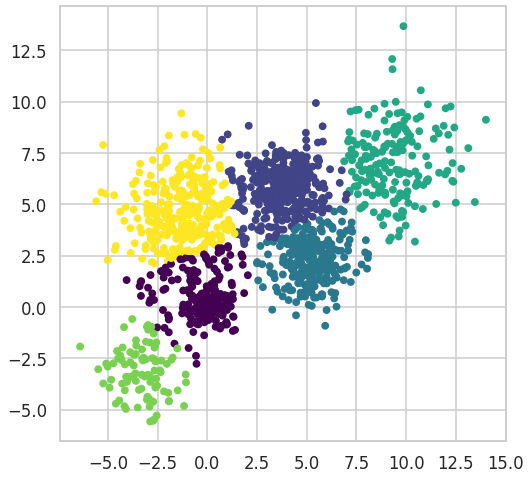

In [ ]:
gmm = mixture.GaussianMixture(n_components= 6,covariance_type='tied').fit(Multi_blob_Data.copy())
labels = gmm.predict(Multi_blob_Data)
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=labels, s=40, cmap='viridis');
probs = gmm.predict_proba(Multi_blob_Data)
print(probs[:5].round(3))


[[0.    1.    0.    0.    0.    0.   ]
 [0.    0.999 0.001 0.    0.    0.   ]
 [0.    1.    0.    0.    0.    0.   ]
 [0.    1.    0.    0.    0.    0.   ]
 [0.    1.    0.    0.    0.    0.   ]]


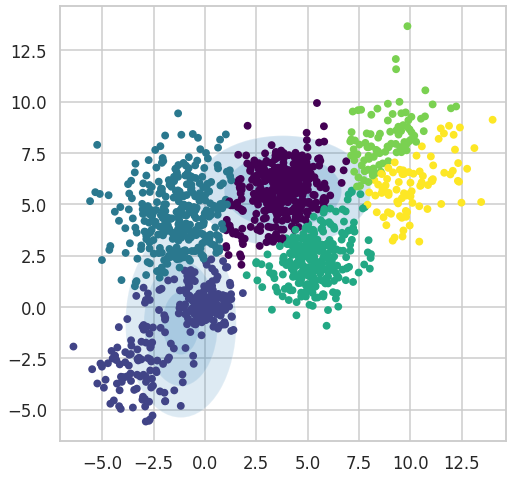

In [ ]:
gmm = mixture.GaussianMixture(n_components=6, random_state=42, covariance_type="tied").fit(Multi_blob_Data.copy())
plot_gmm(gmm, Multi_blob_Data)
probs = gmm.predict_proba(Multi_blob_Data)
print(probs[:5].round(3))

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [ ]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']


['setosa', 'versicolor', 'virginica']

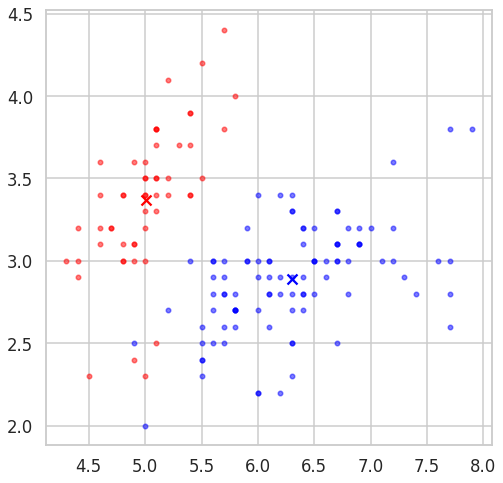

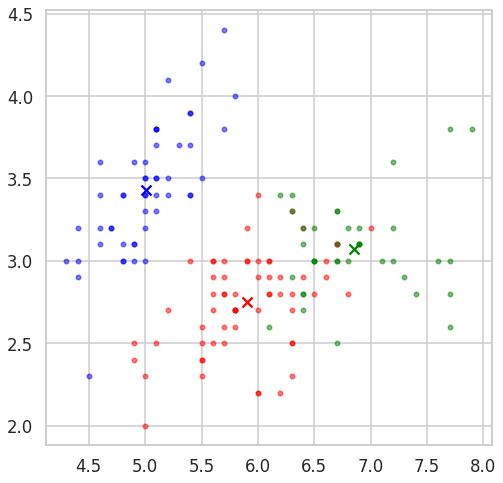

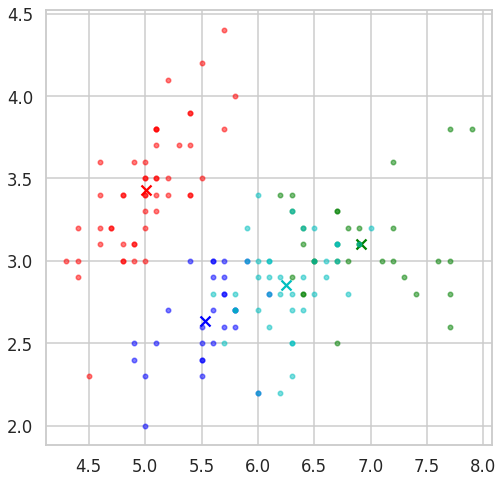

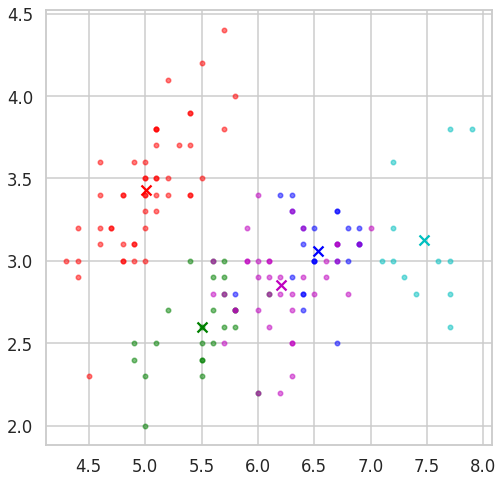

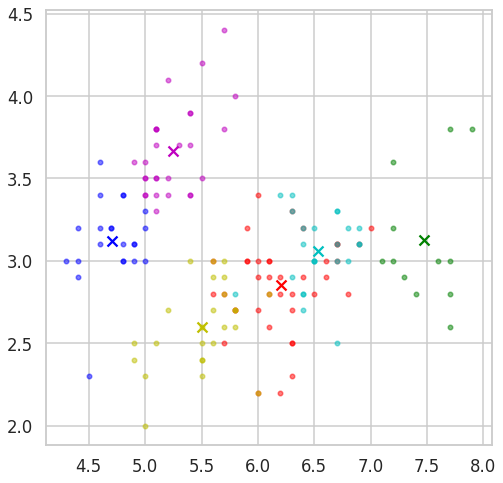

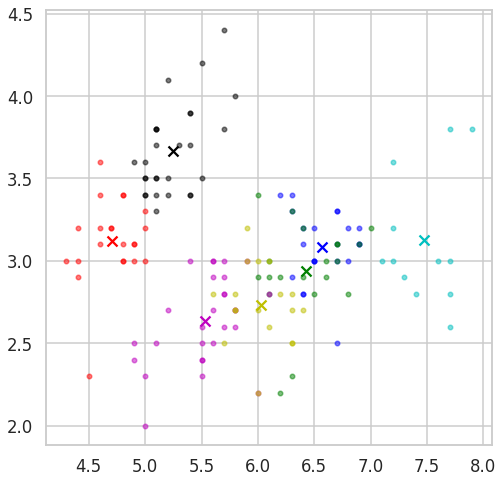

In [ ]:
#K-means
#displaying the outcome
for i in range (2,8):
 kmeans = KMeans(i)
 kmeans.fit(iris_data.data)
 display_cluster(iris_data.data,kmeans,num_clusters=i)  
 plt.show()

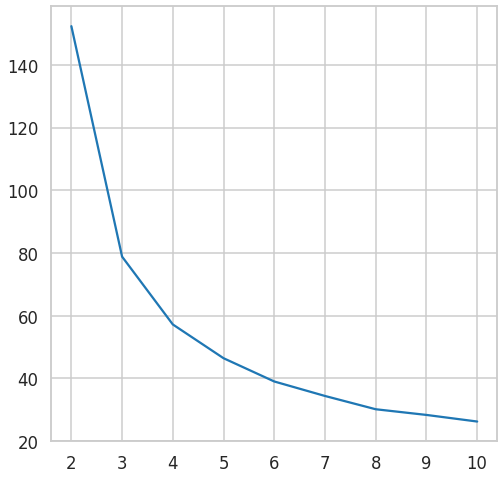

In [ ]:
#plotting distortion function
distortions = []
for i in range (2,11):
 kmeans = KMeans(i)
 kmeans.fit(iris_data.data)
 distortion_i = kmeans.inertia_
 distortions.append(distortion_i)
values_k = range (2,11)
plt.plot(values_k,distortions)
plt.show()  

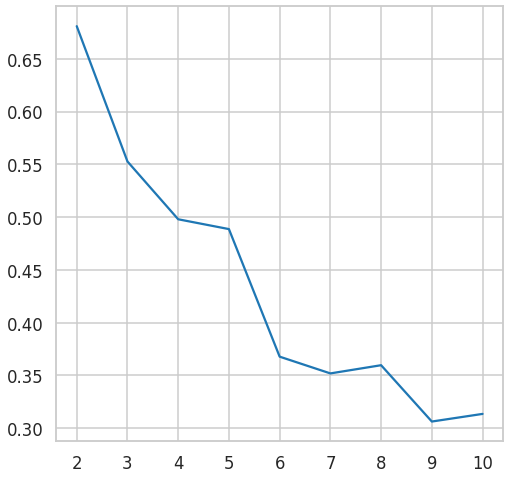

In [ ]:
#Ploting the silhouette_score
scores=[]
for i in range (2,11):
 kmeans = KMeans(i)
 kmeans.fit(iris_data.data)
 clusters =   kmeans.fit_predict(iris_data.data) 
 scores.append(silhouette_score(iris_data.data, clusters , metric='euclidean'))
values_k = range (2,11)
plt.plot(values_k,scores)
plt.show()  

In [ ]:
#The best k is equal to 6 from elbow method and silhouette_score
kmeans = KMeans(6)
kmeans.fit(iris_data.data)
scores_best_k_kmeans = (silhouette_score(iris_data.data, kmeans.labels_, metric='euclidean'))
scores_best_k_kmeans

0.36784649847122436

In [ ]:
#Hierarchal Clustering using IRIS DATA SEt
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

In [ ]:
all_scores=[]

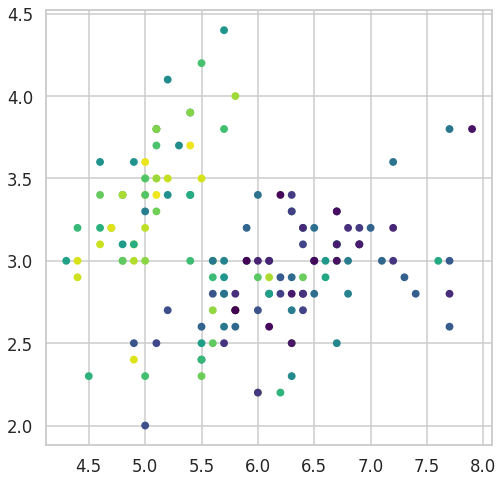

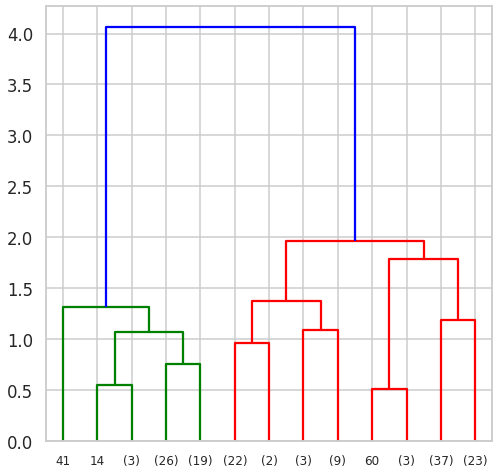

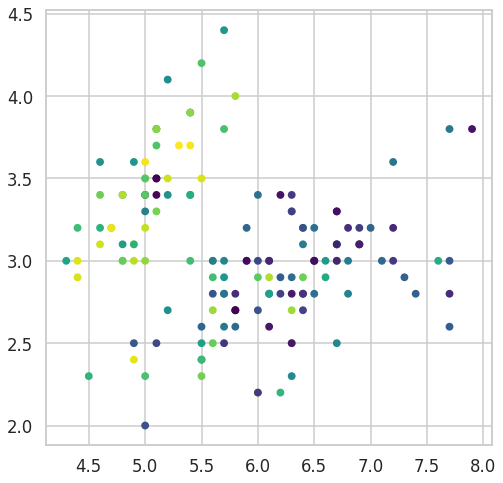

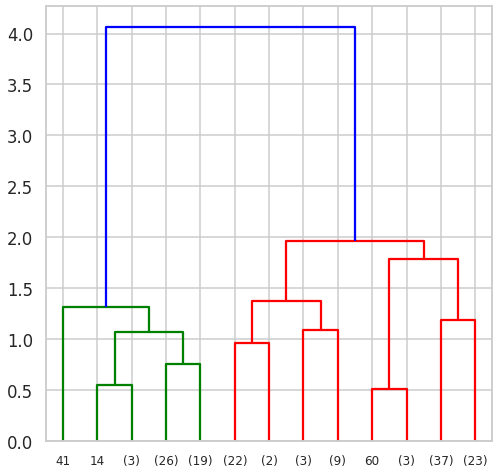

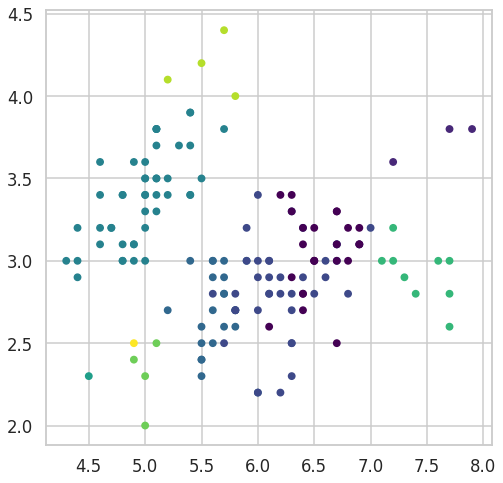

...

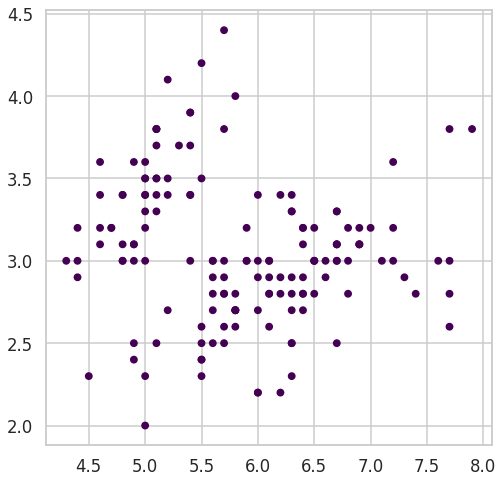

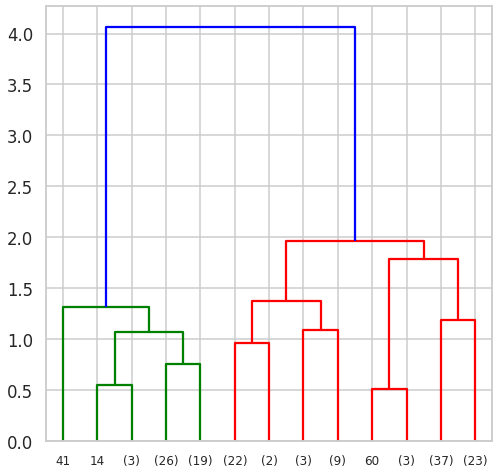

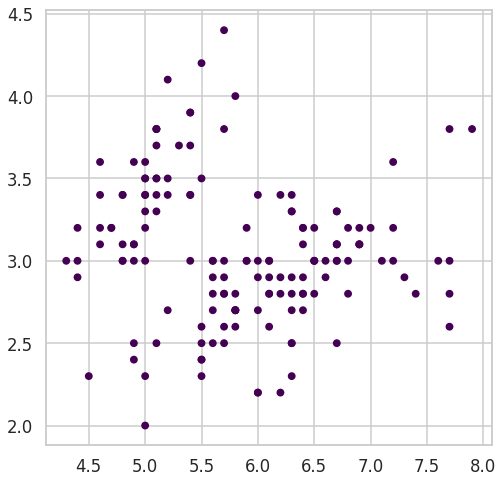

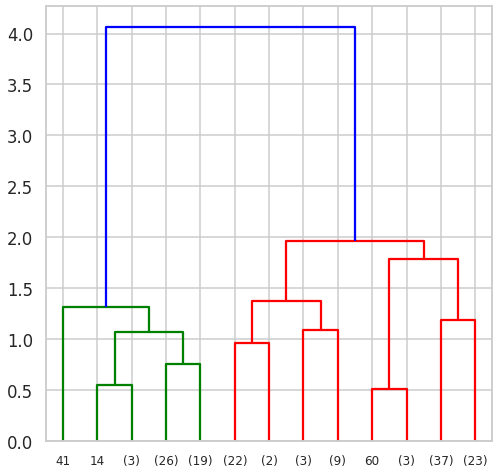

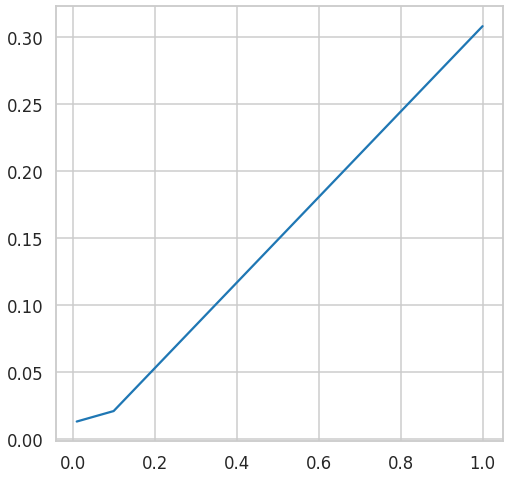

[0.30828513418773884]

In [ ]:
distances=[0.01,0.1,1,5,6,7,9,10]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(iris_data.data)
  plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(iris_data.data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

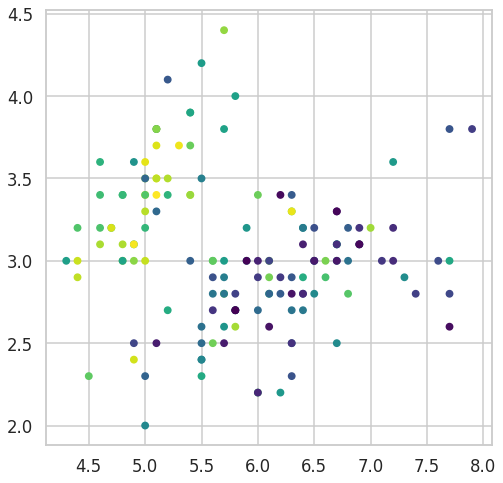

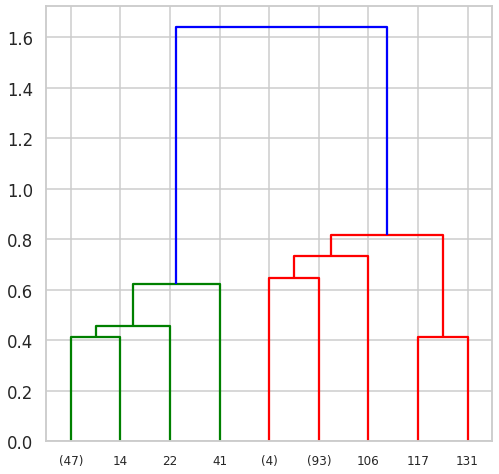

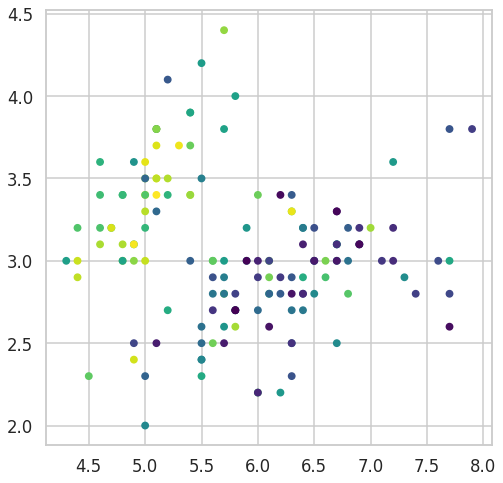

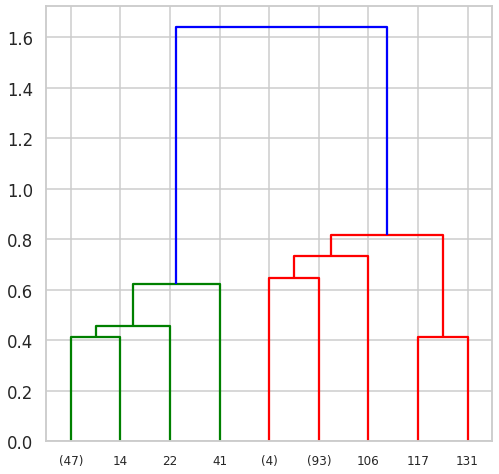

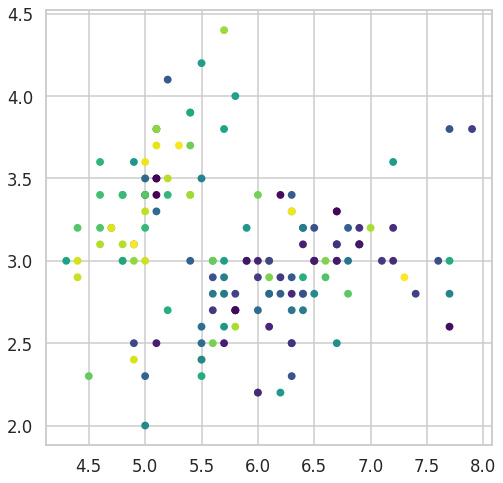

...

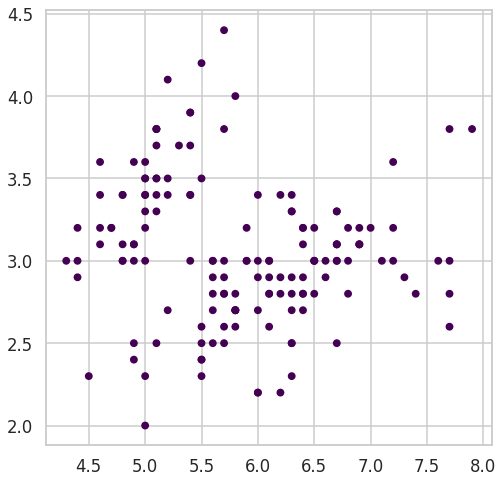

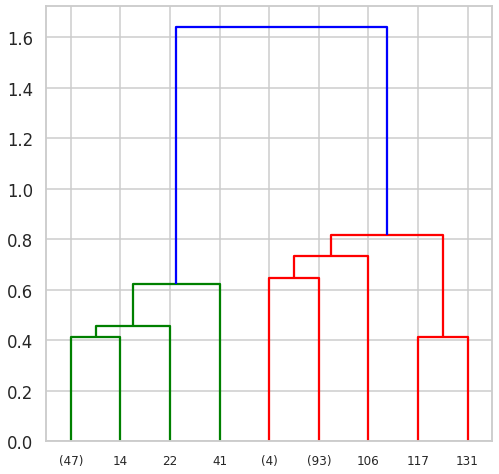

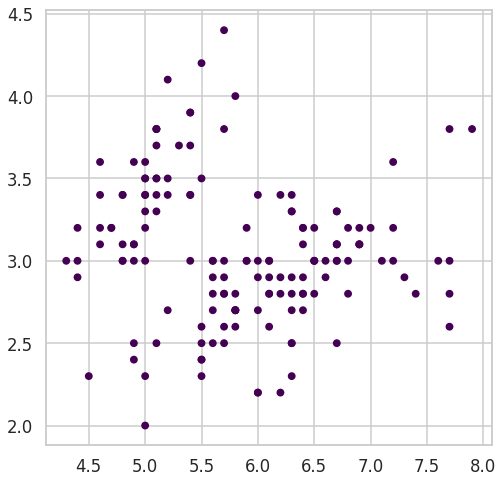

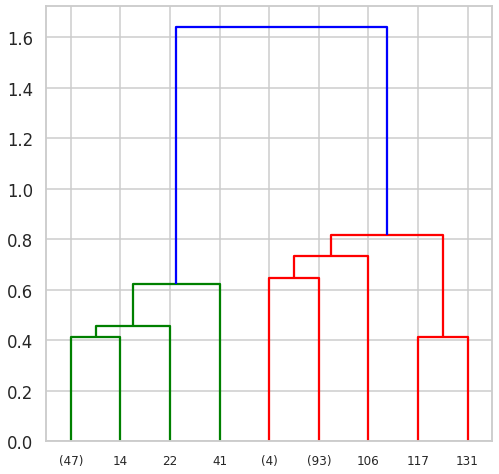

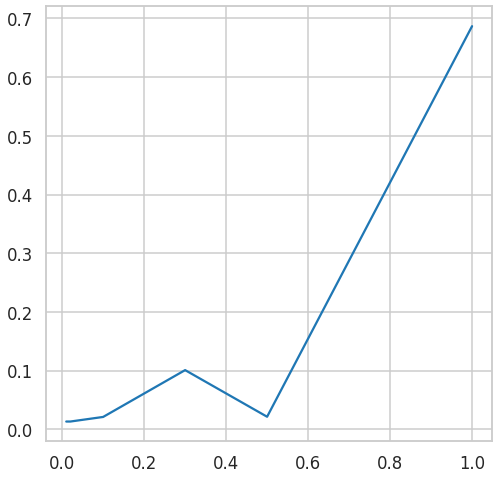

[0.30828513418773884, 0.6867350732769777, 0.6867350732769777]

In [ ]:
distances=[0.01,0.02,0.1,0.3,0.5,1,2,3,5,6]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(iris_data.data)
  plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(iris_data.data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

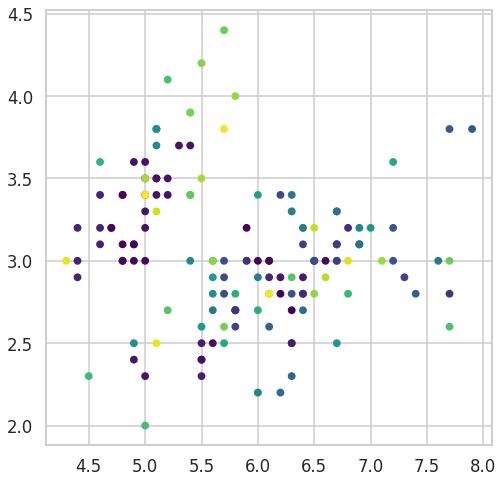

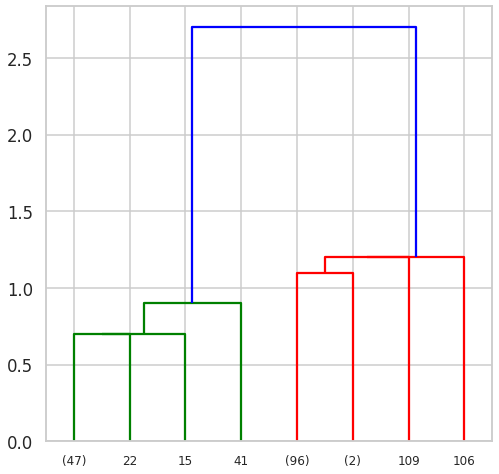

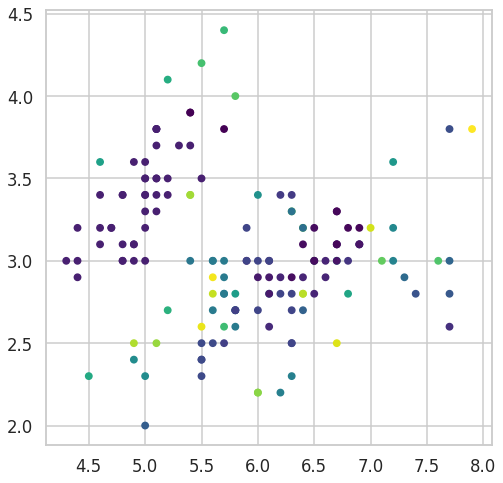

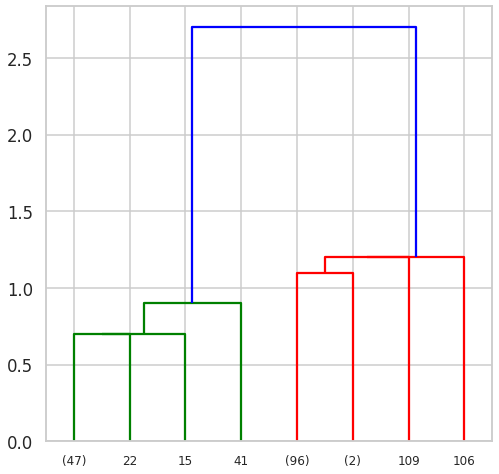

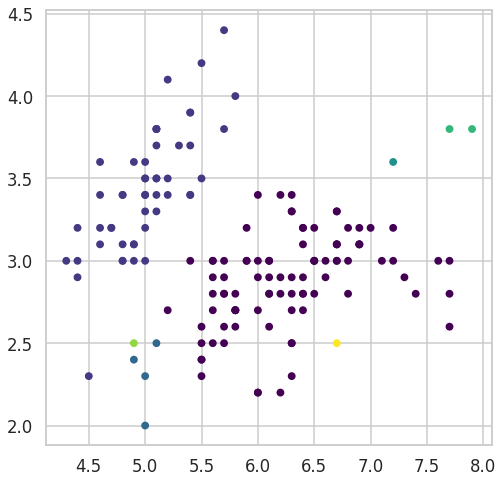

...

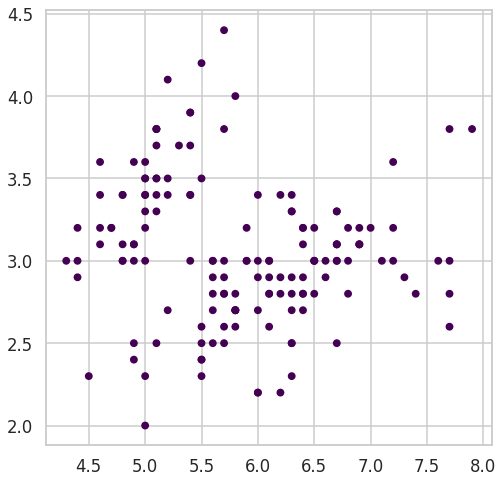

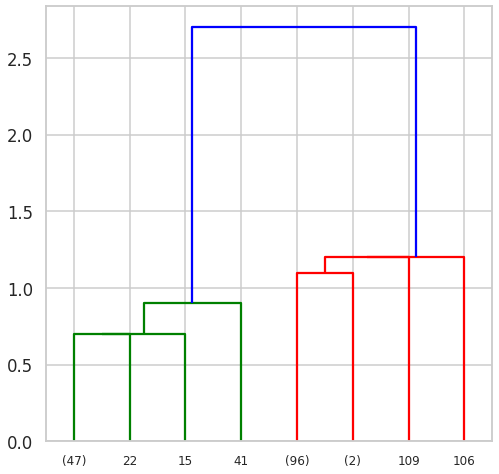

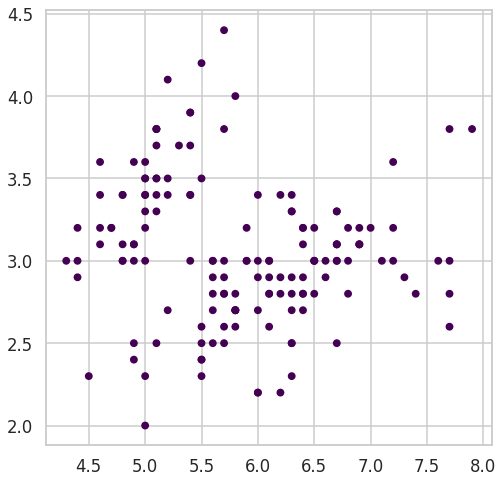

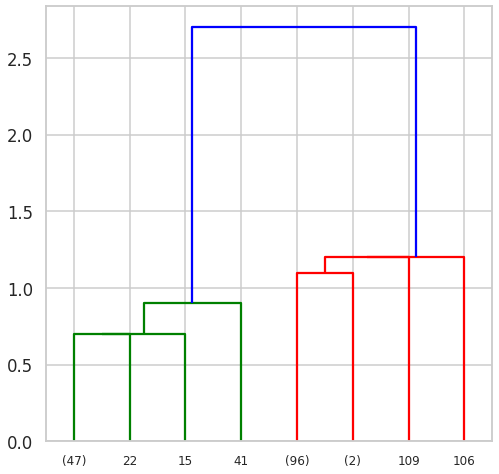

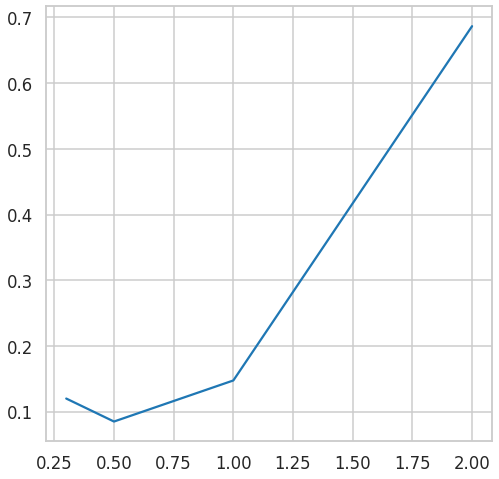

[0.30828513418773884, 0.6867350732769777, 0.6867350732769777]

In [ ]:
distances=[0.3,0.5,1,2,5,8,9,10,11,12,13]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='manhattan', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(iris_data.data)
  plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(iris_data.data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores


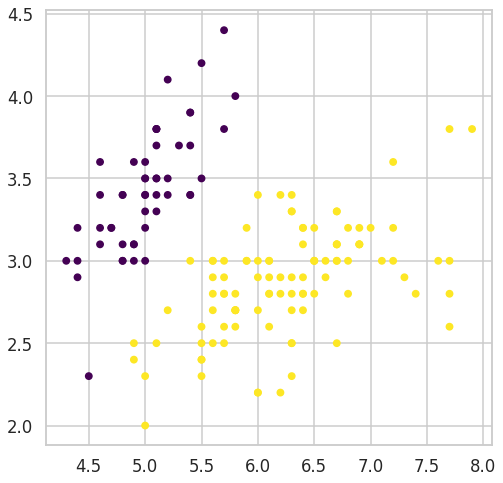

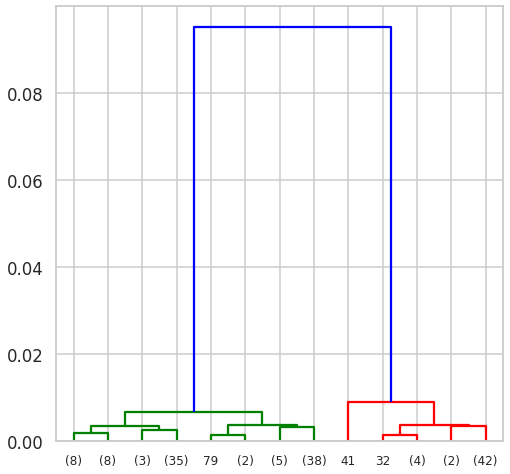

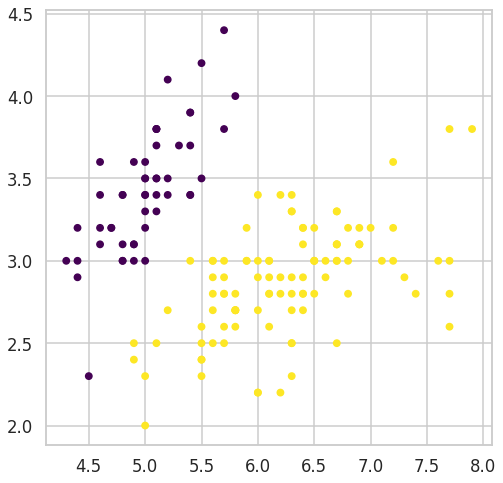

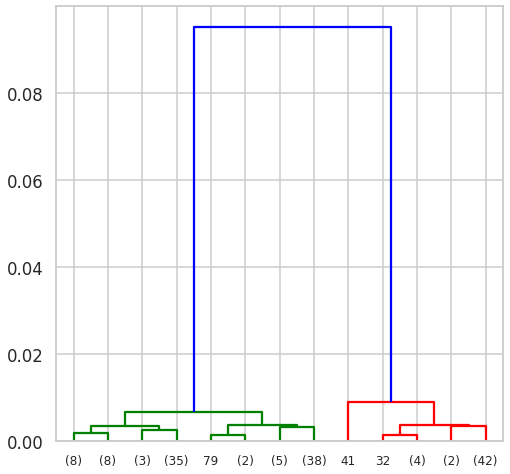

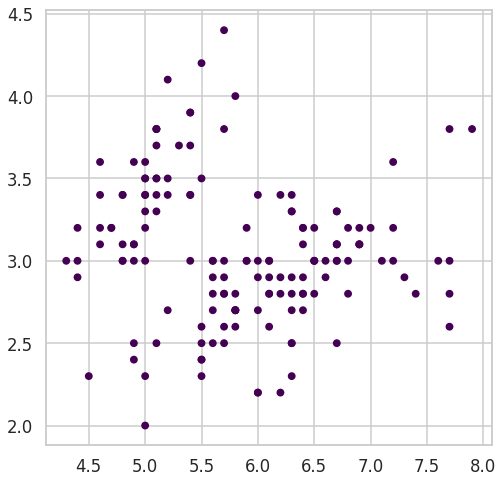

...

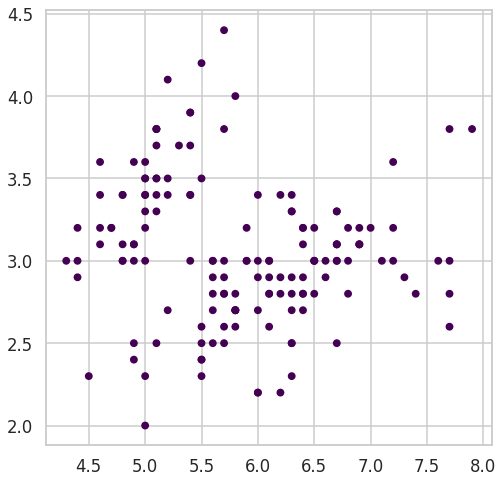

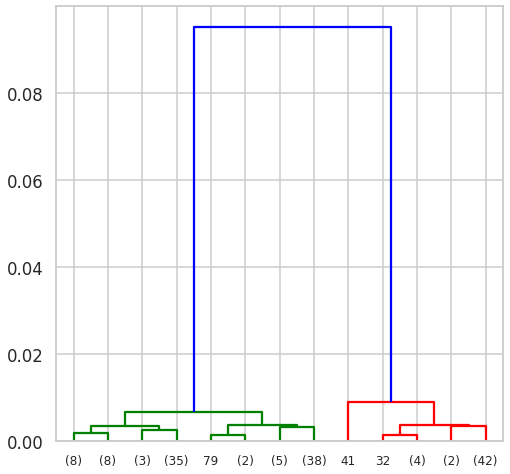

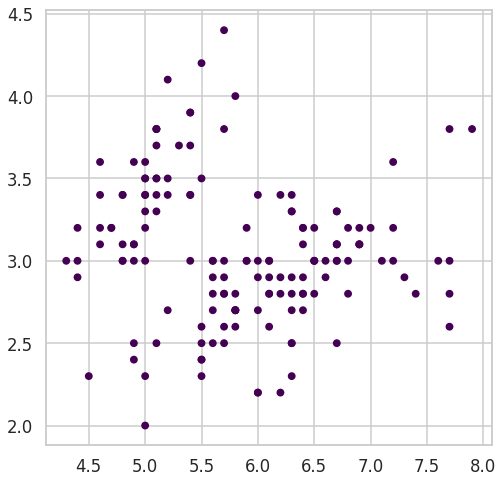

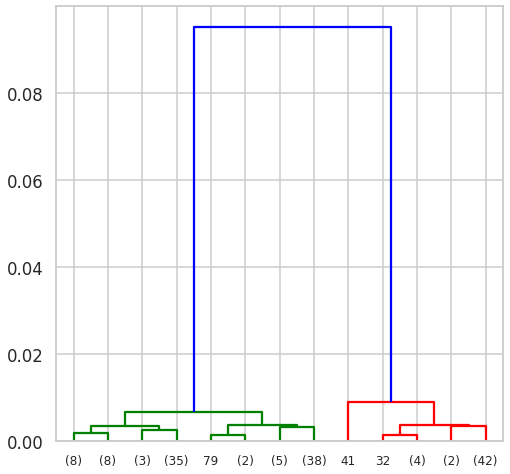

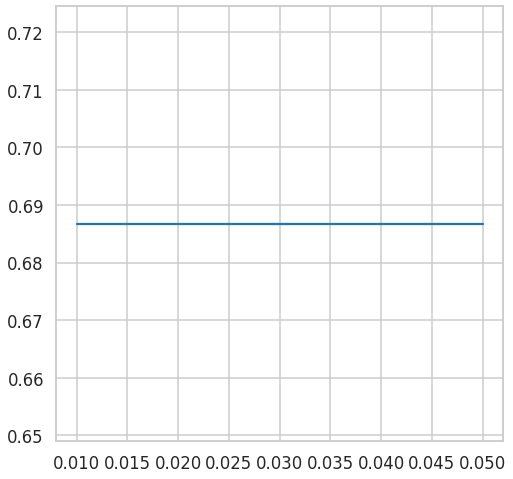

[0.30828513418773884,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777]

In [ ]:
distances=[0.01,0.05,0.1,0.2,0.3,0.5,1,2,5,8,9]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='cosine', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(iris_data.data)
  plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(iris_data.data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

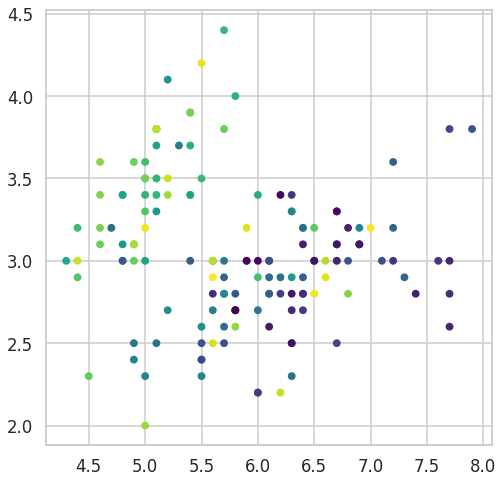

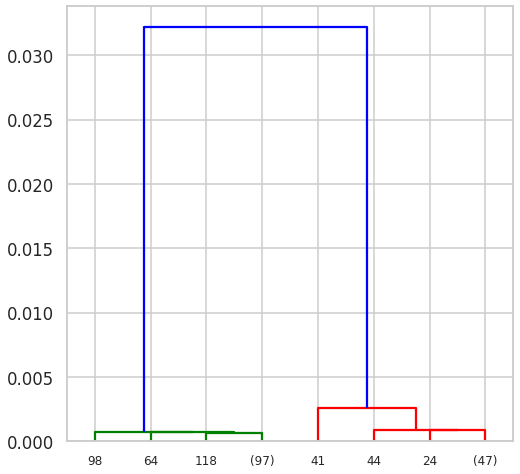

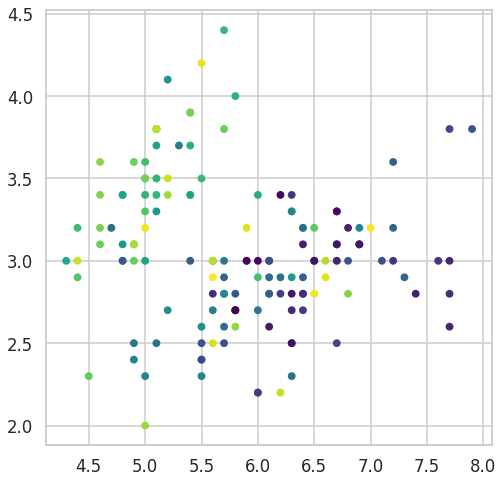

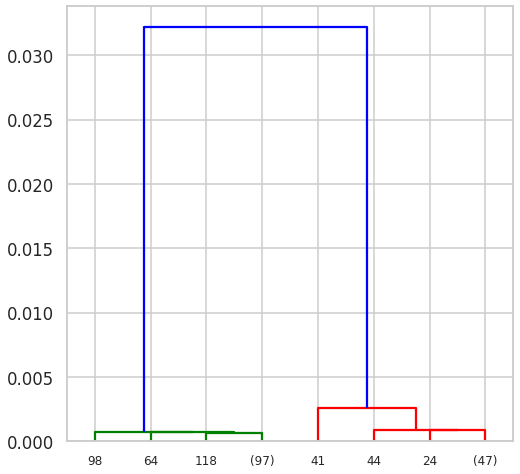

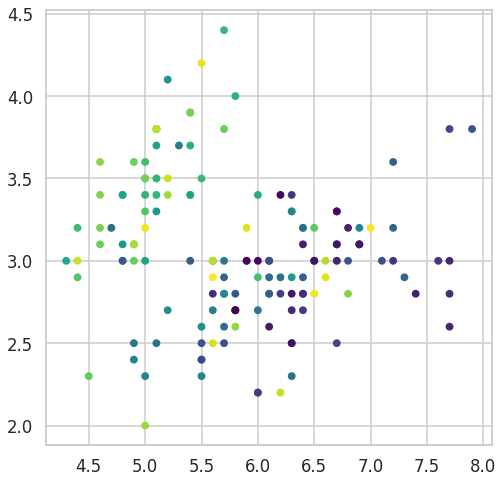

...

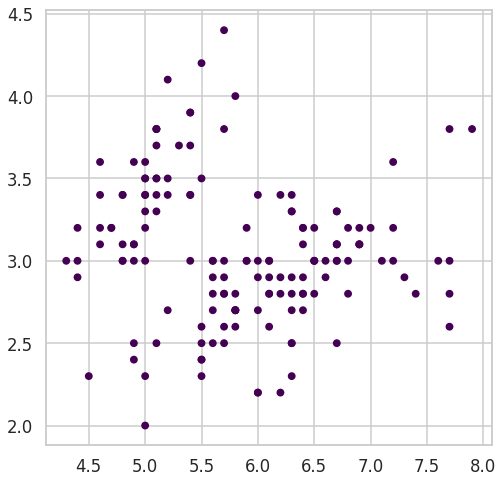

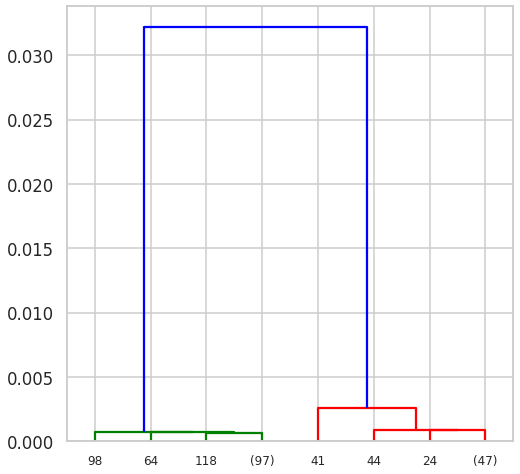

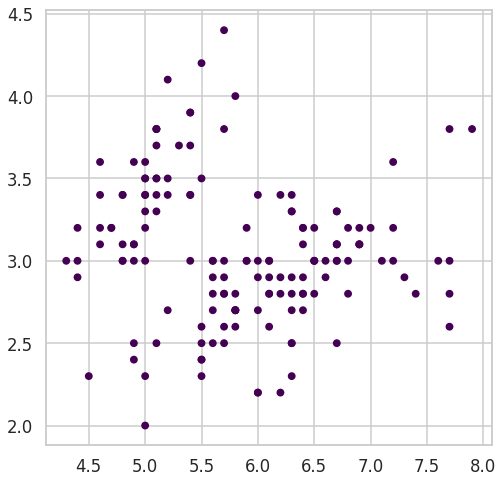

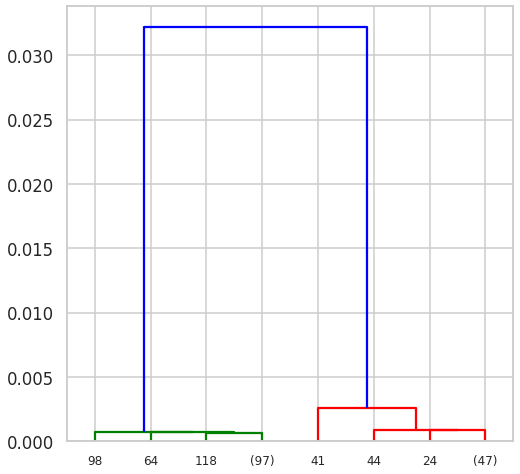

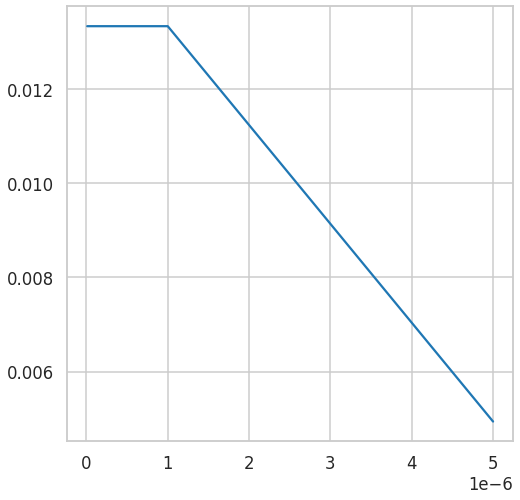

[0.30828513418773884,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 0.6867350732769777,
 -0.13152982001637645,
 0.013333333333333334,
 0.013333333333333334]

In [ ]:

distances=[0.00000001,0.00000005,0.000001,0.000005,0.2,0.3,0.5,1,2,5,8,9]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='cosine', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(iris_data.data)
  plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(iris_data.data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

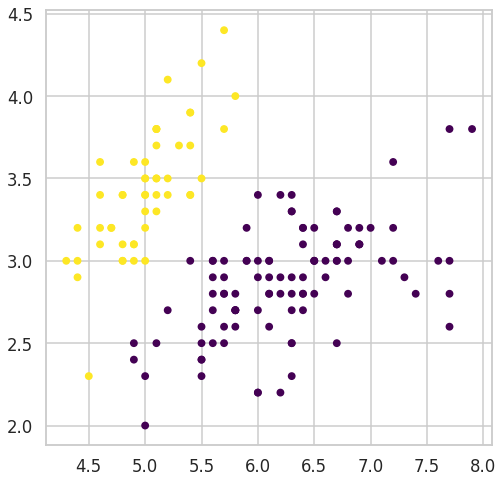

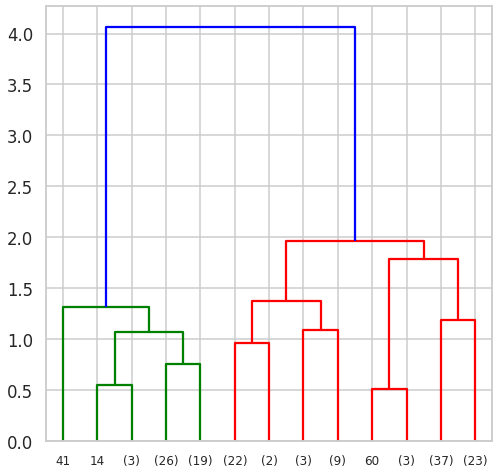

In [ ]:
#best parameters are ecuilidian,average,distance_threshold=7
Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='average', distance_threshold= 4)
hc = Hierarchal_Clustering.fit(iris_data.data)
plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=hc.labels_, s=40, cmap='viridis');
plt.show()
plot_dendrogram(hc,truncate_mode="level", p=3)
plt.show()
max_score= silhouette_score(iris_data.data, hc.labels_ , metric='euclidean')    



In [ ]:
#GAUSSIAN MIXTURE
from matplotlib.patches import Ellipse

def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, **kwargs))
        
def plot_gmm(gmm, X, label=True, ax=None):
    ax = ax or plt.gca()
    labels = gmm.fit(X).predict(X)
    if label:
        ax.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis', zorder=2)
    else:
        ax.scatter(X[:, 0], X[:, 1], s=40, zorder=2)
    ax.axis('equal')
    
    w_factor = 0.2 / gmm.weights_.max()
    for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
        draw_ellipse(pos, covar, alpha=w * w_factor)

[[0.    0.959 0.    0.    0.    0.041]
 [0.    0.998 0.    0.    0.    0.002]
 [0.    1.    0.    0.    0.    0.   ]
 [0.    1.    0.    0.    0.    0.   ]
 [0.    0.983 0.    0.    0.    0.017]]


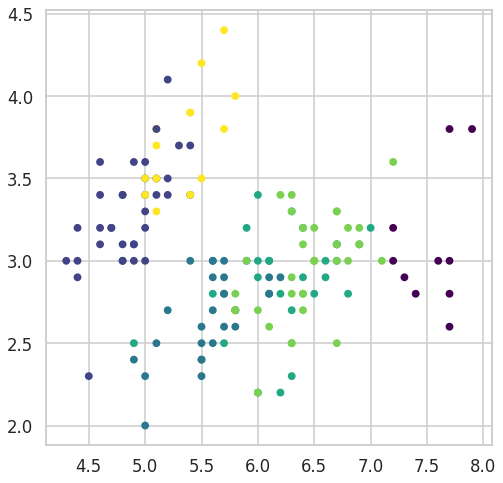

In [ ]:
#gmm using full
from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='full').fit(iris_data.data)
labels = gmm.predict(iris_data.data)
plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=labels, s=40, cmap='viridis');
probs = gmm.predict_proba(iris_data.data)
print(probs[:5].round(3))


[[0.    0.486 0.    0.    0.    0.514]
 [0.    0.944 0.    0.    0.    0.056]
 [0.    0.881 0.    0.    0.    0.119]
 [0.    0.952 0.    0.    0.    0.048]
 [0.    0.403 0.    0.    0.    0.597]]


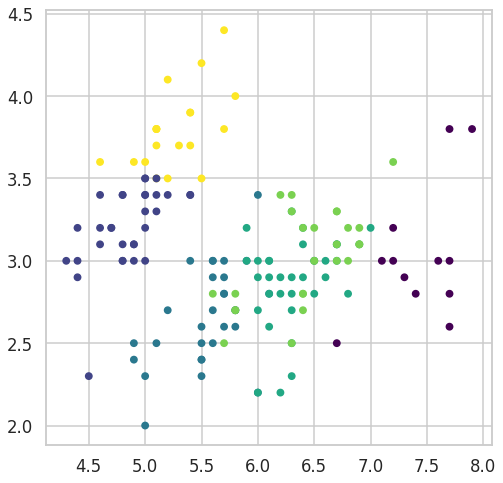

In [ ]:
#gmm using tied
from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='tied').fit(iris_data.data)
labels = gmm.predict(iris_data.data)
plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=labels, s=40, cmap='viridis');
probs = gmm.predict_proba(iris_data.data)
print(probs[:5].round(3))

[[0.    0.053 0.    0.    0.    0.947]
 [0.    0.998 0.    0.    0.    0.002]
 [0.    0.998 0.    0.    0.    0.002]
 [0.    1.    0.    0.    0.    0.   ]
 [0.    0.05  0.    0.    0.    0.95 ]]


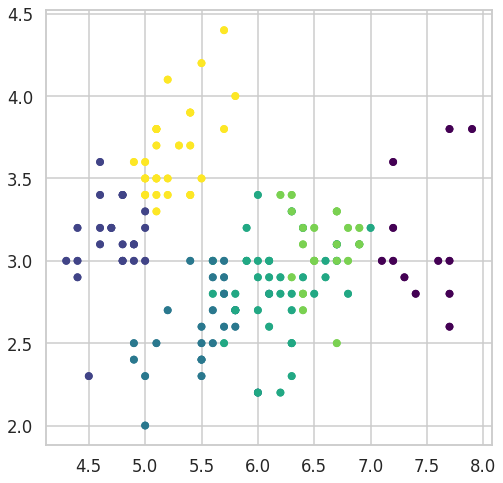

In [ ]:
#gmm using spherical
from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='spherical').fit(iris_data.data)
labels = gmm.predict(iris_data.data)
plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=labels, s=40, cmap='viridis');
labels = gmm.predict(iris_data.data)
plt.scatter(iris_data.data[:, 0],iris_data.data[:, 1], c=labels, s=40, cmap='viridis');
probs = gmm.predict_proba(iris_data.data)
print(probs[:5].round(3))

[[0.    0.585 0.    0.    0.    0.415]
 [0.    0.995 0.    0.    0.    0.005]
 [0.    0.998 0.    0.    0.    0.002]
 [0.    0.999 0.    0.    0.    0.001]
 [0.    0.629 0.    0.    0.    0.371]]


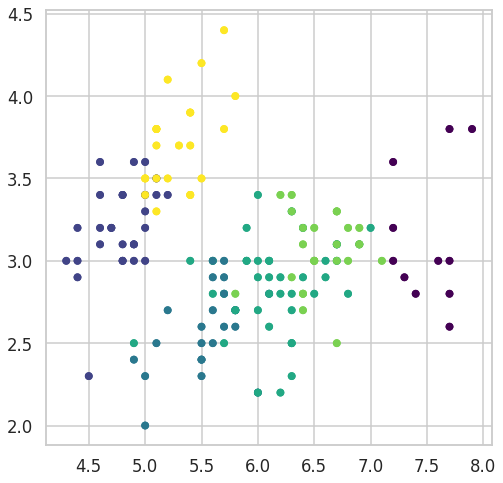

In [ ]:
#gmm using diag
from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='diag').fit(iris_data.data)
labels = gmm.predict(iris_data.data)
plt.scatter(iris_data.data[:, 0], iris_data.data[:, 1], c=labels, s=40, cmap='viridis');
plt.scatter(iris_data.data[:, 0],iris_data.data[:, 1], c=labels, s=40, cmap='viridis');
probs = gmm.predict_proba(iris_data.data)
print(probs[:5].round(3))

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

In [ ]:
df = pd.DataFrame(data=(iris_data).data)
df.head()

,0,1,2,3
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


## Customer dataset
Repeat all the above on the customer data set 

In [ ]:
from google.colab import drive 
drive.mount('/content/gdrive')
import pandas as pd 
data=pd.read_csv('gdrive/My Drive/Customer data.csv')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
data.head()

,ID,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,100000001,0,0,67,2,124670,1,2
1,100000002,1,1,22,1,150773,1,2
2,100000003,0,0,49,1,89210,0,0
3,100000004,0,0,45,1,171565,1,1
4,100000005,0,0,53,1,149031,1,1


In [ ]:
data = pd.read_csv('gdrive/My Drive/Customer data.csv',usecols=['Age','Income'])


In [ ]:
from sklearn.preprocessing import StandardScaler,MinMaxScaler ,MaxAbsScaler
scaler = MaxAbsScaler()
scaler.fit(data)
data_scaled = scaler.transform(data)
data_scaled = pd.DataFrame(data_scaled, columns=data.columns)
data_scaled.head()

,Age,Income
0,0.881579,0.402988
1,0.289474,0.487364
2,0.644737,0.288366
3,0.592105,0.554573
4,0.697368,0.481733


In [ ]:
X_data = data_scaled.iloc[:, [0, 1]].values
X_data

array([[0.88157895, 0.40298807],
       [0.28947368, 0.4873644 ],
       [0.64473684, 0.28836581],
       ...,
       [0.40789474, 0.27928266],
       [0.31578947, 0.3166755 ],
       [0.32894737, 0.22115049]])

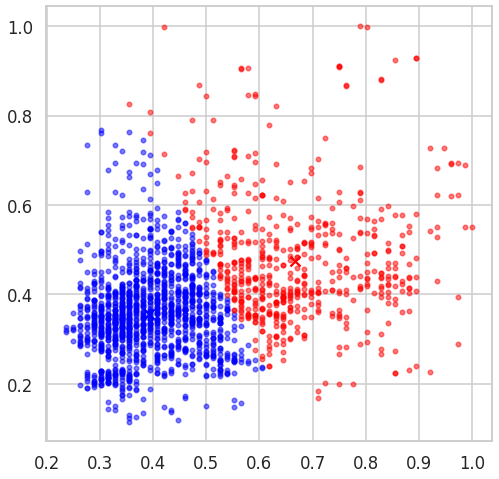

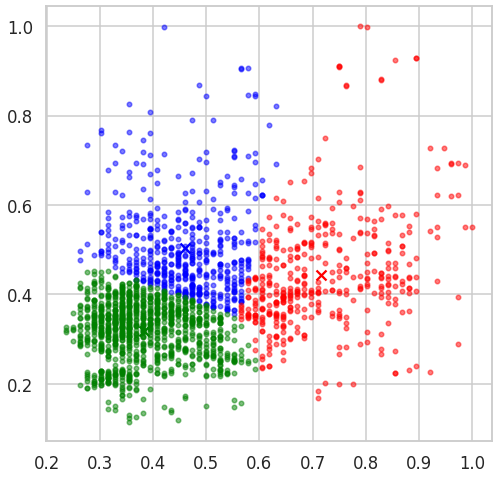

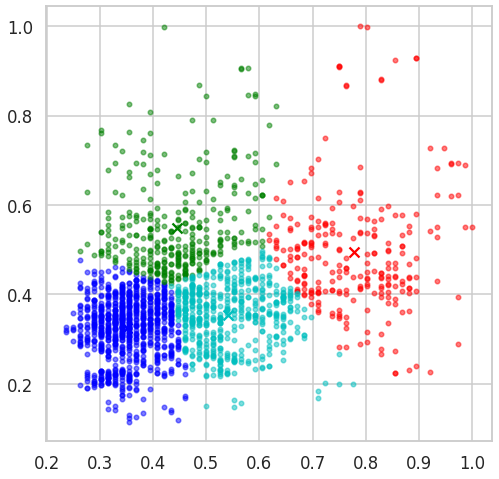

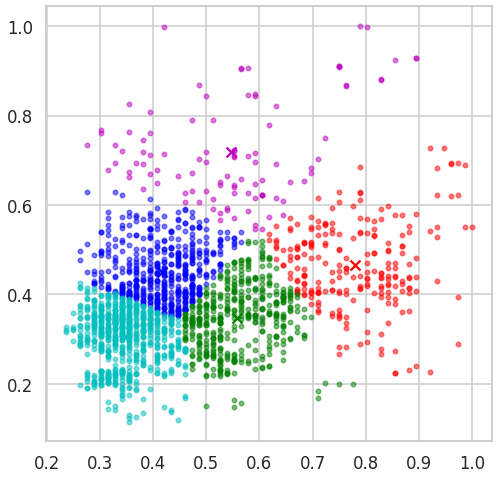

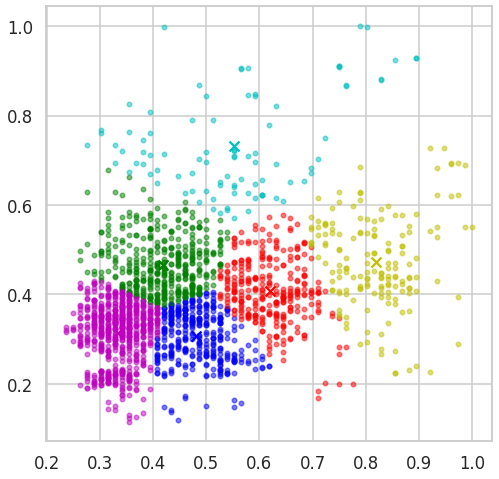

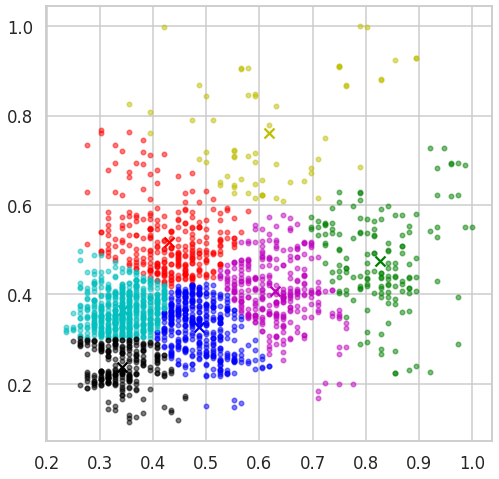

In [ ]:
for i in range (2,8):
 kmeans = KMeans(i)
 kmeans.fit(X_data.copy())
 display_cluster(X_data,kmeans,num_clusters=i)  
 plt.show()

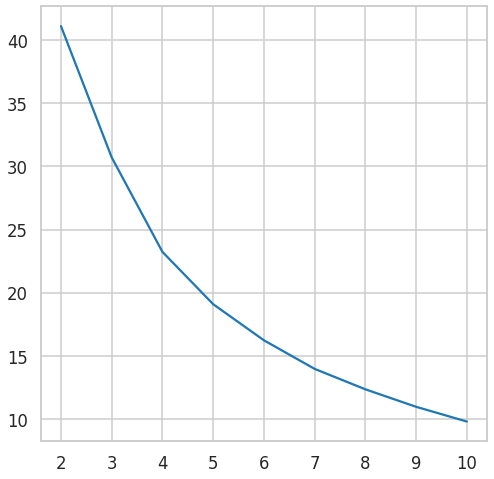

In [ ]:
#plotting distortion function
distortions = []
for i in range (2,11):
 kmeans = KMeans(i)
 kmeans.fit(X_data.copy())
 distortion_i = kmeans.inertia_
 distortions.append(distortion_i)
values_k = range (2,11)
plt.plot(values_k,distortions)
plt.show()  

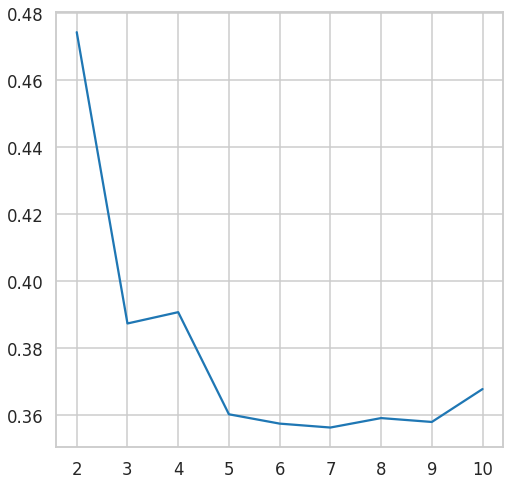

In [ ]:
#Ploting the silhouette_score
scores=[]
for i in range (2,11):
 kmeans = KMeans(i)
 kmeans.fit(X_data.copy())
 clusters =   kmeans.fit_predict(X_data) 
 scores.append(silhouette_score(X_data, clusters , metric='euclidean'))
values_k = range (2,11)
plt.plot(values_k,scores)
plt.show()  

In [ ]:
#The best k is equal to 3 from elbow method and silhouette_score
kmeans = KMeans(3)
kmeans.fit(X_data.copy())
scores_best_k_kmeans = (silhouette_score(X_data, kmeans.labels_, metric='euclidean'))
scores_best_k_kmeans

0.38821984793249065

In [ ]:
#the best k is equal to 4 from elbow method and silhouette_score
kmeans = KMeans(4)
kmeans.fit(X_data.copy())
scores_best_k_kmeans = (silhouette_score(X_data, kmeans.labels_, metric='euclidean'))
scores_best_k_kmeans

0.39082117822778883

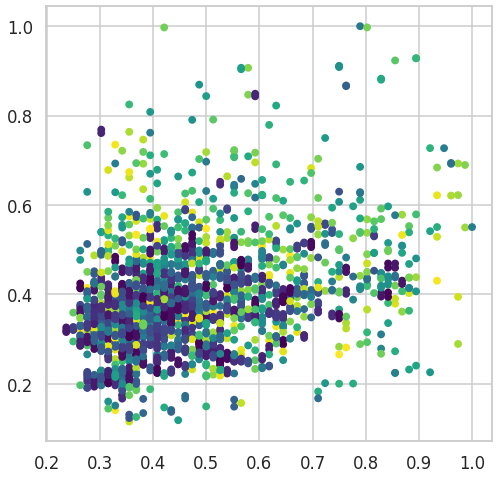

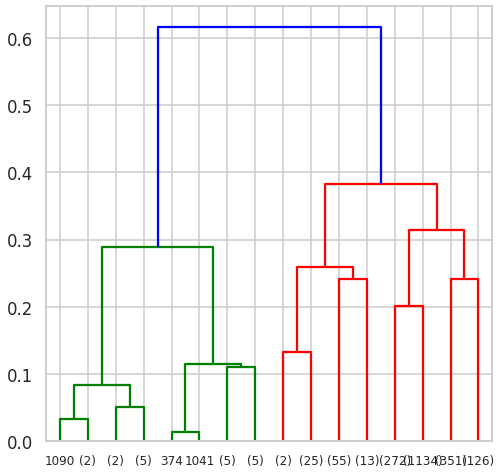

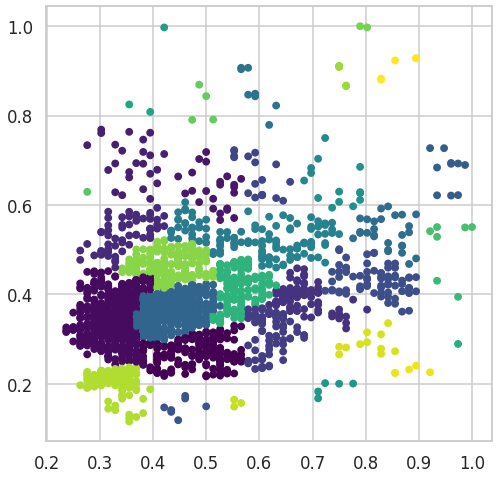

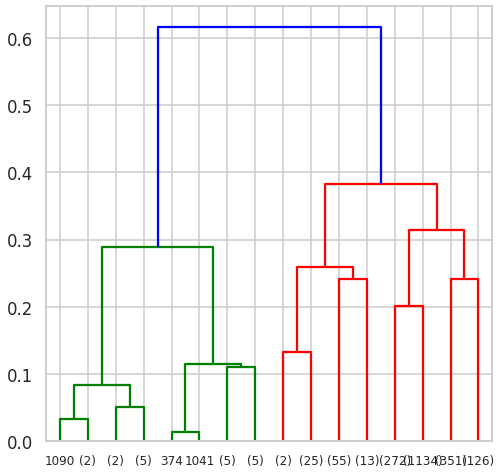

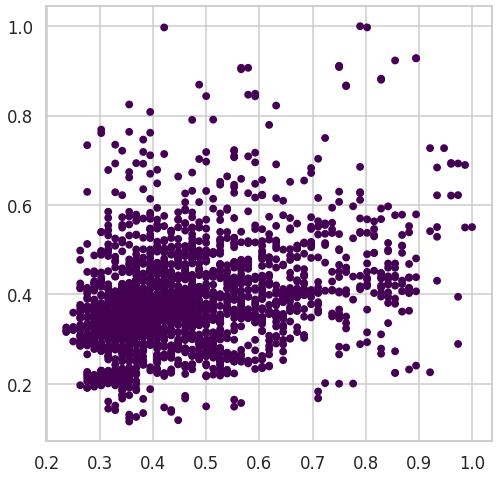

...

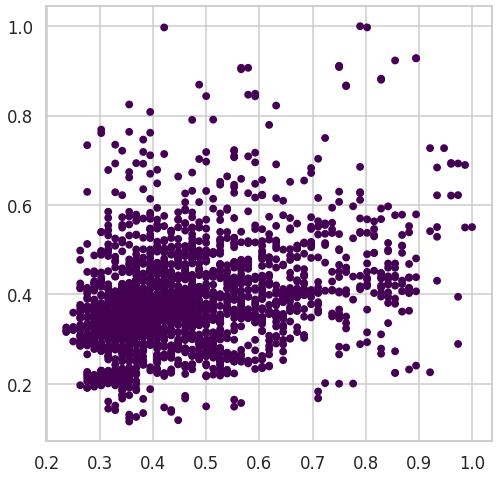

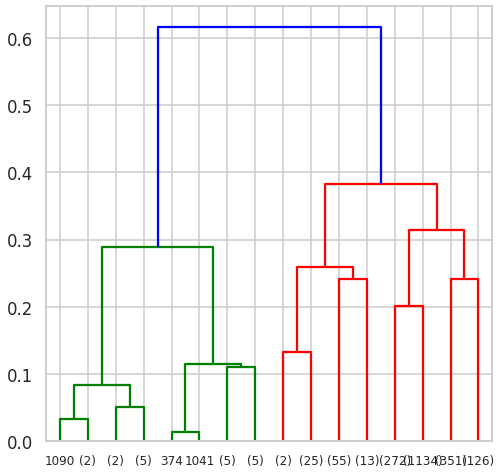

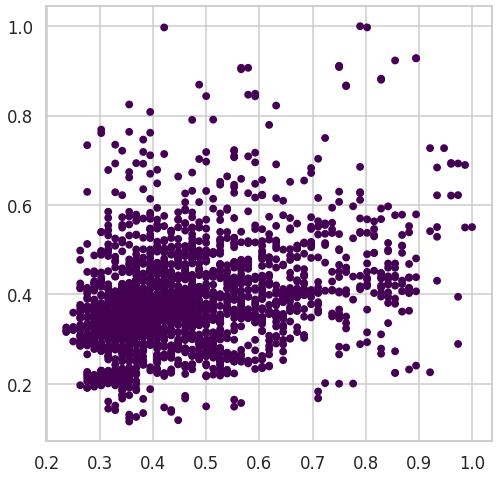

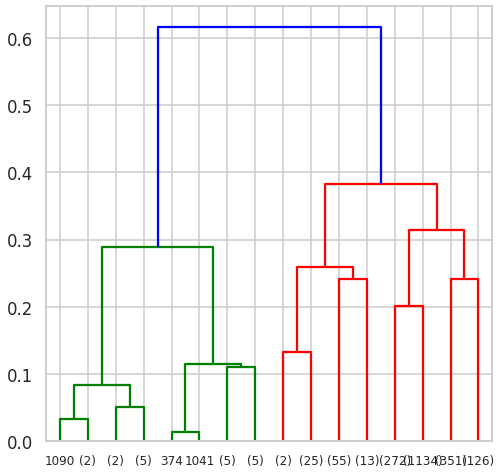

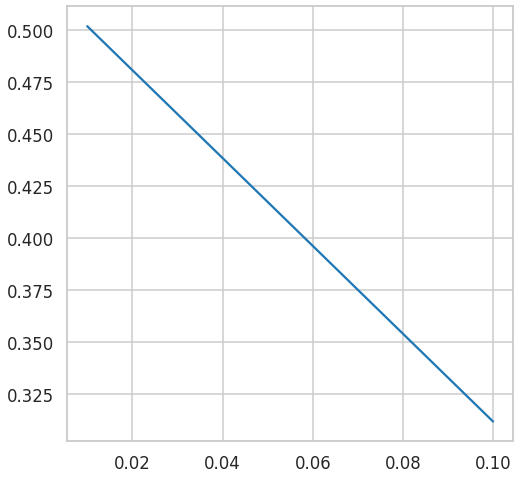

[0.5017294406889368]

In [ ]:
#Hirchary
all_scores=[]
distances=[0.01,0.1,1,5,6,7,9,10]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(X_data.copy())
  plt.scatter(X_data[:, 0], X_data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(X_data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

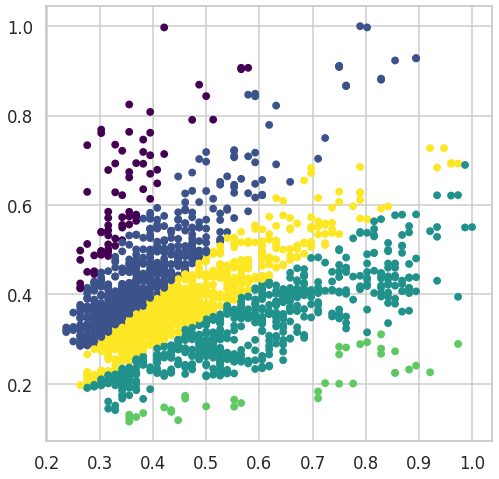

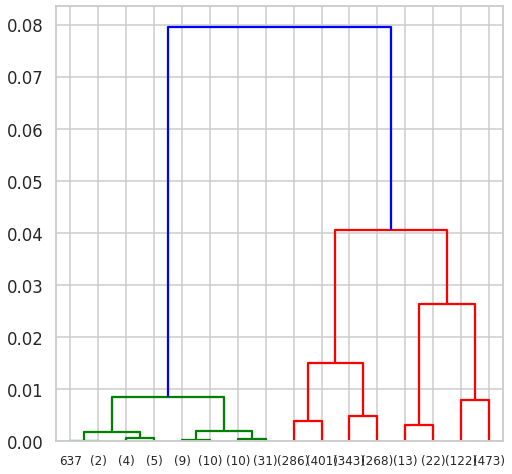

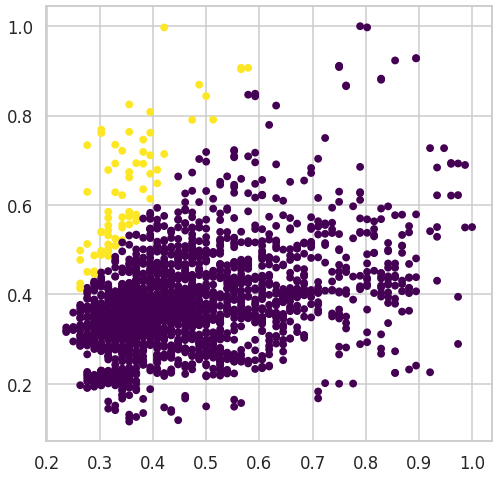

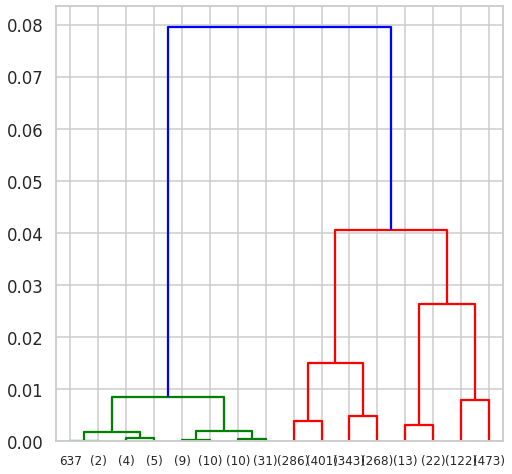

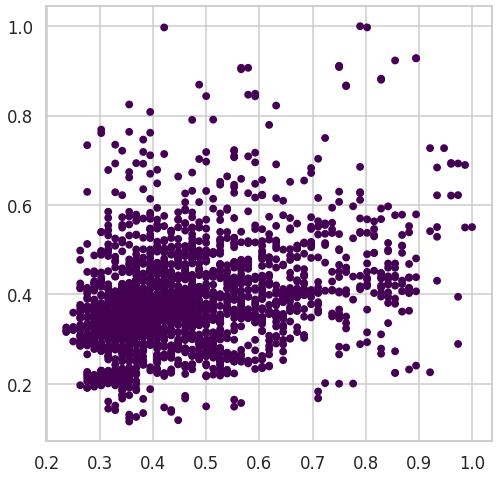

...

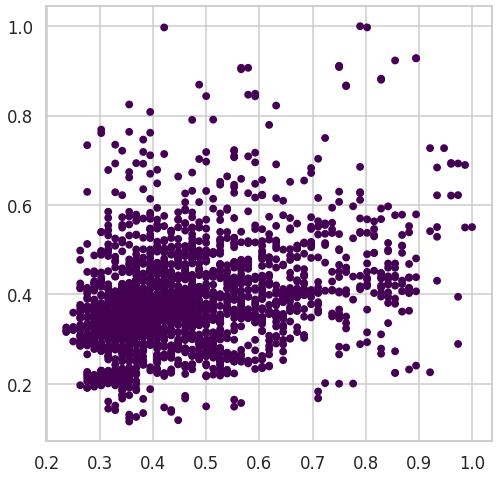

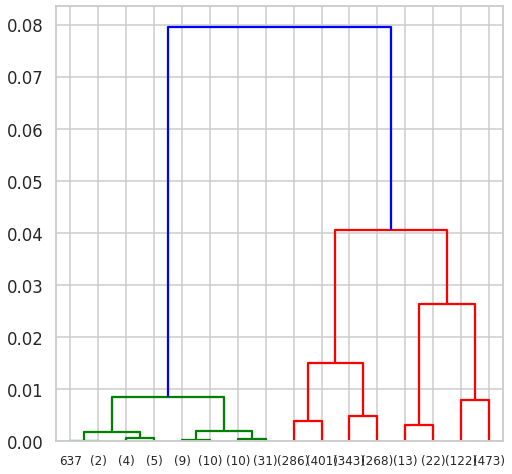

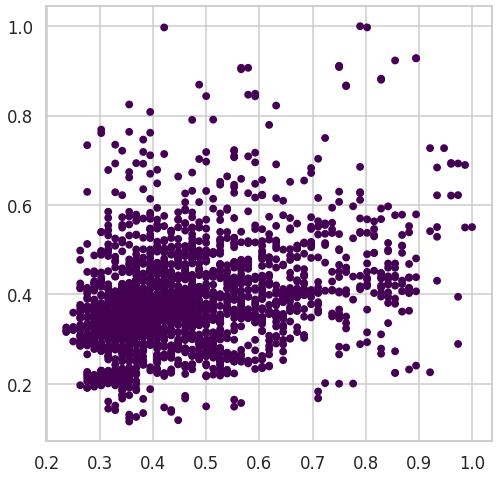

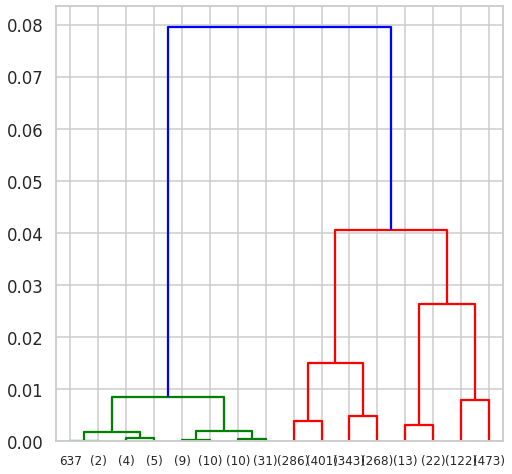

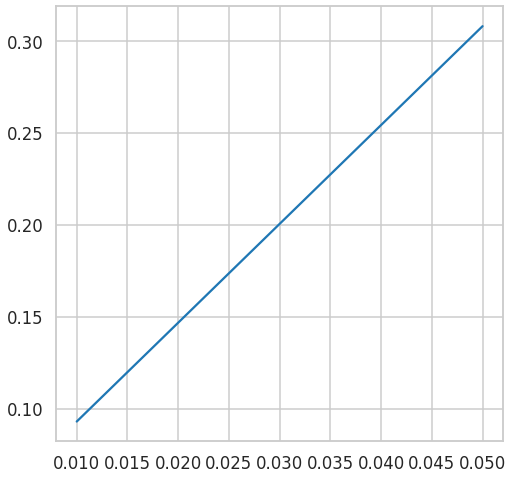

[0.5017294406889368, 0.5807809409848368, 0.575196906014571, 0.3079210674257166]

In [ ]:
distances=[0.01,0.05,0.1,0.2,0.3,0.5,1,2,5,8,9]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='cosine', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(X_data.copy())
  plt.scatter(X_data[:, 0], X_data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(X_data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

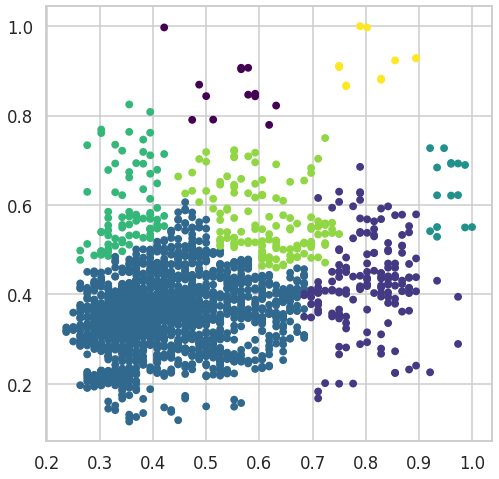

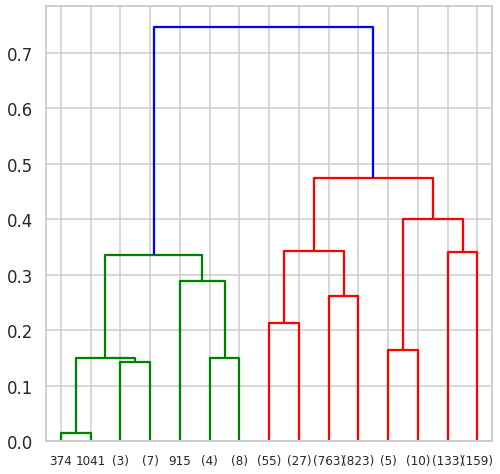

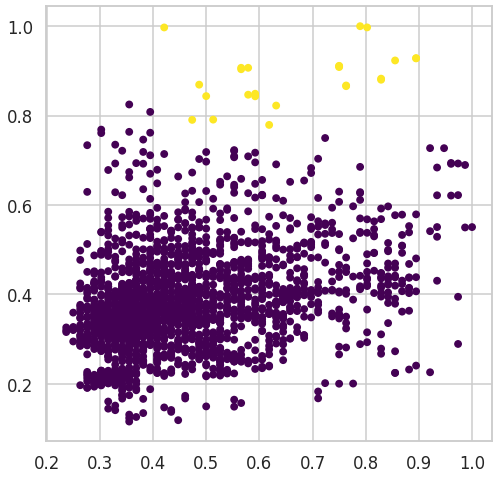

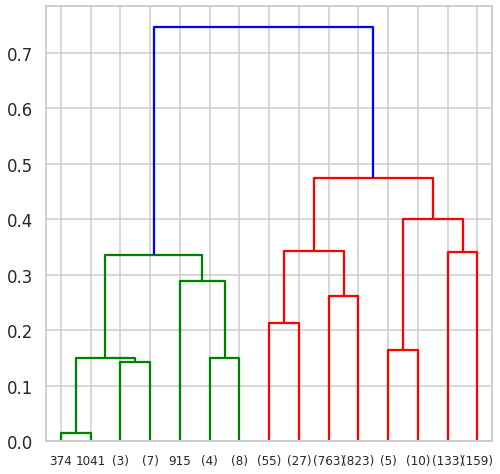

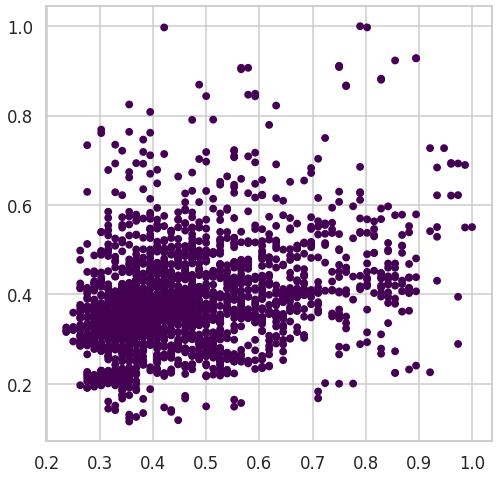

...

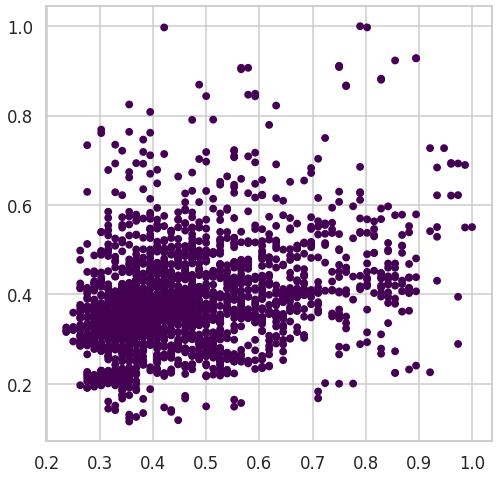

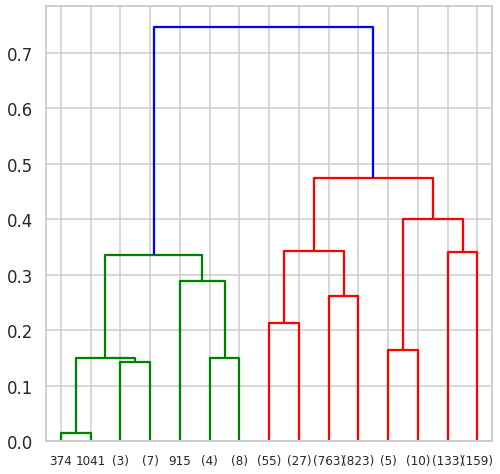

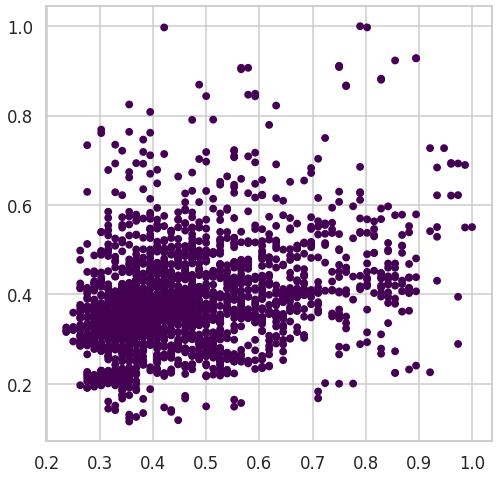

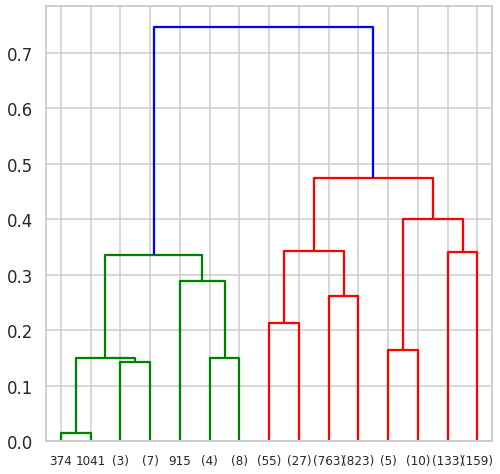

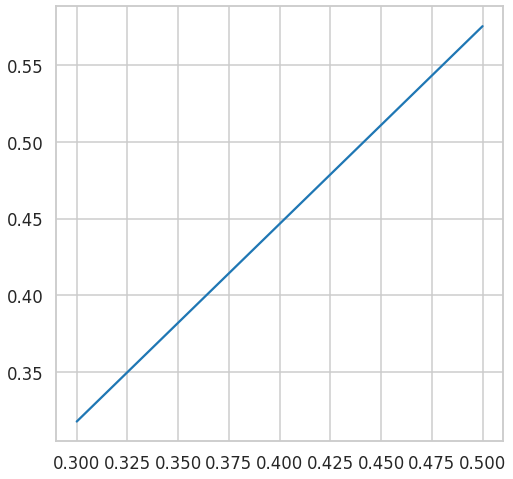

[0.5017294406889368, 0.5807809409848368, 0.575196906014571]

In [ ]:
distances=[0.3,0.5,1,2,5,8,9,10,11,12,13]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='manhattan', linkage='average', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(X_data.copy())
  plt.scatter(X_data[:, 0], X_data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(X_data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

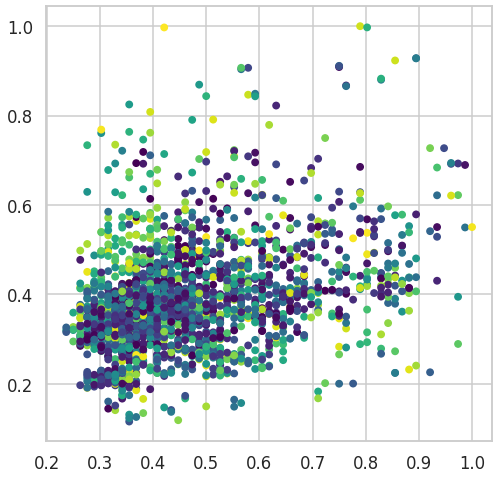

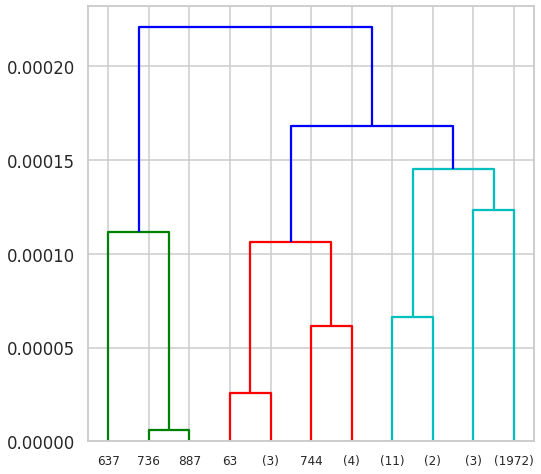

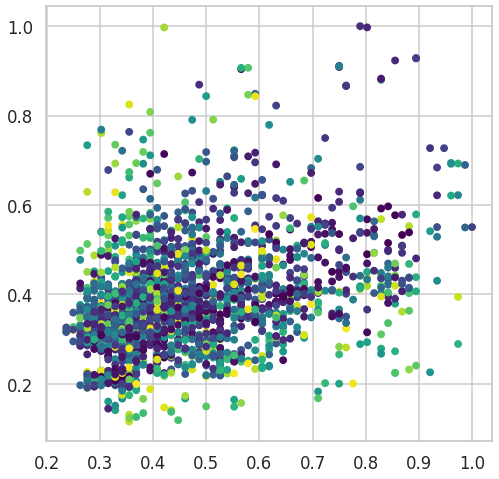

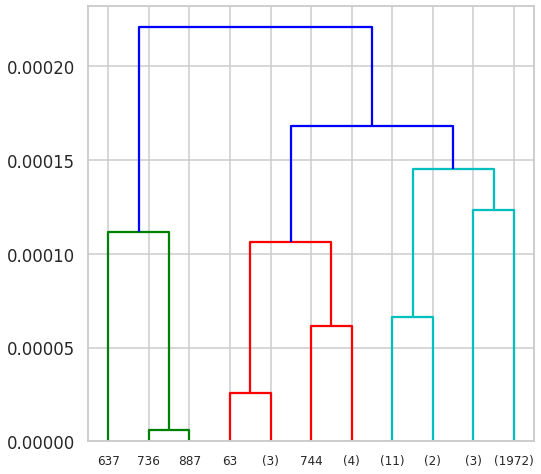

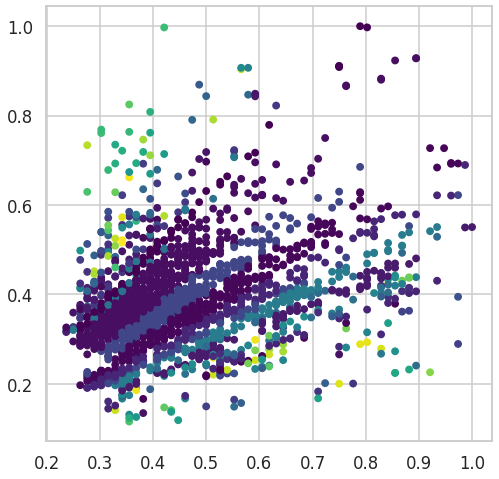

...

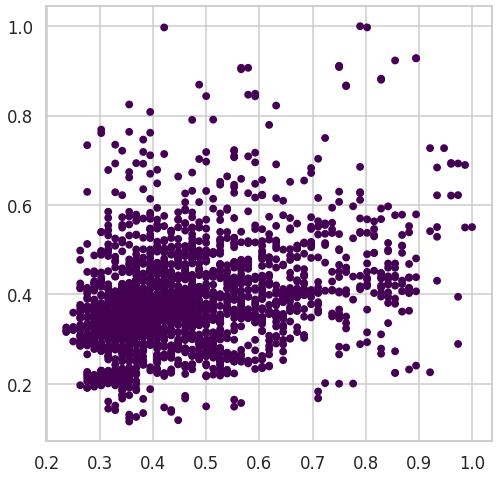

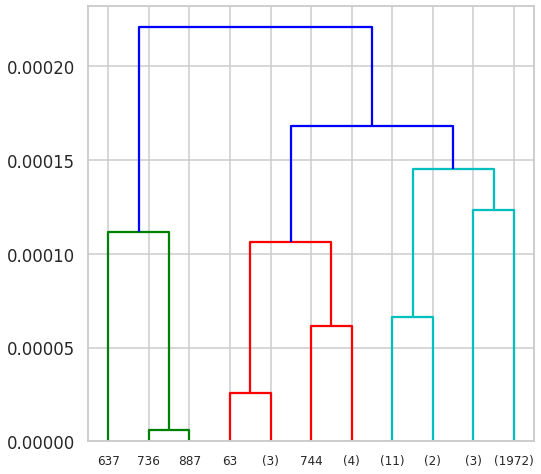

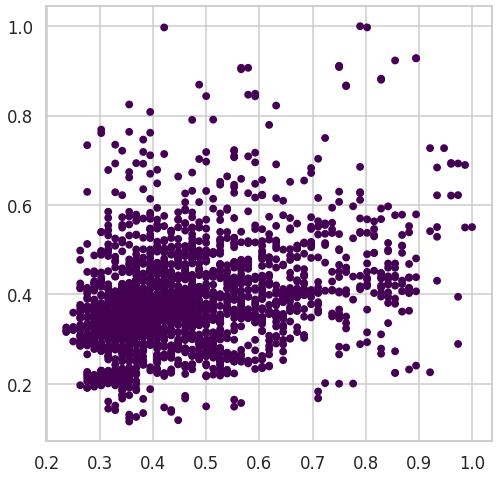

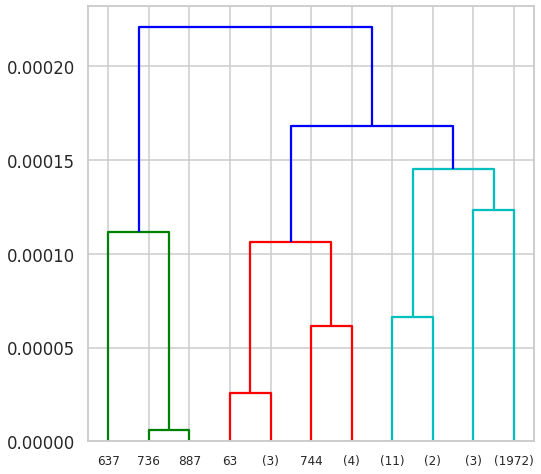

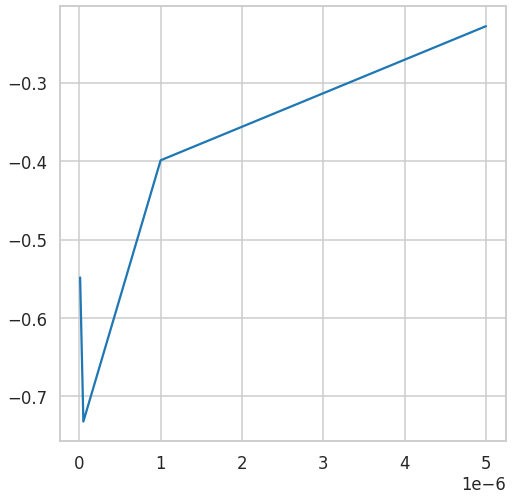

[0.5017294406889368,
 0.5807809409848368,
 0.575196906014571,
 0.3079210674257166,
 -0.13152982001637645,
 -0.22800515208107475]

In [ ]:
distances=[0.00000001,0.00000005,0.000001,0.000005,0.2,0.3,0.5,1,2,5,8,9]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='cosine', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(X_data.copy())
  plt.scatter(X_data[:, 0], X_data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(X_data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

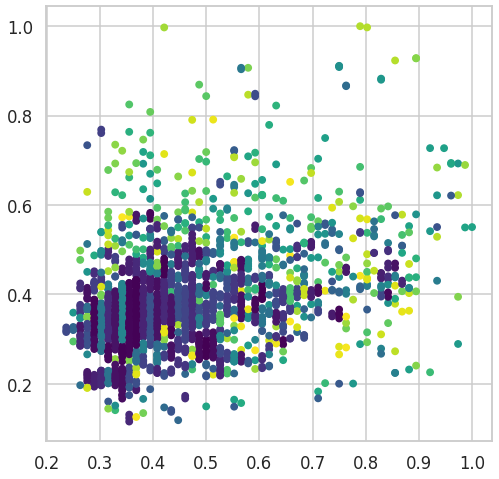

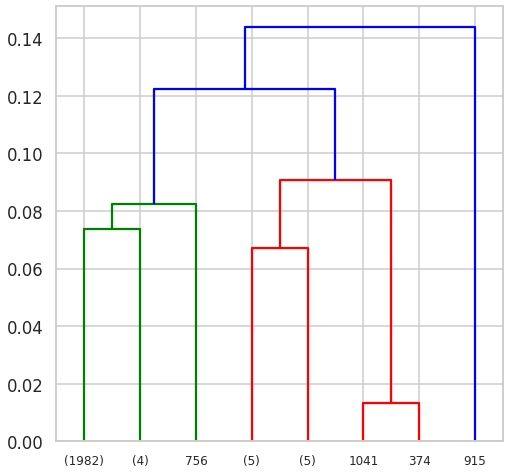

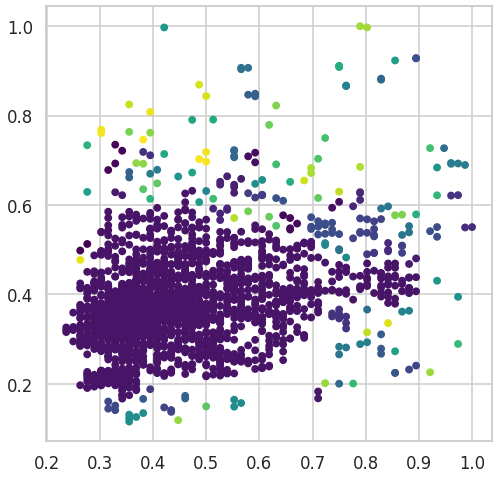

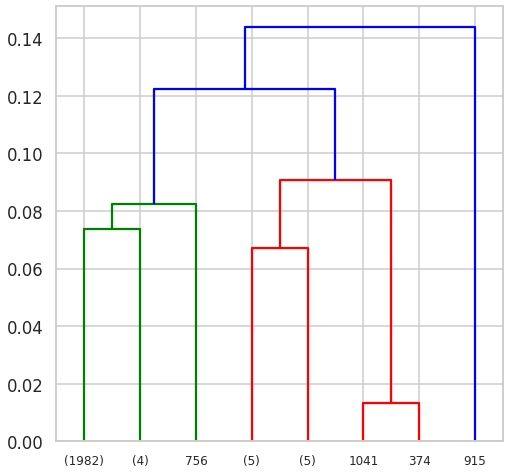

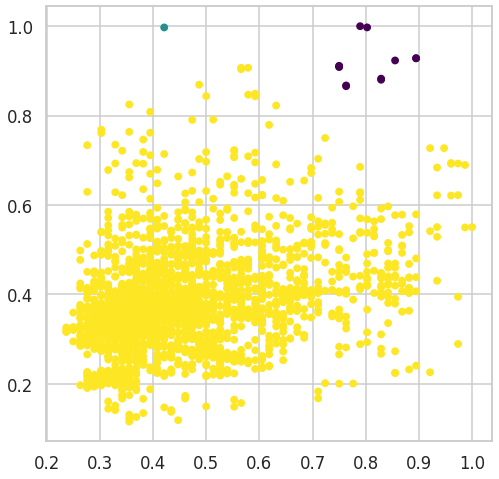

...

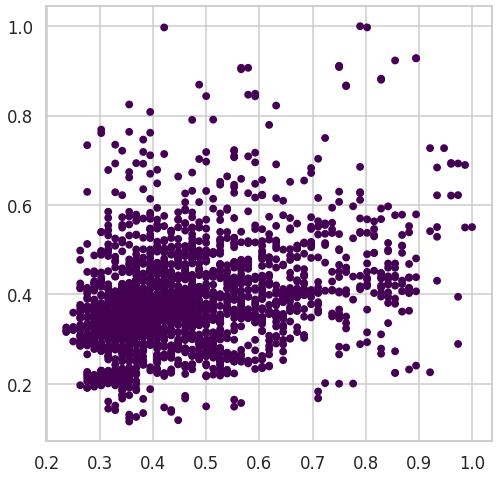

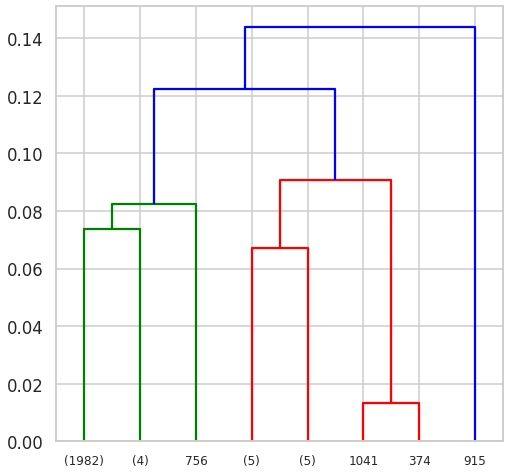

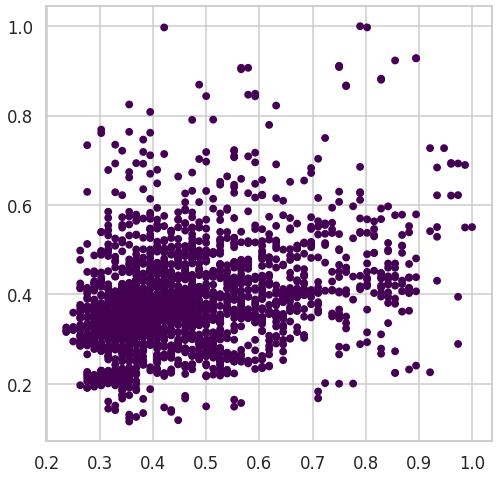

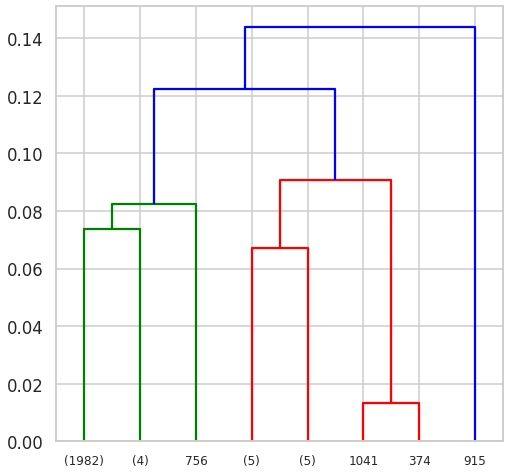

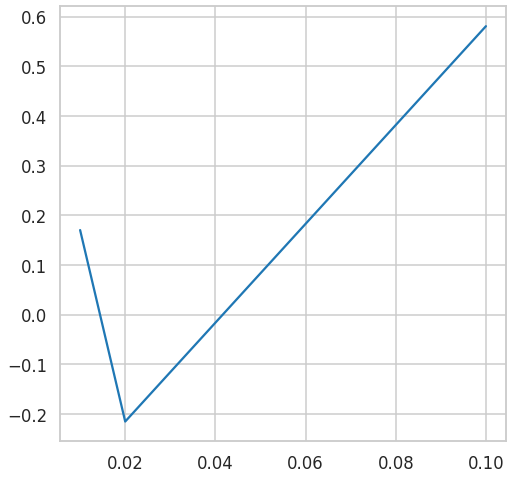

[0.5017294406889368, 0.5807809409848368]

In [ ]:
distances=[0.01,0.02,0.1,0.3,0.5,1,2,3,5,6]
scores=[]
dis_plot=[]
for d in distances:
  Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='single', distance_threshold= d)
  hc = Hierarchal_Clustering.fit(X_data.copy())
  plt.scatter(X_data[:, 0], X_data[:, 1], c=hc.labels_, s=40, cmap='viridis');
  plt.show()
  plot_dendrogram(hc,truncate_mode="level", p=3)
  plt.show()
  if(np.unique(hc.labels_).shape[0] > 1):
     scores.append( silhouette_score(X_data, hc.labels_ , metric='euclidean') )
     dis_plot.append(d)
all_scores.append(max(scores))    
plt.plot(dis_plot,scores)
plt.show()      
all_scores

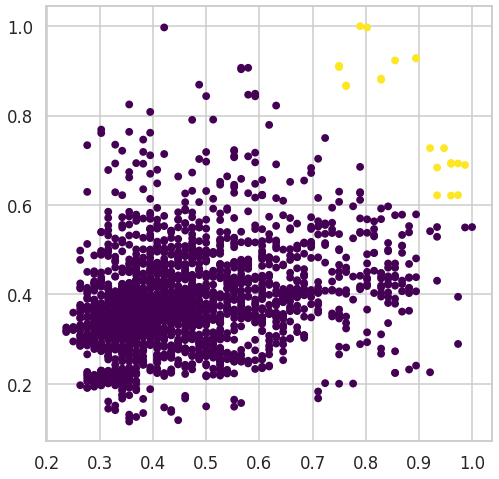

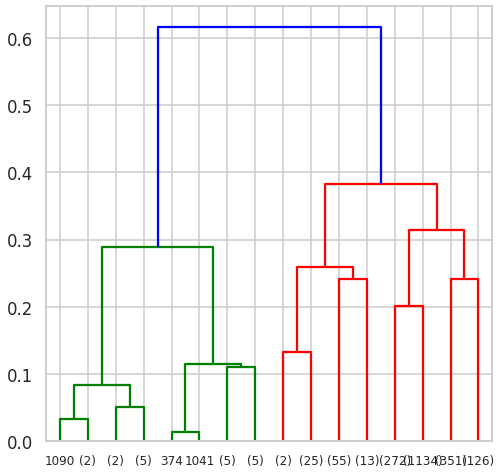

0.5920539914014232

In [ ]:
#best parameters are ecuilidian,average,distance_threshold=7
Hierarchal_Clustering=AgglomerativeClustering(n_clusters = None, affinity='euclidean', linkage='average', distance_threshold= 0.6)
hc = Hierarchal_Clustering.fit(X_data.copy())
plt.scatter(X_data[:, 0], X_data[:, 1], c=hc.labels_, s=40, cmap='viridis');
plt.show()
plot_dendrogram(hc,truncate_mode="level", p=3)
plt.show()
max_score= silhouette_score(X_data, hc.labels_ , metric='euclidean')  
  
max_score

Min_sample 5


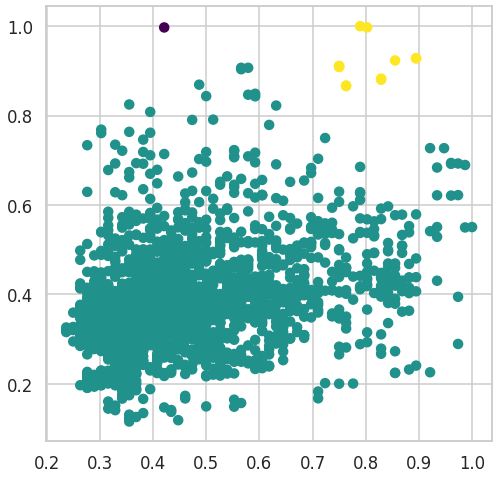

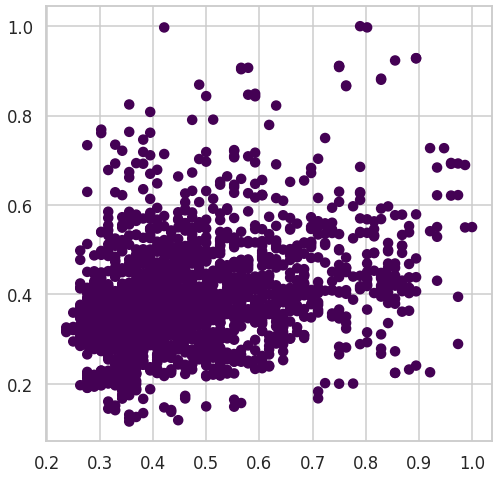

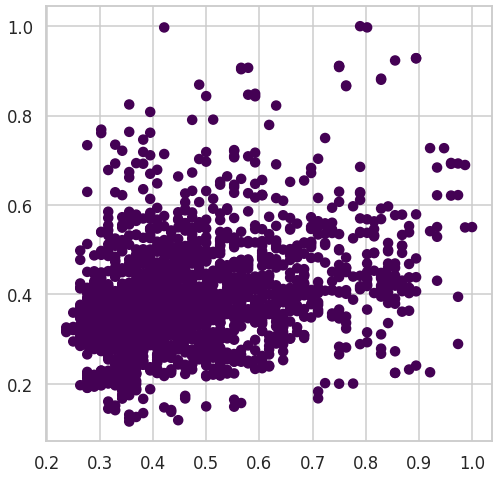

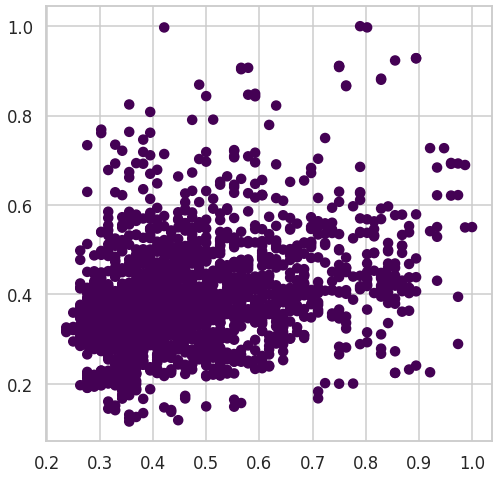

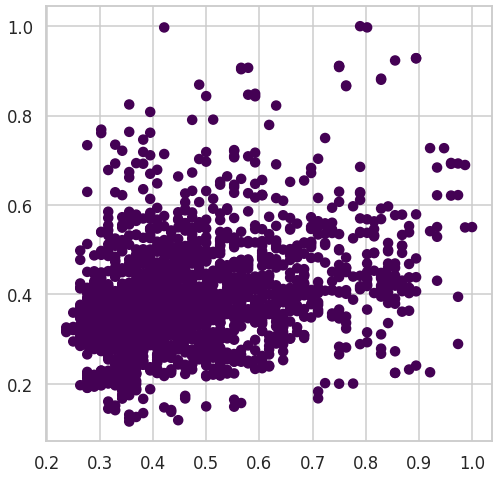

...

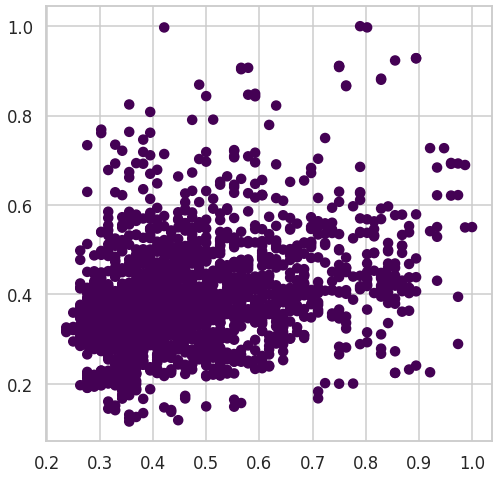

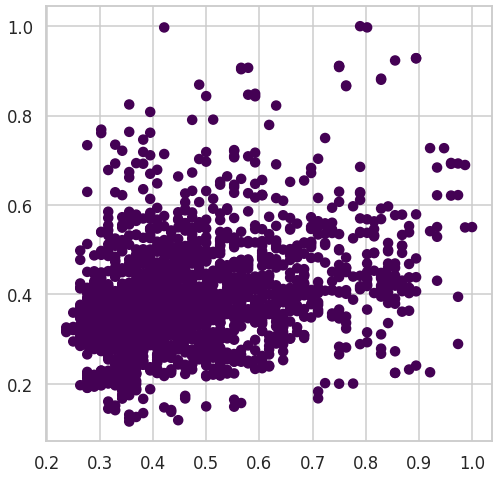

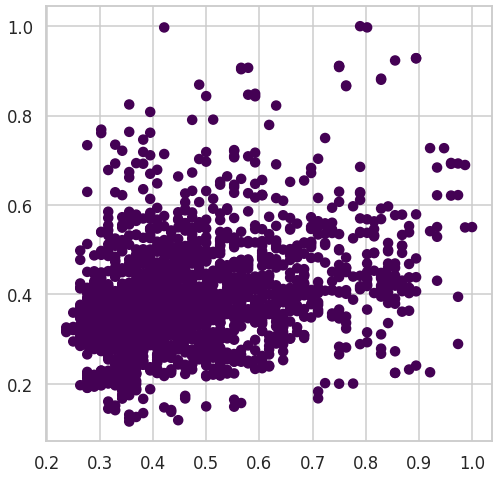

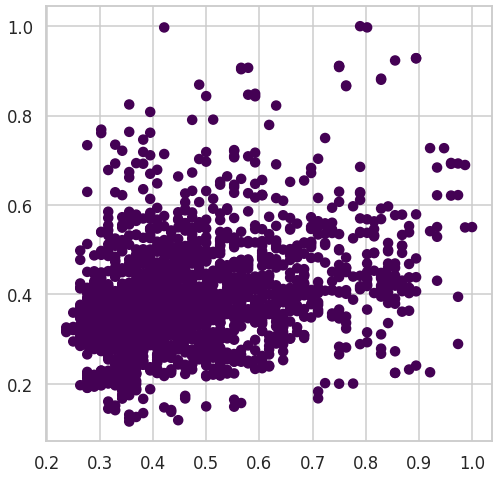

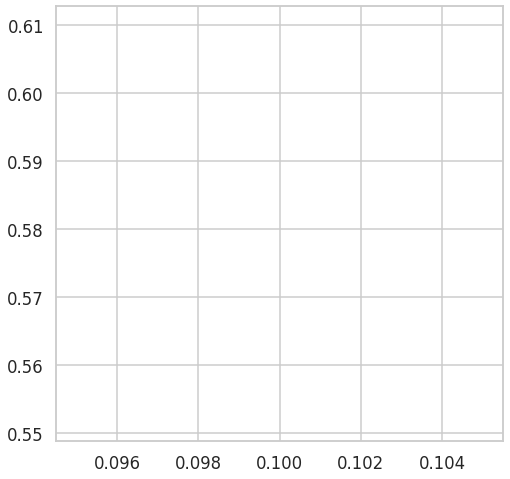

0.5807809409848368
Min_sample 10


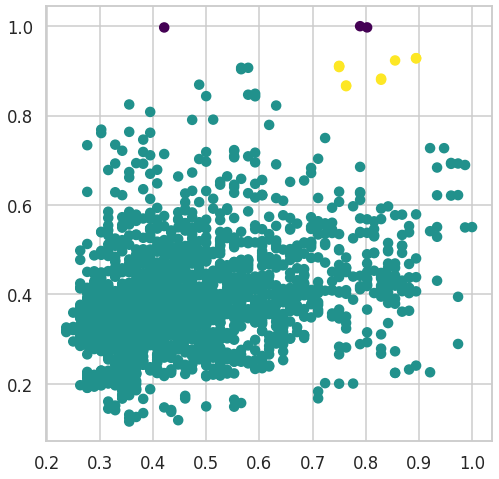

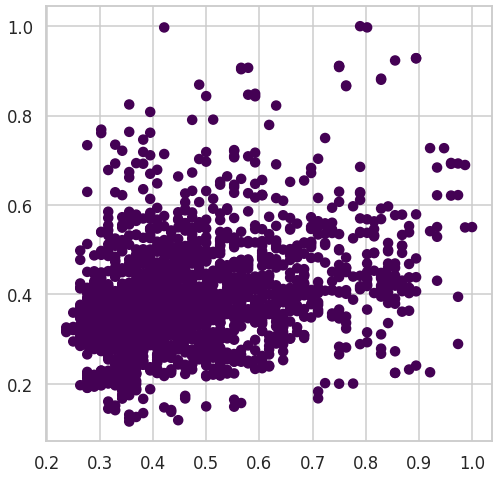

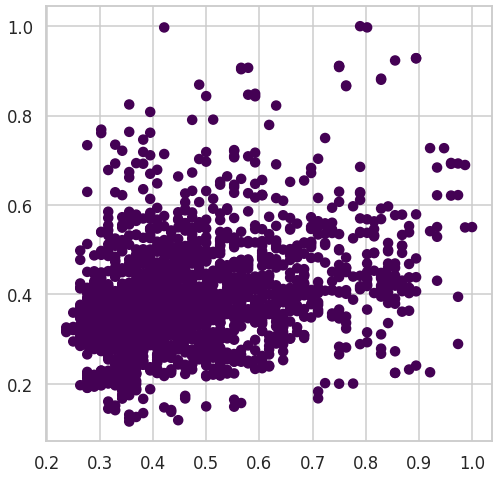

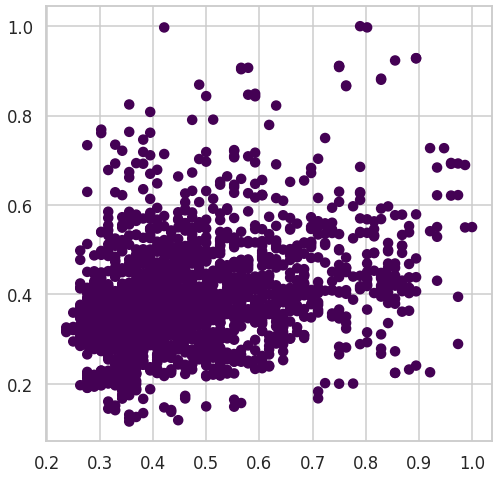

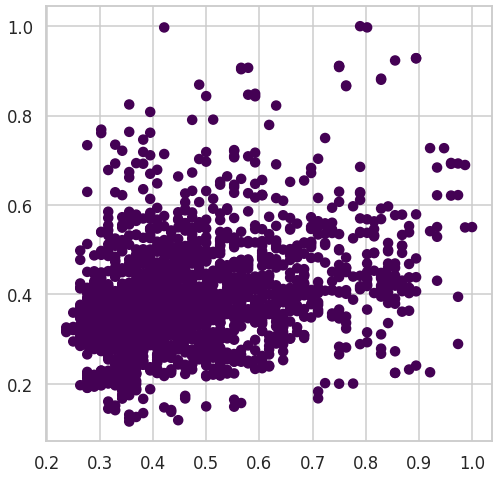

...

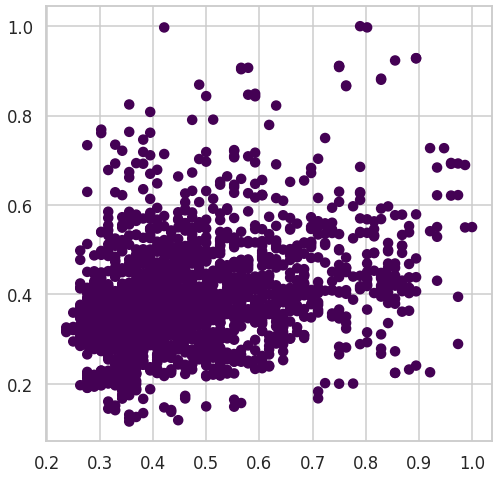

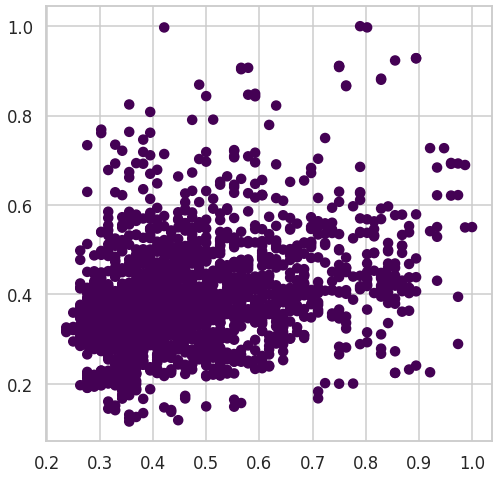

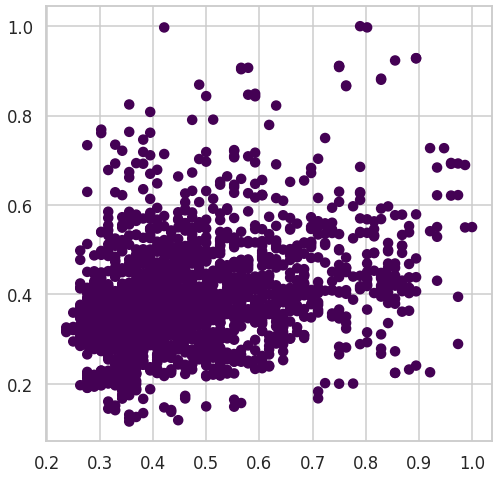

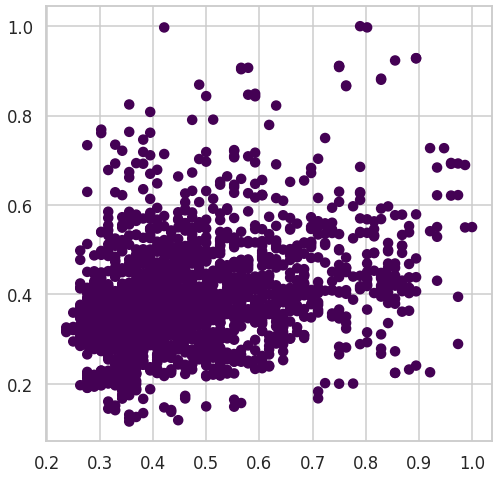

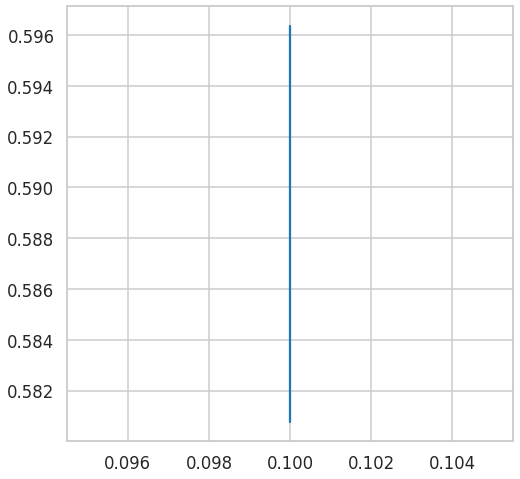

0.5963436734974734
Min_sample 15


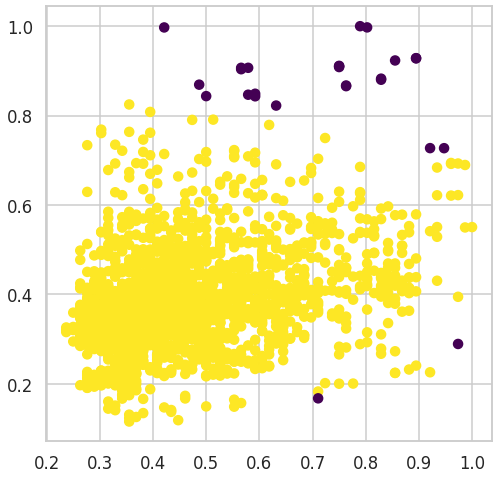

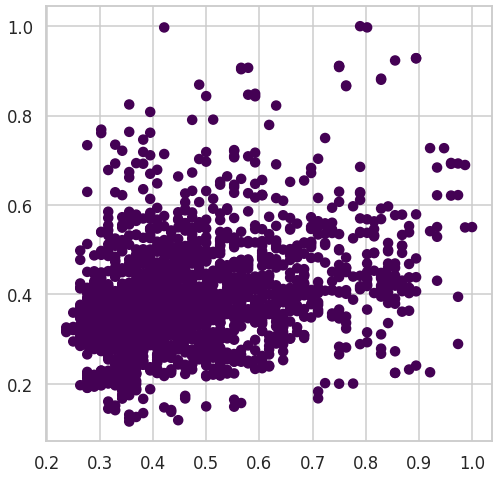

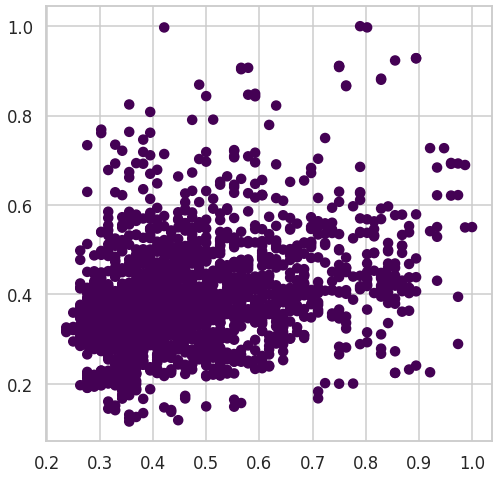

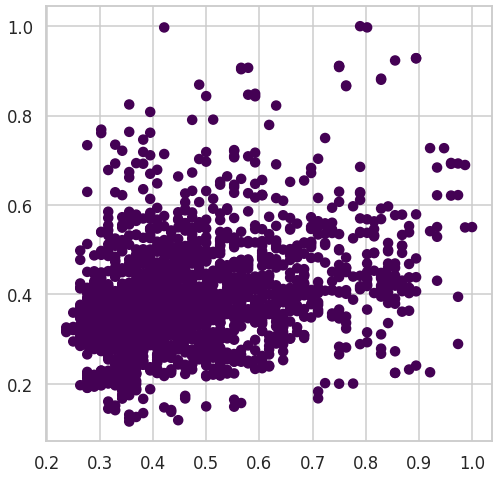

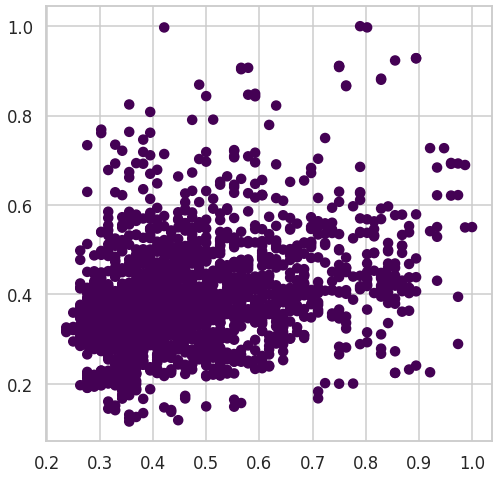

...

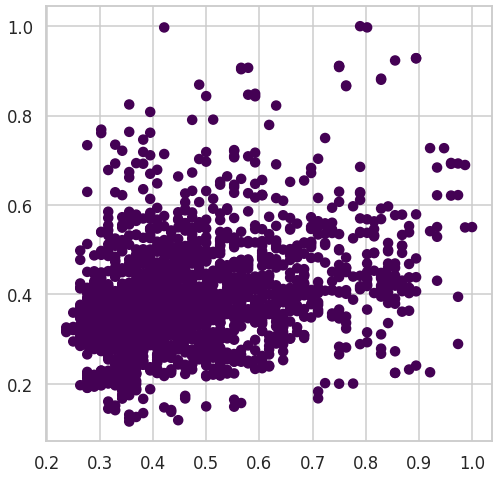

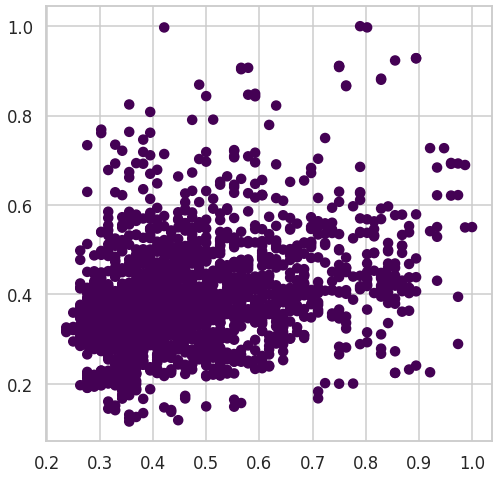

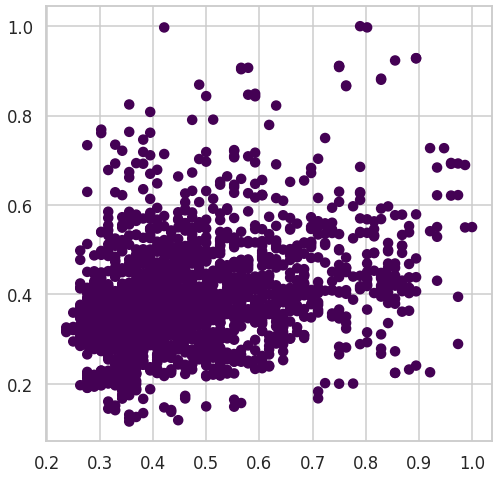

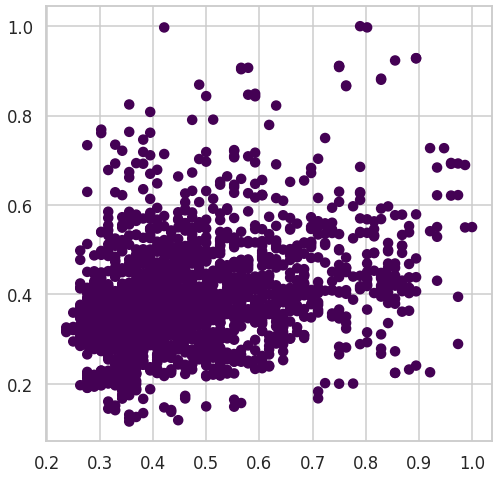

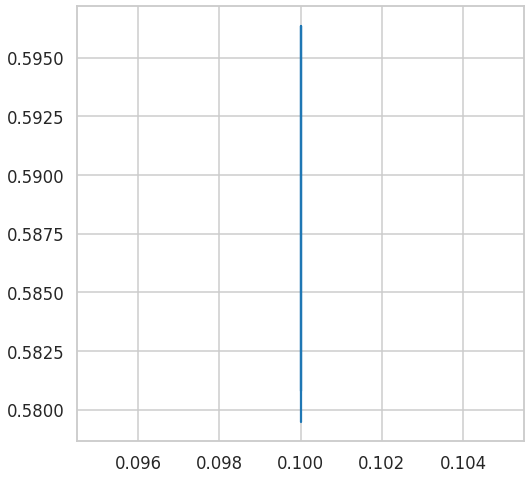

0.5963436734974734
Min_sample 20


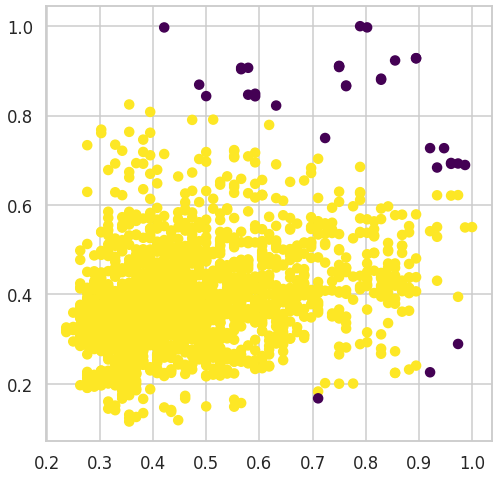

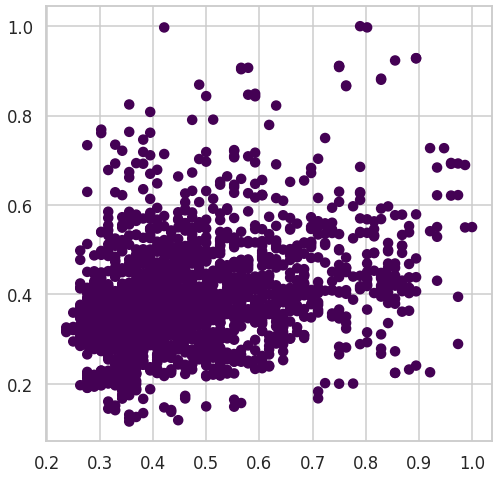

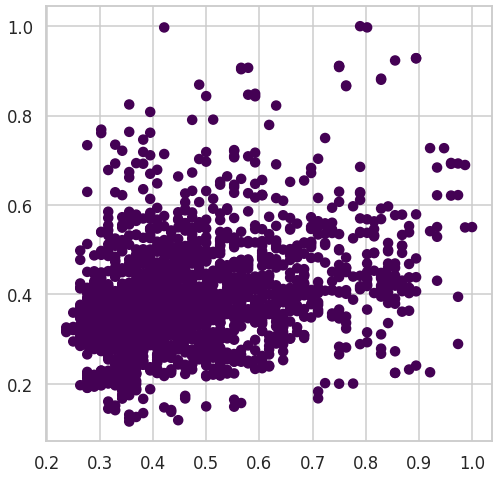

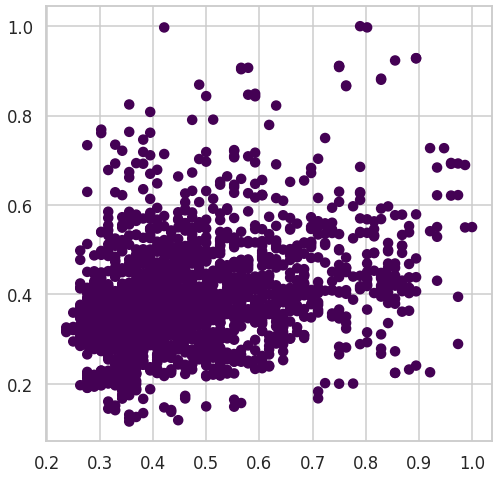

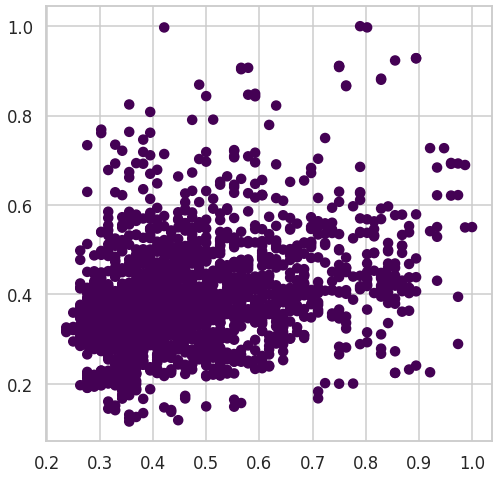

...

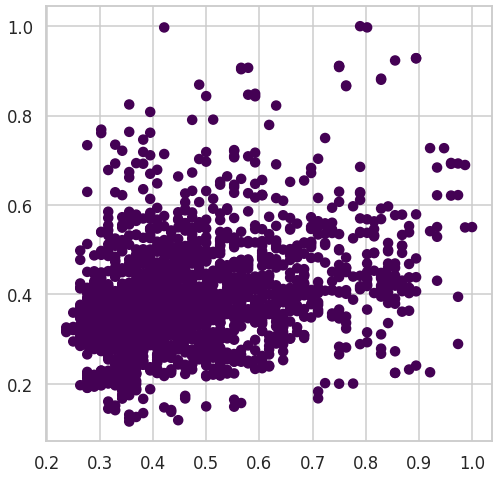

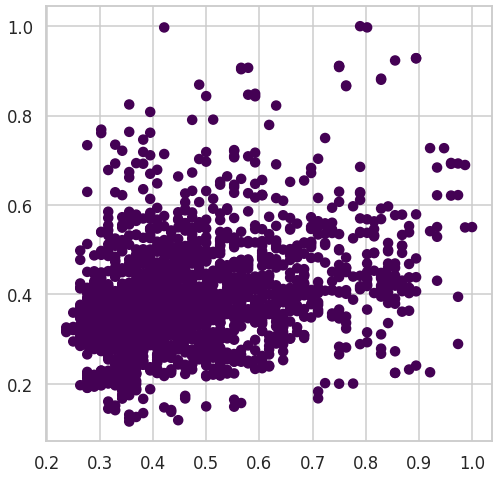

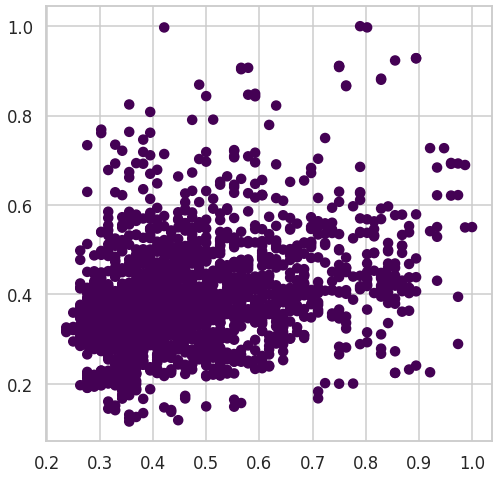

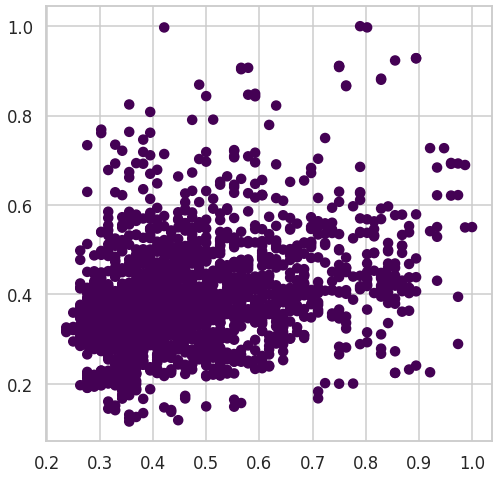

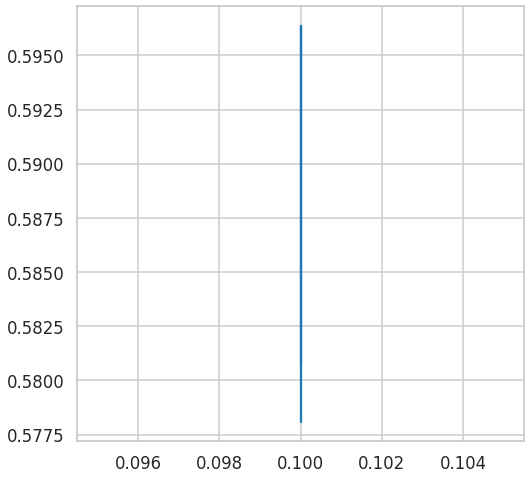

0.5963436734974734
Min_sample 25


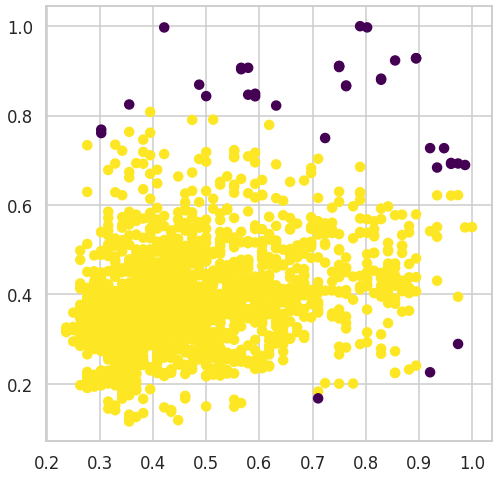

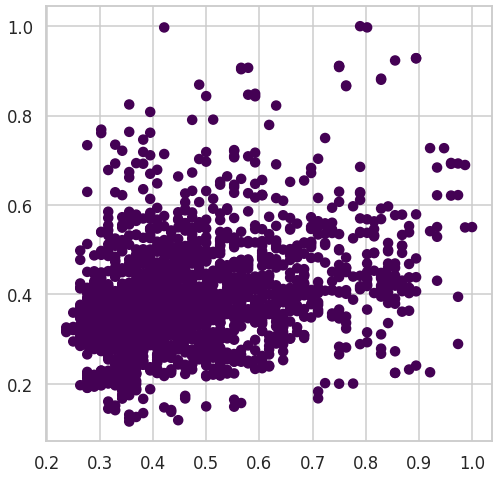

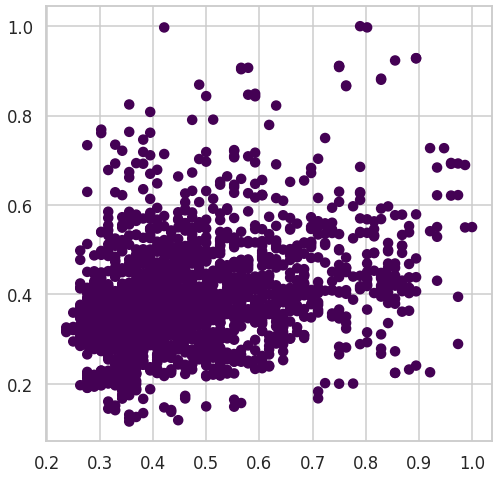

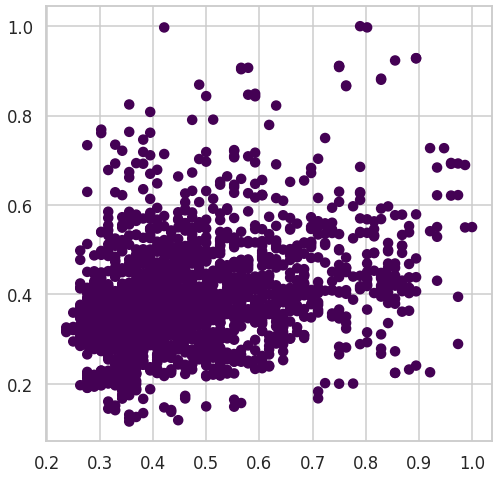

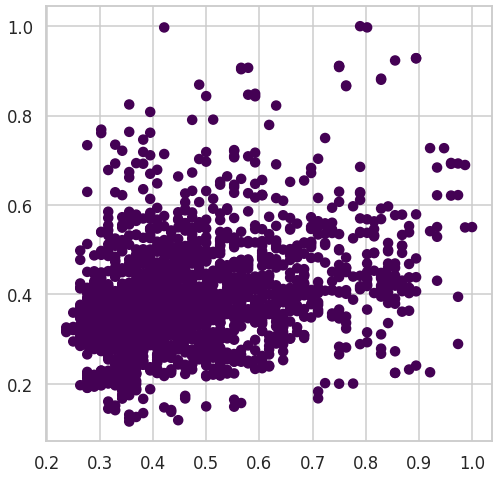

...

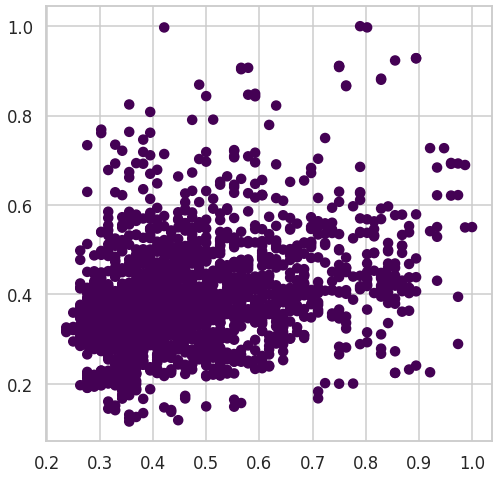

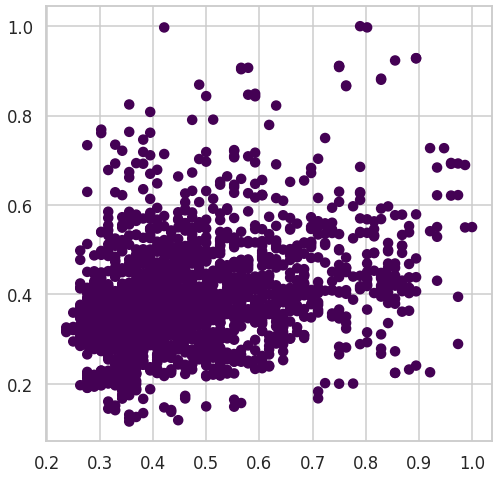

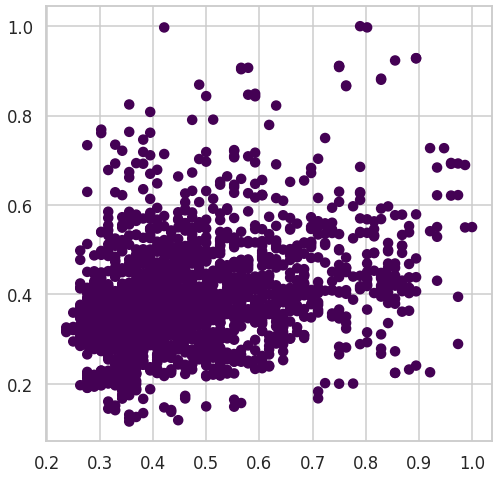

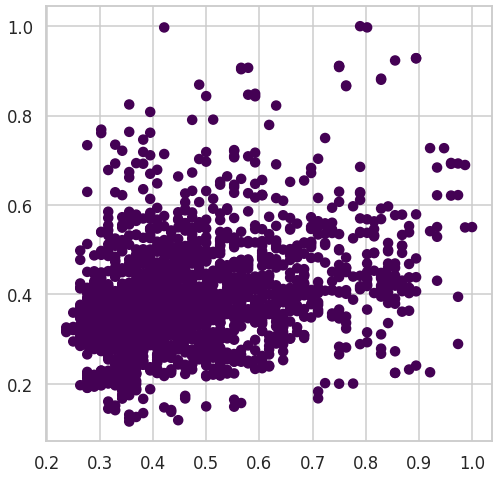

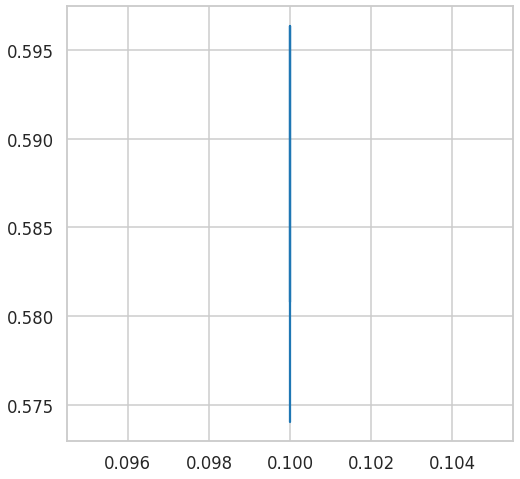

0.5963436734974734


In [305]:
#DBS
# changing values of EBS
Max_silhouette= []
EPS = [0.1,0.3,0.5,0.7,0.9,1.1,1.3,1.5,1.7,1.9,2.1,2.3,2.5,2.7,3]
Min_samples = [5,10,15,20,25]
scores=[]
ebs_val=[]
for i in Min_samples:
    print("Min_sample",i)
    for j in EPS:
       DBS = DBSCAN(eps = j , min_samples = i).fit(X_data.copy())
       clusters = DBS.fit_predict(X_data.copy())
       plt.scatter(X_data[:, 0], X_data[:, 1], c=clusters, cmap="viridis")
       plt.show() 
       if(np.unique(DBS.labels_).shape[0] > 1):
         scores.append(silhouette_score(X_data, DBS.labels_ , metric='euclidean'))
         ebs_val.append(j)   
    plt.plot(ebs_val, scores)  
    plt.show() 
    Max_silhouette.append(max(scores))
    print(max(scores))


In [ ]:
print(max( Max_silhouette))


0.5963436734974734


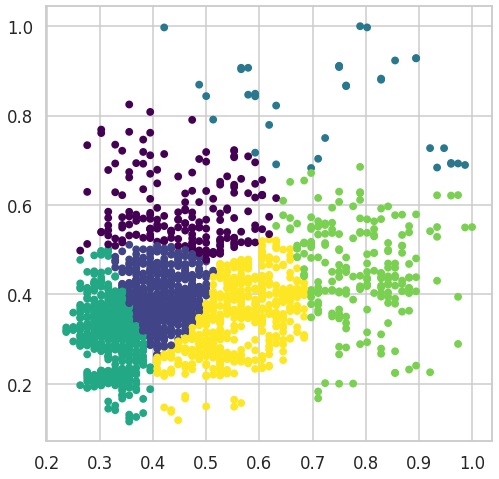

In [ ]:
#GMM

from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='full').fit(X_data.copy())
labels = gmm.predict(X_data)
plt.scatter(X_data[:, 0], X_data[:, 1], c=labels, s=40, cmap='viridis');

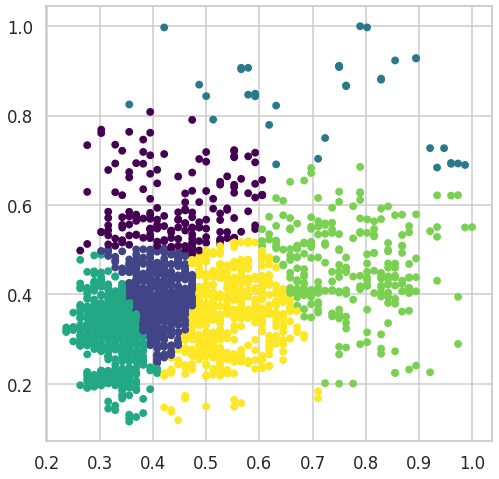

In [ ]:
#GMM

from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='diag').fit(X_data.copy())
labels = gmm.predict(X_data)
plt.scatter(X_data[:, 0], X_data[:, 1], c=labels, s=40, cmap='viridis');

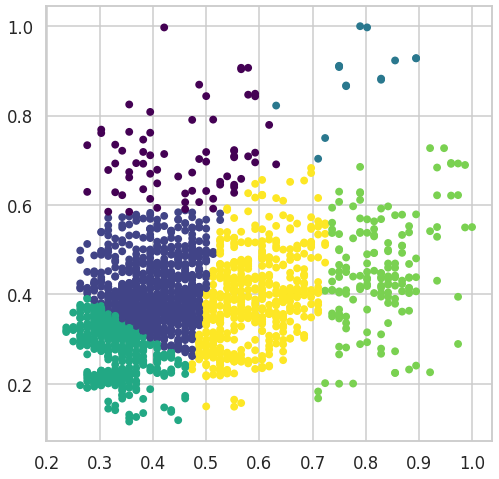

In [ ]:
#GMM

from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='tied').fit(X_data.copy())
labels = gmm.predict(X_data)
plt.scatter(X_data[:, 0], X_data[:, 1], c=labels, s=40, cmap='viridis');

[[0.    0.    0.007 0.    0.993 0.   ]
 [0.276 0.689 0.001 0.023 0.    0.012]
 [0.006 0.    0.001 0.    0.151 0.842]
 [0.563 0.001 0.035 0.    0.219 0.183]
 [0.044 0.    0.015 0.    0.82  0.122]]


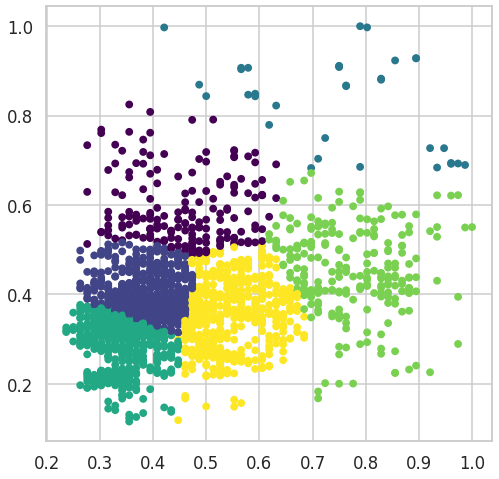

In [ ]:
#GMM

from sklearn import mixture
gmm = mixture.GaussianMixture(n_components= 6, random_state=42, covariance_type='spherical').fit(X_data.copy())
labels = gmm.predict(X_data)
plt.scatter(X_data[:, 0], X_data[:, 1], c=labels, s=40, cmap='viridis');
probs = gmm.predict_proba(X_data)
print(probs[:5].round(3))

[[0.003 0.    0.997 0.   ]
 [0.081 0.205 0.    0.713]
 [0.81  0.026 0.164 0.   ]
 [0.322 0.372 0.306 0.   ]
 [0.239 0.015 0.746 0.   ]]


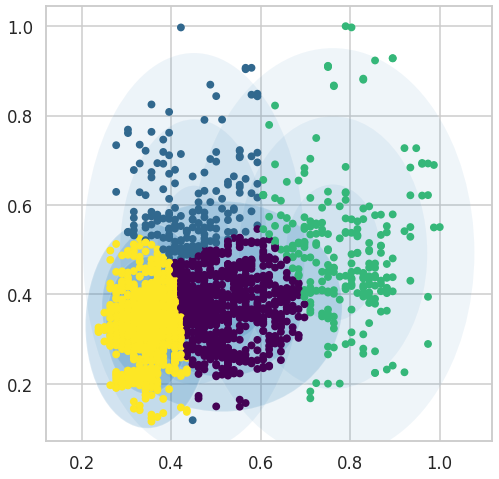

In [ ]:
gmm = mixture.GaussianMixture(n_components=4, random_state=42, covariance_type='diag').fit(X_data.copy())
plot_gmm(gmm, X_data)
probs = gmm.predict_proba(X_data)
print(probs[:5].round(3))

[[0.001 0.    0.999 0.   ]
 [0.    0.002 0.    0.998]
 [0.938 0.    0.058 0.004]
 [0.848 0.027 0.004 0.121]
 [0.722 0.    0.276 0.002]]


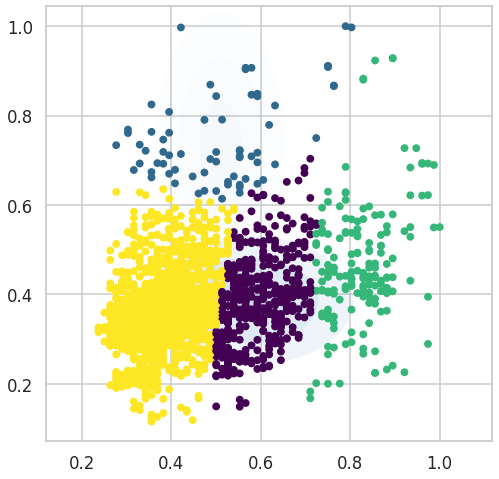

In [ ]:
gmm = mixture.GaussianMixture(n_components=4, random_state=42, covariance_type='tied').fit(X_data.copy())
plot_gmm(gmm, X_data)
probs = gmm.predict_proba(X_data)
print(probs[:5].round(3))

[[0.003 0.    0.997 0.   ]
 [0.025 0.35  0.    0.625]
 [0.811 0.017 0.172 0.   ]
 [0.423 0.379 0.198 0.   ]
 [0.376 0.014 0.61  0.   ]]


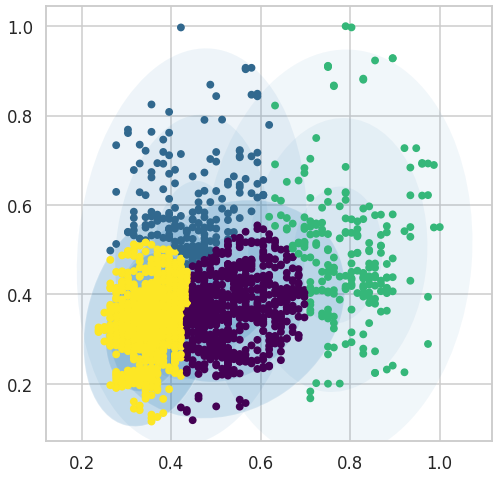

In [ ]:
gmm = mixture.GaussianMixture(n_components=4, random_state=42, covariance_type='full').fit(X_data.copy())
plot_gmm(gmm, X_data)
probs = gmm.predict_proba(X_data)
print(probs[:5].round(3))